<a href="https://colab.research.google.com/drive/1MusbEsD7-Dj6HNwT-ZdLq6h4JIl-QWST?usp=sharing" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **The Navier-Stokes equations**
**Johan Hoffman**

# **Abstract**

This short report show an example on how to use FEniCS to solve the Navier-Stokes equations, which is used in the course DD2365 Advanced Computation in Fluid Mechanics, at the KTH Royal Institute of Technology.

[DD2365 course website.](https://www.kth.se/social/course/DD2365/)

# **About the code**

In [ ]:
"""This program is an example file for the course"""
"""DD2365 Advanced Computation in Fluid Mechanics, """
"""KTH Royal Institute of Technology, Stockholm, Sweden."""

# Copyright (C) 2020 Johan Hoffman (jhoffman@kth.se)

# This file is part of the course DD2365 Advanced Computation in Fluid Mechanics
# KTH Royal Institute of Technology, Stockholm, Sweden
#
# This is free software: you can redistribute it and/or modify
# it under the terms of the GNU Lesser General Public License as published by
# the Free Software Foundation, either version 3 of the License, or
# (at your option) any later version.

# This template is maintained by Johan Hoffman
# Please report problems to jhoffman@kth.se

'KTH Royal Institute of Technology, Stockholm, Sweden.'

# **Set up environment**

In [ ]:
# Load neccessary modules.
from google.colab import files

import numpy as np
import time

# Install FEniCS (this may take a long time)
try:
    import dolfin
except ImportError:
    !wget "https://fem-on-colab.github.io/releases/fenics-install.sh" -O "/tmp/fenics-install.sh" && bash "/tmp/fenics-install.sh"
    import dolfin
    
from dolfin import *; from mshr import *

import dolfin.common.plotting as fenicsplot

from matplotlib import pyplot as plt

--2023-04-18 09:14:15--  https://fem-on-colab.github.io/releases/fenics-install.sh
Resolving fem-on-colab.github.io (fem-on-colab.github.io)... 185.199.108.153, 185.199.109.153, 185.199.110.153, ...
Connecting to fem-on-colab.github.io (fem-on-colab.github.io)|185.199.108.153|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4156 (4.1K) [application/x-sh]
Saving to: ‘/tmp/fenics-install.sh’

/tmp/fenics-install 100%[===================>]   4.06K  --.-KB/s    in 0s      

2023-04-18 09:14:15 (41.6 MB/s) - ‘/tmp/fenics-install.sh’ saved [4156/4156]

+ INSTALL_PREFIX=/usr/local
++ echo /usr/local
++ awk -F/ '{print NF-1}'
+ INSTALL_PREFIX_DEPTH=2
+ PROJECT_NAME=fem-on-colab
+ SHARE_PREFIX=/usr/local/share/fem-on-colab
+ FENICS_INSTALLED=/usr/local/share/fem-on-colab/fenics.installed
+ [[ ! -f /usr/local/share/fem-on-colab/fenics.installed ]]
+ PYBIND11_INSTALL_SCRIPT_PATH=https://github.com/fem-on-colab/fem-on-colab.github.io/raw/bef019f/releases/pybind11-install.s

# **Introduction**

The Navier-Stokes equations take the form

$\dot u + (u\cdot \nabla)u + \nabla p -\Delta u = f,\quad \nabla \cdot u=0,$

together with suitable initial and boundary conditions.

Here we present a FEniCS implementation of a stabilized space-time finite element method to solve the Navier-Stokes equations in 2D. The solution is visualized using FEniCS plotting functions, and is also exported as pvd-files which can be visualized in Paraview.

We seek a finite element approximation $(u,p)\in V\times Q$ such that 

$(\dot u + (u\cdot \nabla)u, v) - (p,\nabla \cdot v) + (\nu \nabla u,\nabla v) + (\nabla \cdot u, q) + SD(u,p;v,q) = (f,v),$

for all test functions $(v,q) \in \hat V\times \hat Q$, where $SD(u,p;v,q)$ is a residual based stabilization term.

We present an example of flow past a circular cylinder, for which we compute the force on the surface of the cylinder $\Gamma$ in the direction $\phi$, by Green's formula: 

$
F(u,p,\phi)= ~<\nu \nabla u\cdot n-pn, \Phi>_{\Gamma} ~=~(\dot u+(u\cdot \nabla)u, \Phi) + (\nu \nabla u,\nabla \Phi) - (p,\nabla \cdot\Phi)-(f,\Phi),
$

with $\Phi\in V$ a fuinction for which $\Phi\vert _{\Gamma}=\phi$ and $\Phi\vert_{\partial \Omega \setminus \Gamma}=0$. With $\phi=(1,0)$ we get the drag force $F_D$, and with $\phi=(0,1)$ the lift force $F_L$. The drag and lift coefficients are obtained by normalization, 

$
c_D = \frac{2F_D}{\rho U^2D}, \quad c_L = \frac{2F_L}{\rho U^2D}
$

where $\rho$ is the density (here $\rho=1$), $U$ the characteristic velocity (here $U=1$), and $D$ the characteristic length scale (here $D$ is the diameter of the cylinder). 

The Reynolds number is defined as $Re=\frac{UD}{\nu}$

To read more about how to use similar methods for more complex problems, see e.g. 

[Hoffman, Johan, et al. "Towards a parameter-free method for high reynolds number turbulent flow simulation based on adaptive finite element approximation." Computer Methods in Applied Mechanics and Engineering 288 (2015): 60-74.](https://www.sciencedirect.com/science/article/pii/S0045782514004836)


# **Method**

**Define domain and mesh**

In [ ]:
# Define rectangular domain 
L = 4
H = 2

# Define circle
xc = 1.0
yc = 0.5*H
rc = 0.2

# Define subdomains (for boundary conditions)
class Left(SubDomain):
    def inside(self, x, on_boundary):
        return near(x[0], 0.0) 

class Right(SubDomain):
    def inside(self, x, on_boundary):
        return near(x[0], L)

class Lower(SubDomain):
    def inside(self, x, on_boundary):
        return near(x[1], 0.0)

class Upper(SubDomain):
    def inside(self, x, on_boundary):
        return near(x[1], H)
      
left = Left()
right = Right()
lower = Lower()
upper = Upper()

**Define boundary conditions**

In [ ]:
# Define boundary conditions 
class DirichletBoundaryLower(SubDomain):
    def inside(self, x, on_boundary):
        return on_boundary and near(x[1], 0.0)

class DirichletBoundaryUpper(SubDomain):
    def inside(self, x, on_boundary):
        return on_boundary and near(x[1], H)

class DirichletBoundaryLeft(SubDomain):
    def inside(self, x, on_boundary):
        return on_boundary and near(x[0], 0.0) 

class DirichletBoundaryRight(SubDomain):
    def inside(self, x, on_boundary):
        return on_boundary and near(x[0], L)

class DirichletBoundaryObjects(SubDomain):
    def inside(self, x, on_boundary):
        return on_boundary and (not near(x[0], 0.0)) and (not near(x[0], L)) and (not near(x[1], 0.0)) and (not near(x[1], H))

dbc_lower = DirichletBoundaryLower()
dbc_upper = DirichletBoundaryUpper()
dbc_left = DirichletBoundaryLeft()
dbc_right = DirichletBoundaryRight()
dbc_objects = DirichletBoundaryObjects()

# **Results**

**Define flow parameters**

In [ ]:
# Set viscosity
nus = [4.0e-1, 4.0e-2, 4.0e-3, 4.0e-4]

In [ ]:
lift = {}
drag = {}
timepoints = {}

**Time stepping algorithm**

In [ ]:
from enum import Flag
!rm results-NS/*

def computeNS(nu, mesh_res, L=4, H=2, xc=1, yc=1, rc=0.2, inflow = 0, iter_mesh = False, T=30, frames = 10, no_levels = 0):
    U_bar = 1.0
    if inflow:
      U_bar = inflow*2/3
    Re = 2*rc*U_bar/nu
    mesh = generate_mesh(Rectangle(Point(0.0,0.0), Point(L,H)) - Circle(Point(xc,yc),rc), mesh_res)

    # Local mesh refinement (specified by a cell marker)
    for i in range(0,no_levels):
      cell_marker = MeshFunction("bool", mesh, mesh.topology().dim())
      for cell in cells(mesh):
        cell_marker[cell] = False
        p = cell.midpoint()
        if p.distance(Point(xc, yc)) < H/(2**(i+1)):
            cell_marker[cell] = True
      mesh = refine(mesh, cell_marker)
    # Define mesh functions (for boundary conditions)
    boundaries = MeshFunction("size_t", mesh, mesh.topology().dim()-1)
    boundaries.set_all(0)
    left.mark(boundaries, 1)
    right.mark(boundaries, 2)
    lower.mark(boundaries, 3)
    upper.mark(boundaries, 4)
    
    plt.figure()
    plot(mesh)
    plt.show()

    # Generate finite element spaces (for velocity and pressure)
    V = VectorFunctionSpace(mesh, "Lagrange", 1)
    Q = FunctionSpace(mesh, "Lagrange", 1)
    
    # Define trial and test functions 
    u = TrialFunction(V)
    p = TrialFunction(Q)
    v = TestFunction(V)
    q = TestFunction(Q)

    if inflow:
      u_m = inflow
      uin = Expression('4.0*u_m*x[1]*(H-x[1])/(H*H)', H=H, u_m=u_m, element = V.sub(0).ufl_element())
    else:
      uin = 1.0
    bcu_in0 = DirichletBC(V.sub(0), uin, dbc_left)
    bcu_in1 = DirichletBC(V.sub(1), 0.0, dbc_left)
    bcu_upp0 = DirichletBC(V.sub(0), 0.0, dbc_upper)
    bcu_upp1 = DirichletBC(V.sub(1), 0.0, dbc_upper)
    bcu_low0 = DirichletBC(V.sub(0), 0.0, dbc_lower)
    bcu_low1 = DirichletBC(V.sub(1), 0.0, dbc_lower)
    bcu_obj0 = DirichletBC(V.sub(0), 0.0, dbc_objects)
    bcu_obj1 = DirichletBC(V.sub(1), 0.0, dbc_objects)
    
    pin = Expression('5.0*fabs(sin(t))', element = Q.ufl_element(), t=0.0)
    pout = 0.0
    #bcp0 = DirichletBC(Q, pin, dbc_left) 
    bcp1 = DirichletBC(Q, pout, dbc_right)
    
    #bcu = [bcu_in0, bcu_in1, bcu_upp0, bcu_upp1, bcu_low0, bcu_low1, bcu_obj0, bcu_obj1]
    bcu = [bcu_in0, bcu_in1, bcu_upp1, bcu_low1, bcu_obj0, bcu_obj1]
    bcp = [bcp1]
    
    # Define measure for boundary integration  
    ds = Measure('ds', domain=mesh, subdomain_data=boundaries)

    # Define iteration functions
    # (u0,p0) solution from previous time step
    # (u1,p1) linearized solution at present time step  
    u0 = Function(V)
    u1 = Function(V)
    p0 = Function(Q)
    p1 = Function(Q)
    
    # Set parameters for nonlinear and lienar solvers 
    num_nnlin_iter = 5 
    prec = "amg" if has_krylov_solver_preconditioner("amg") else "default" 
    
    # Time step length 
    dt = 0.5*mesh.hmin()

    # Define variational problem

    # Stabilization parameters
    h = CellDiameter(mesh);
    u_mag = sqrt(dot(u1,u1))
    d1 = 1.0/sqrt((pow(1.0/dt,2.0) + pow(u_mag/h,2.0)))
    d2 = h*u_mag
    
    # Mean velocities for trapozoidal time stepping
    um = 0.5*(u + u0)
    um1 = 0.5*(u1 + u0)
    
    # Momentum variational equation on residual form
    Fu = inner((u - u0)/dt + grad(um)*um1, v)*dx - p1*div(v)*dx + nu*inner(grad(um), grad(v))*dx \
        + d1*inner((u - u0)/dt + grad(um)*um1 + grad(p1), grad(v)*um1)*dx + d2*div(um)*div(v)*dx 
    au = lhs(Fu)
    Lu = rhs(Fu)
    
    # Continuity variational equation on residual form
    Fp = d1*inner((u1 - u0)/dt + grad(um1)*um1 + grad(p), grad(q))*dx + div(um1)*q*dx 
    ap = lhs(Fp)
    Lp = rhs(Fp)

    # Define the direction of the force to be computed 
    lift_x = 0.0
    lift_y = 1.0
    
    drag_x = 1.0
    drag_y = 0.0
    
    #psi_expression = Expression(("0.0","pow(x[0]-0.5,2.0) + pow(x[1]-1.0,2.0) - pow(0.2,2.0) < 1.e-5 ? 1. : 0."), element = V.ufl_element())
    lift_expression = Expression(("near(pow(x[0]-xc,2.0) + pow(x[1]-yc,2.0) - pow(rc,2.0), 0.0) ? phi_x : 0.","near(pow(x[0]-xc,2.0) + pow(x[1]-yc,2.0) - pow(rc,2.0), 0.0) ? phi_y : 0."), xc=xc, yc=yc, rc=rc, phi_x=lift_x, phi_y=lift_y, element = V.ufl_element())
    psi_lift = interpolate(lift_expression, V)
    
    drag_expression = Expression(("near(pow(x[0]-xc,2.0) + pow(x[1]-yc,2.0) - pow(rc,2.0), 0.0) ? phi_x : 0.","near(pow(x[0]-xc,2.0) + pow(x[1]-yc,2.0) - pow(rc,2.0), 0.0) ? phi_y : 0."), xc=xc, yc=yc, rc=rc, phi_x=drag_x, phi_y=drag_y, element = V.ufl_element())
    psi_drag = interpolate(drag_expression, V)
    
    # Force normalization
    D = 2*rc
    normalization = -2.0/D

    
    Force_lift = inner((u1 - u0)/dt + grad(um1)*um1, psi_lift)*dx - p1*div(psi_lift)*dx + nu*inner(grad(um1), grad(psi_lift))*dx
    Force_drag = inner((u1 - u0)/dt + grad(um1)*um1, psi_drag)*dx - p1*div(psi_drag)*dx + nu*inner(grad(um1), grad(psi_drag))*dx

    # Open files to export solution to Paraview
    file_u = File(f"results-NS/u{Re}{mesh_res}.pvd")
    file_p = File(f"results-NS/p{Re}{mesh_res}.pvd")
    
    # Set plot frequency
    plot_time = 0
    plot_freq = frames
    
    # Force computation data 
    lift_array = np.array(0.0)
    lift_array = np.delete(lift_array, 0)

    drag_array = np.array(0.0)
    drag_array = np.delete(drag_array, 0)

    time = np.array(0.0)
    time = np.delete(time, 0)
    start_sample_time = 1.0

    # Time stepping 
    t = dt
    while t < T + DOLFIN_EPS:
    
        #s = 'Time t = ' + repr(t) 
        #print(s)
    
        pin.t = t
        #uin.t = t
    
        # Solve non-linear problem 
        k = 0
        while k < num_nnlin_iter: 
            
            # Assemble momentum matrix and vector 
            Au = assemble(au)
            bu = assemble(Lu)
    
            # Compute velocity solution 
            [bc.apply(Au, bu) for bc in bcu]
            [bc.apply(u1.vector()) for bc in bcu]
            solve(Au, u1.vector(), bu, "bicgstab", "default")
    
            # Assemble continuity matrix and vector
            Ap = assemble(ap) 
            bp = assemble(Lp)
    
            # Compute pressure solution 
            [bc.apply(Ap, bp) for bc in bcp]
            [bc.apply(p1.vector()) for bc in bcp]
            solve(Ap, p1.vector(), bp, "bicgstab", prec)
    
            # Compute force
            Fl = assemble(Force_lift)
            Fd = assemble(Force_drag)
            if (t > start_sample_time):
              lift_array = np.append(lift_array, normalization*Fl)
              drag_array = np.append(drag_array, normalization*Fd)
              time = np.append(time, t)
    
            k += 1
    
        if t > plot_time:     
            
            s = 'Time t = ' + repr(t) 
            print(s)
        
            # Save solution to file
            file_u << u1
            file_p << p1
    
            # Plot solution
            plt.figure()
            plot(u1, title=f"Velocity, mesh resolution: {mesh_res}, Reynolds number: {Re}")
    
            plt.figure()
            plot(p1, title=f"Pressure, mesh resolution: {mesh_res}, Reynolds number: {Re}")
    
            plot_time += T/plot_freq
            
            plt.show()

            plt.figure()
            plt.title(f"Lift Force, mesh resolution: {mesh_res}, Reynolds number: {Re}")
            plt.plot(time, lift_array)
            plt.show()
    
            plt.figure()
            plt.title(f"Drag Force, mesh resolution: {mesh_res}, Reynolds number: {Re}")
            plt.plot(time, drag_array)
            plt.show()
    
        # Update time step
        u0.assign(u1)
        t += dt
    if iter_mesh:
      lift[res] = lift_array
      drag[res] = drag_array
      timepoints[res] = time
    else:
      lift[nu] = lift_array
      drag[nu] = drag_array
      timepoints[nu] = time
    #!tar -czvf results-NS.tar.gz results-NS
    #files.download('results-NS.tar.gz')

rm: cannot remove 'results-NS/*': No such file or directory


In [ ]:
def find_ave(arr, tim, first):
  tims = tim[tim>first]
  arr_temp = arr[tim>first]
  return np.trapz( arr_temp, tims)/(tims[-1]-tims[0])

In [ ]:
def find_max(arr, times, start):
  arr_temp = arr[times > start]
  tims = times[times > start]
  return max(arr_temp)

In [ ]:
def is_max(arr, n, m):
  return np.all(arr[n] >= np.array(arr[n-m:n+m+1]))

In [ ]:
def get_freq(arr, times):
    m = 10
    tops = []
    for n in range(len(arr)-m-1, m, -1):
        if is_max(arr, n, m):
            tops.append(n)
        if len(tops) >= 2:
            break
    return 1/(times[tops[0]]-times[tops[1]])

In [ ]:
def get_strouhal(arr, times, D, U):
    freq = get_freq(arr, times)
    return freq*D/U

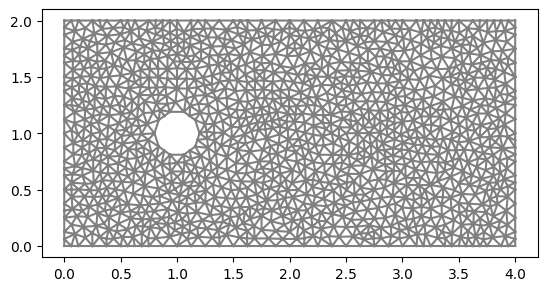

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling element ffc_element_4f750817ecc896f3bedcb4ff8c9f3352153b1b38

INFO:FFC:Compiler stage 1: Analyzing element(s)
INFO:FFC:--------------------------------------
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.000540733 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:-------------------------------------------------------
INFO:FFC:  Computing representation of 1 elements
DEBUG:FFC:  Reusing element from cache
DEBUG:FFC:  Reusing element from cache
DEBUG:FFC:  Reusing element from cache
INFO:FFC:  Computing representation of 1 dofmaps
DEBUG:FFC:  Reusing element from cache
INFO:FFC:  Computing representation of 0 coordinate mappings
INFO:FFC:  Computing representation of integrals
INFO:FFC:  Computing representation of forms
INFO:FFC:  
INFO:FFC:Compiler stage 2 finished in 0.490468 seconds.

INFO:FFC:Compiler stage 3: Optimizing intermediate representati

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling element ffc_element_3801828c0f66b7190a7fd5819465b3d5b34b9149

INFO:FFC:Compiler stage 1: Analyzing element(s)
INFO:FFC:--------------------------------------
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.00290537 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:-------------------------------------------------------
INFO:FFC:  Computing representation of 1 elements
DEBUG:FFC:  Reusing element from cache
DEBUG:FFC:  Reusing element from cache
DEBUG:FFC:  Reusing element from cache
INFO:FFC:  Computing representation of 1 dofmaps
DEBUG:FFC:  Reusing element from cache
INFO:FFC:  Computing representation of 0 coordinate mappings
INFO:FFC:  Computing representation of integrals
INFO:FFC:  Computing representation of forms
INFO:FFC:  
INFO:FFC:Compiler stage 2 finished in 0.0147111 seconds.

INFO:FFC:Compiler stage 3: Optimizing intermediate representati

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_4a563a6feb114fc03afaced905f5c2e5fea90d9b

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      2
  Arguments:                 '(v_0, v_1)'
  Number of coefficients:    2
  Coefficients:              '[f_45, f_48]'
  Unique elements:           'Vector<2 x CG1(?,?)>'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 10
INFO:FFC:  quadrature_degree: 10
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0951521 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:---------------------------

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling element ffc_element_d123cefaaa5b67d0e0b75375e2b0e3f4ea1f443f

INFO:FFC:Compiler stage 1: Analyzing element(s)
INFO:FFC:--------------------------------------
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.00598073 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:-------------------------------------------------------
INFO:FFC:  Computing representation of 1 elements
DEBUG:FFC:  Reusing element from cache
DEBUG:FFC:  Reusing element from cache
DEBUG:FFC:  Reusing element from cache
INFO:FFC:  Computing representation of 1 dofmaps
DEBUG:FFC:  Reusing element from cache
INFO:FFC:  Computing representation of 0 coordinate mappings
INFO:FFC:  Computing representation of integrals
INFO:FFC:  Computing representation of forms
INFO:FFC:  
INFO:FFC:Compiler stage 2 finished in 0.040514 seconds.

INFO:FFC:Compiler stage 3: Optimizing intermediate representatio

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling element ffc_element_949fd8d0ce307bb0cc6395b639b6fb3c4f39bfdb

INFO:FFC:Compiler stage 1: Analyzing element(s)
INFO:FFC:--------------------------------------
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.00714636 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:-------------------------------------------------------
INFO:FFC:  Computing representation of 1 elements
DEBUG:FFC:  Reusing element from cache
DEBUG:FFC:  Reusing element from cache
DEBUG:FFC:  Reusing element from cache
INFO:FFC:  Computing representation of 1 dofmaps
DEBUG:FFC:  Reusing element from cache
INFO:FFC:  Computing representation of 0 coordinate mappings
INFO:FFC:  Computing representation of integrals
INFO:FFC:  Computing representation of forms
INFO:FFC:  
INFO:FFC:Compiler stage 2 finished in 0.0369005 seconds.

INFO:FFC:Compiler stage 3: Optimizing intermediate representati

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling coordinate_mapping ffc_coordinate_mapping_57e62bc067fd4e90a89fa19b659b6c786f0f36f6

INFO:FFC:Compiler stage 1: Analyzing coordinate_mapping(s)
INFO:FFC:-------------------------------------------------
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.00905967 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:-------------------------------------------------------
INFO:FFC:  Computing representation of 0 elements
INFO:FFC:  Computing representation of 0 dofmaps
INFO:FFC:  Computing representation of 1 coordinate mappings
DEBUG:FFC:  Reusing element from cache
INFO:FFC:  Computing representation of integrals
INFO:FFC:  Computing representation of forms
INFO:FFC:  
INFO:FFC:Compiler stage 2 finished in 0.0163555 seconds.

INFO:FFC:Compiler stage 3: Optimizing intermediate representation
INFO:FFC:--------------------------------------------------------
INFO

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_b6f0e7c2a66938f579429e8378dea059126125dd

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      1
  Arguments:                 '(v_0)'
  Number of coefficients:    3
  Coefficients:              '[f_45, f_48, f_54]'
  Unique elements:           'Vector<2 x CG1(?,?)>, CG1(?,?)'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 10
INFO:FFC:  quadrature_degree: 10
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.122559 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:-----------------

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_1dcbf419df9388405029c71551e75cd3f5833735

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      2
  Arguments:                 '(v_0, v_1)'
  Number of coefficients:    1
  Coefficients:              '[f_48]'
  Unique elements:           'CG1(?,?), Vector<2 x CG1(?,?)>'
  Unique sub elements:       'CG1(?,?), Vector<2 x CG1(?,?)>'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 8
INFO:FFC:  quadrature_degree: 8
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0716972 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:-------------------------

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_1dd6a2a3bd8f4fe38fde29cf21a358a6ecb4415f

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      1
  Arguments:                 '(v_0)'
  Number of coefficients:    2
  Coefficients:              '[f_45, f_48]'
  Unique elements:           'CG1(?,?), Vector<2 x CG1(?,?)>'
  Unique sub elements:       'CG1(?,?), Vector<2 x CG1(?,?)>'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 9
INFO:FFC:  quadrature_degree: 9
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0530806 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:------------------------

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_96127437ea8977cd284822696d4073d48376d0f9

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      0
  Arguments:                 '()'
  Number of coefficients:    4
  Coefficients:              '[f_45, f_48, f_54, f_58]'
  Unique elements:           'Vector<2 x CG1(?,?)>, CG1(?,?)'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 2
INFO:FFC:  quadrature_degree: 2
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0472009 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:---------------

Time t = 0.03285506167650246


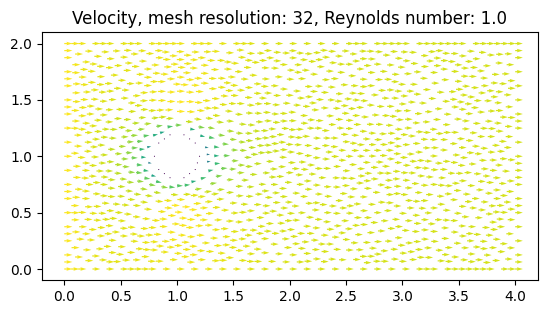

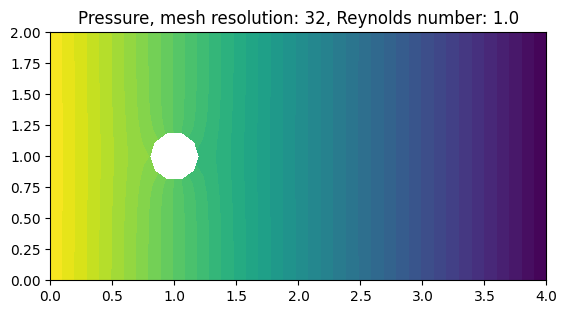

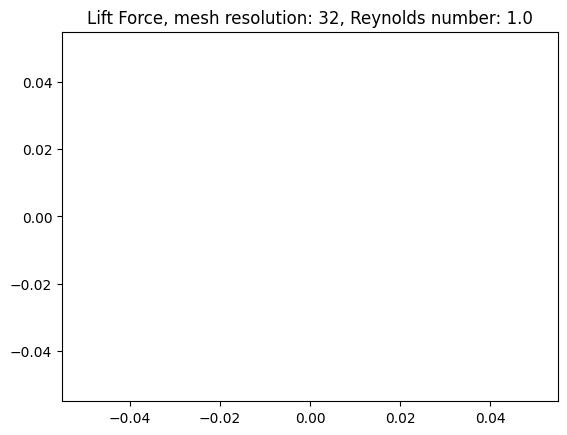

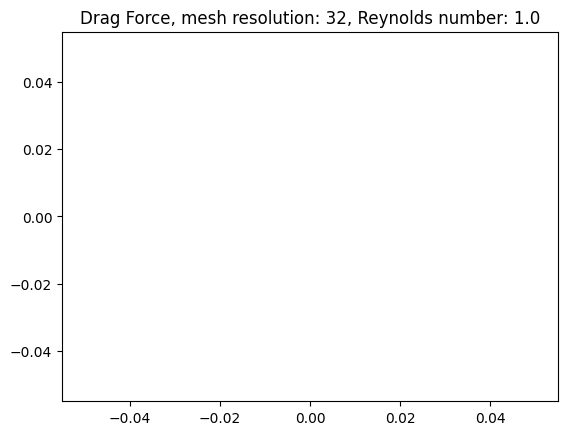

Time t = 3.022665674238231


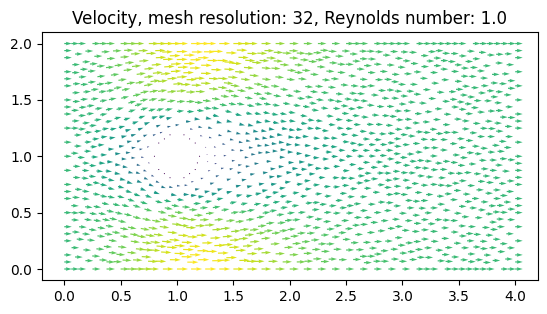

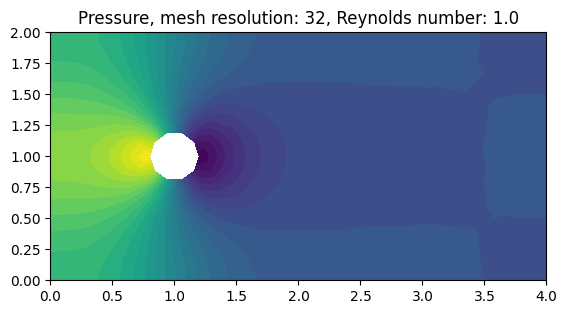

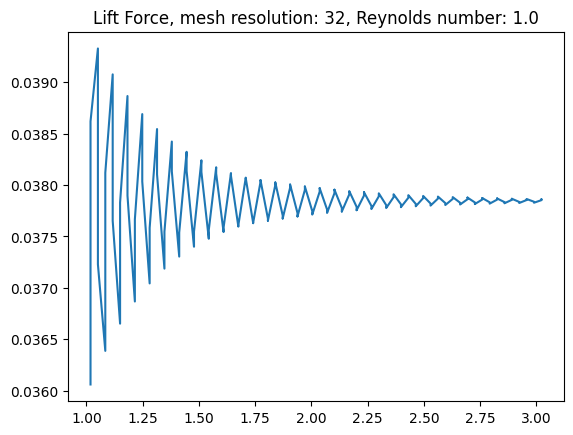

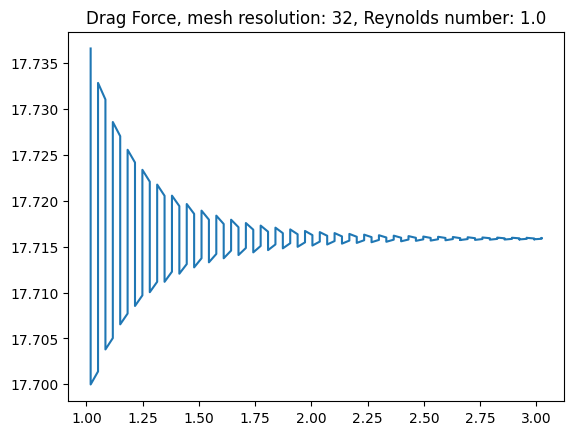

Time t = 6.012476286799972


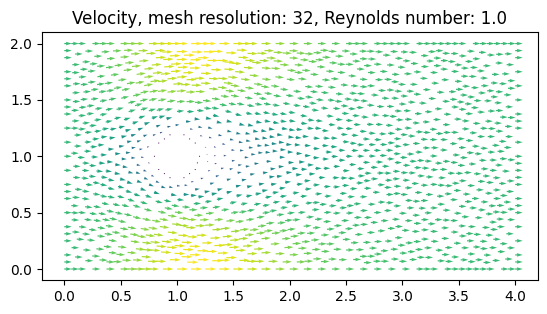

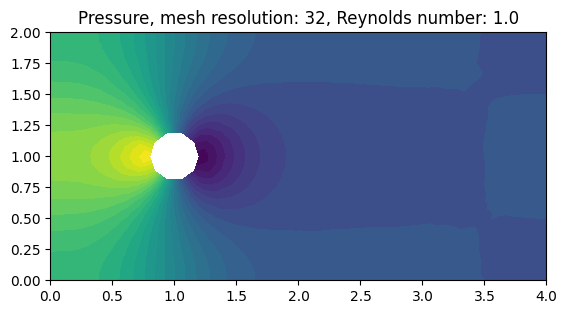

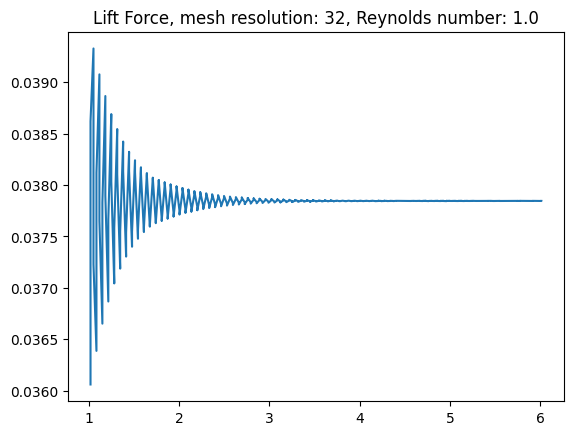

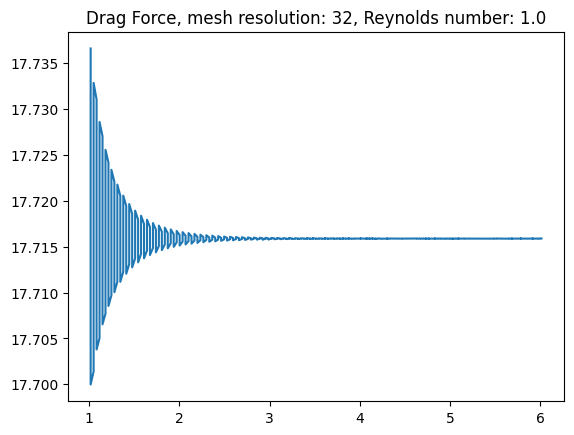

Time t = 9.002286899361685


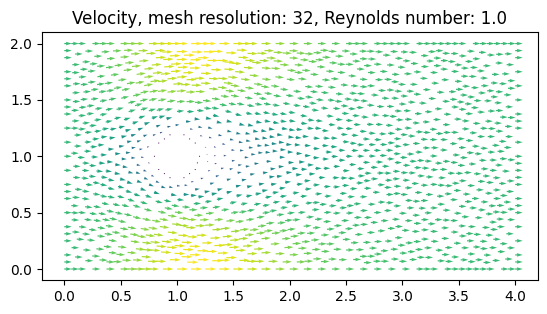

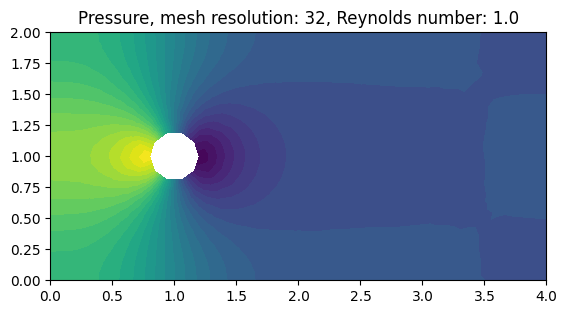

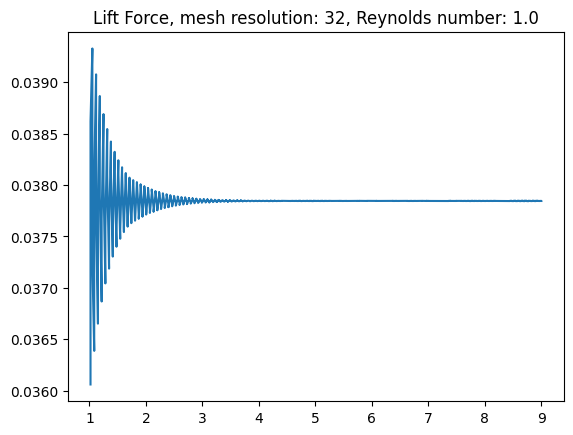

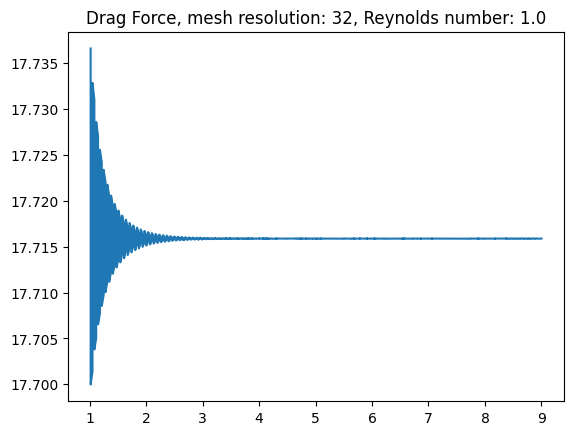

Time t = 12.024952573599847


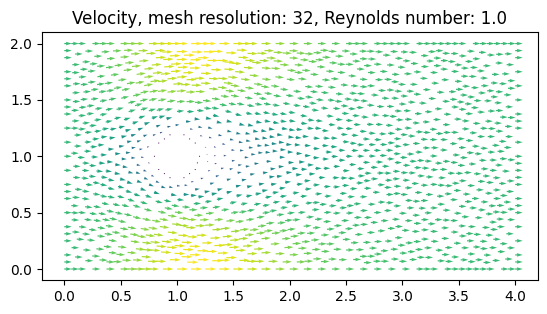

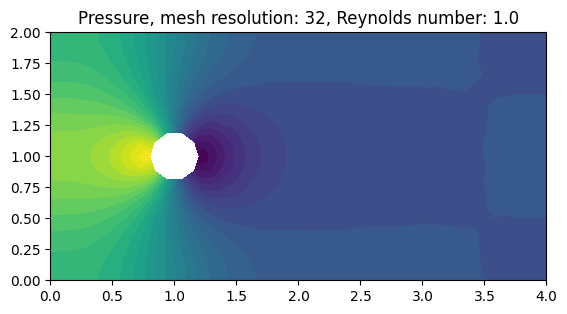

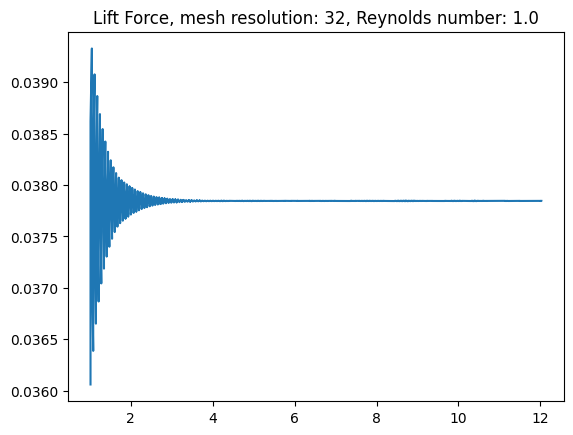

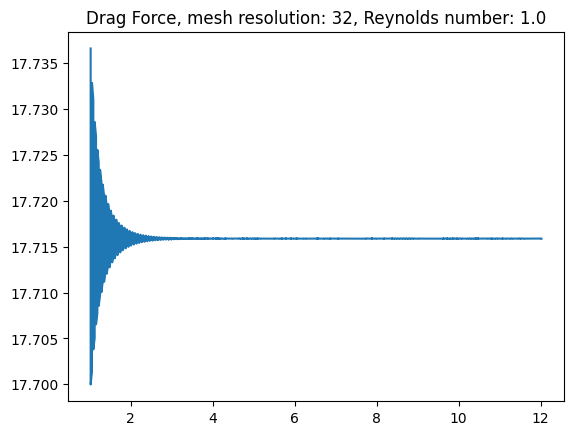

Time t = 15.014763186161508


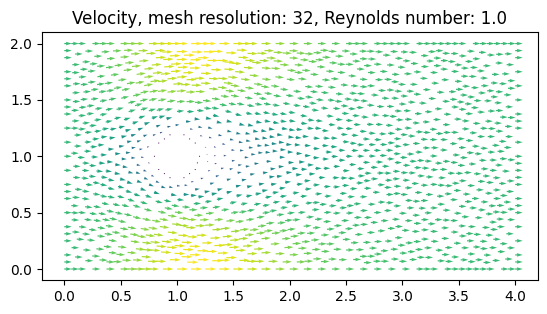

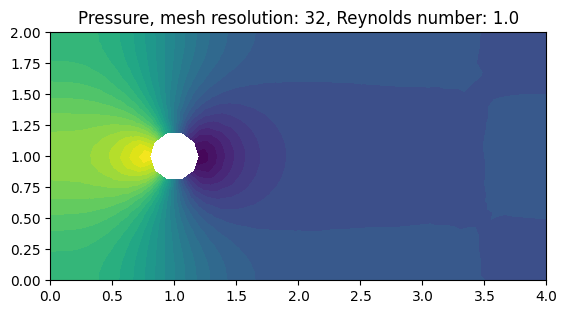

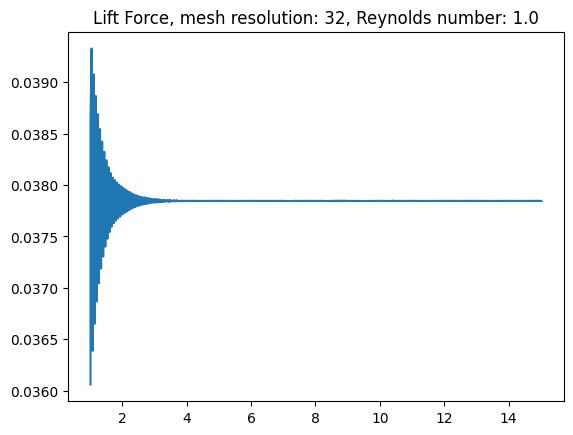

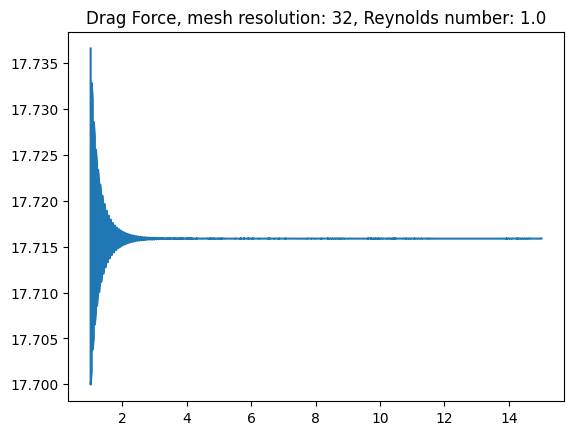

Time t = 18.00457379872328


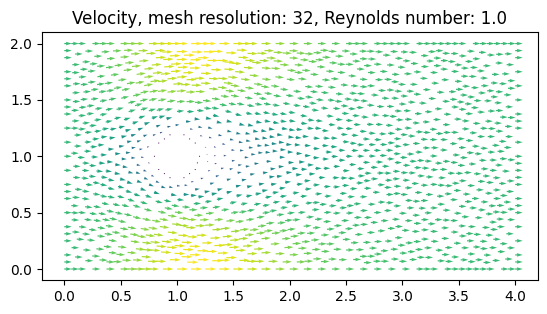

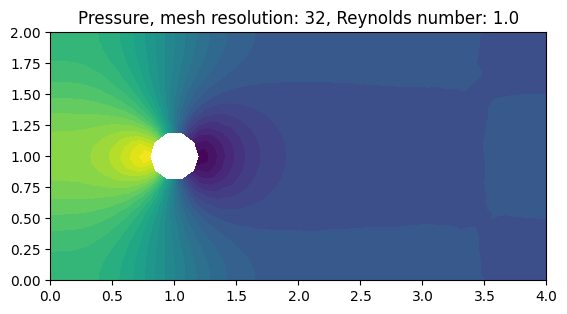

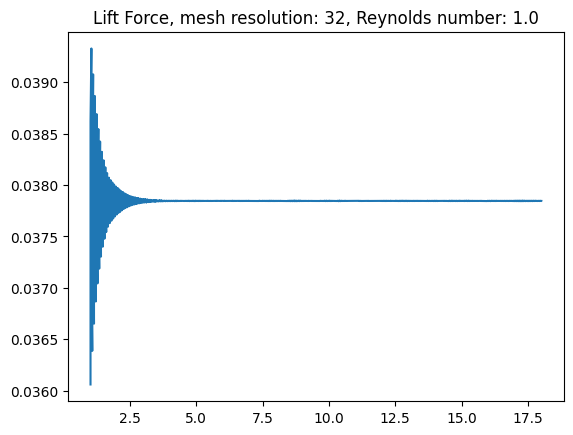

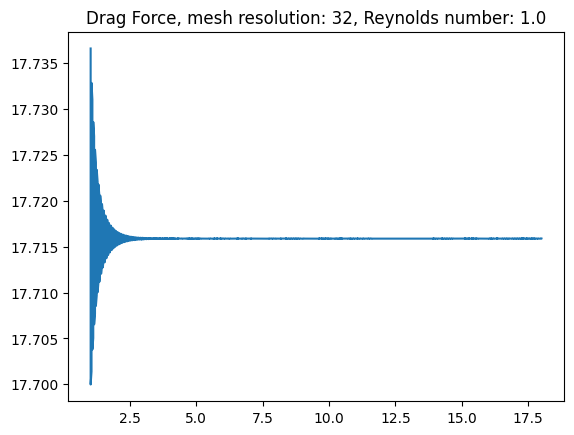

Time t = 21.027239472961604


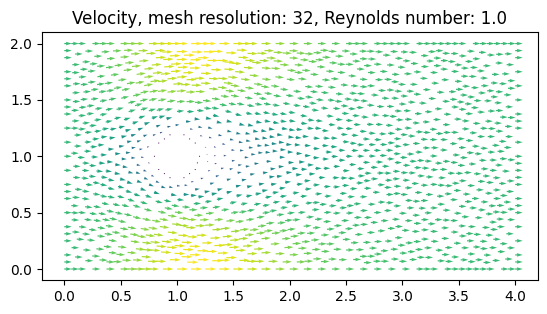

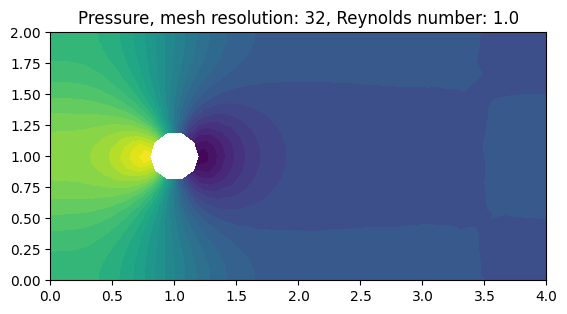

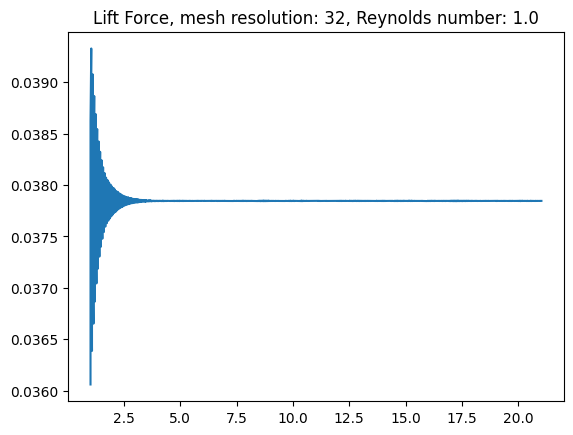

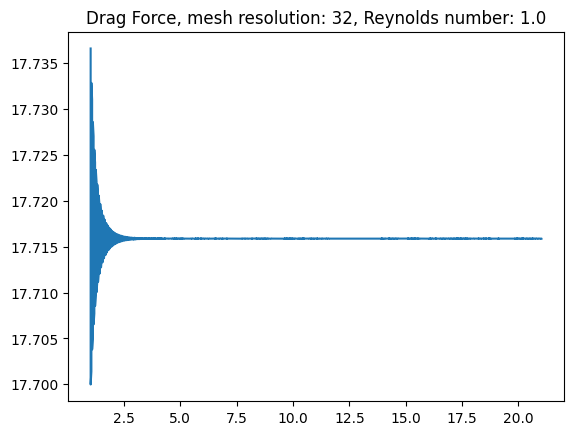

Time t = 24.017050085523426


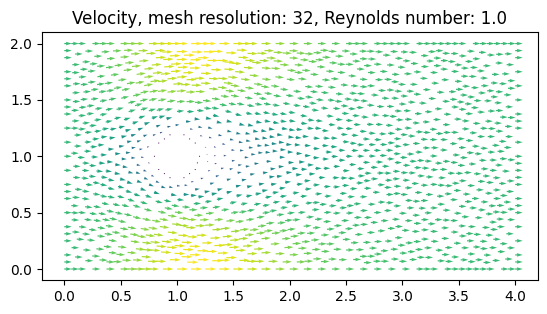

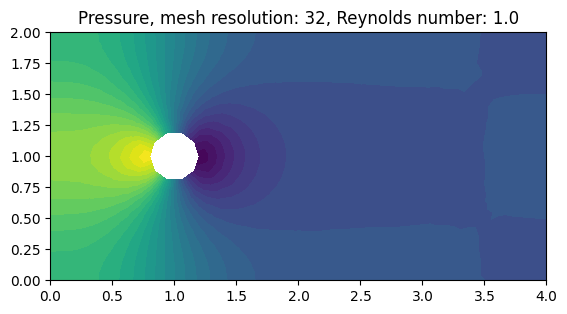

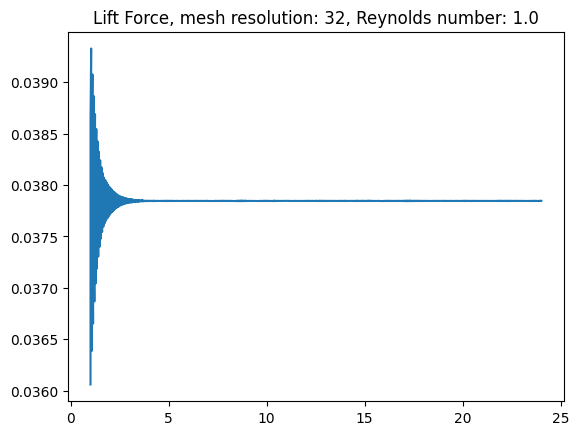

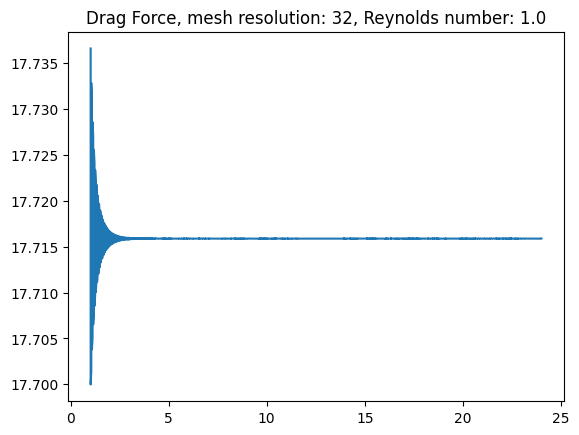

Time t = 27.006860698085248


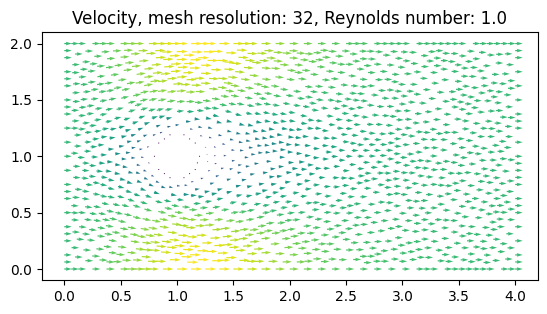

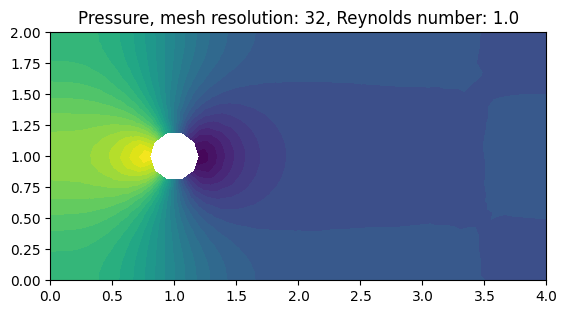

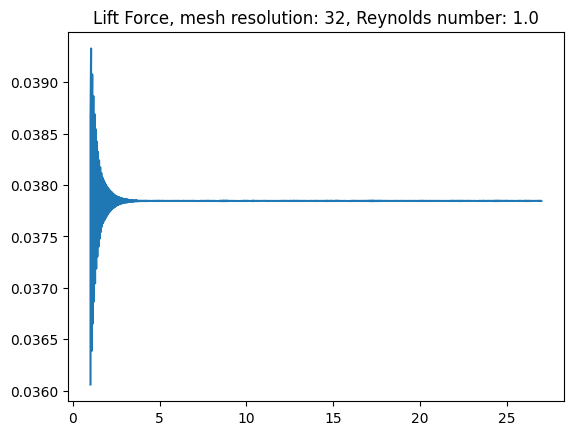

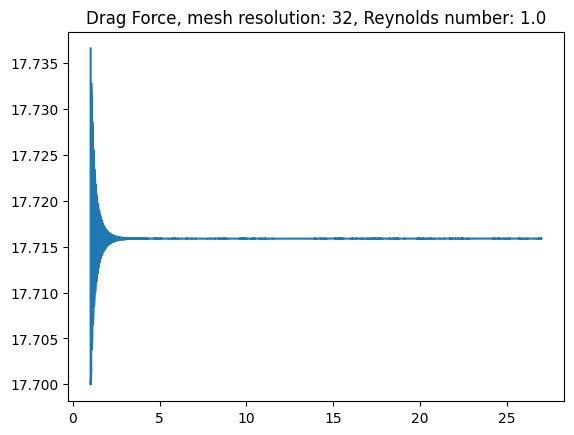

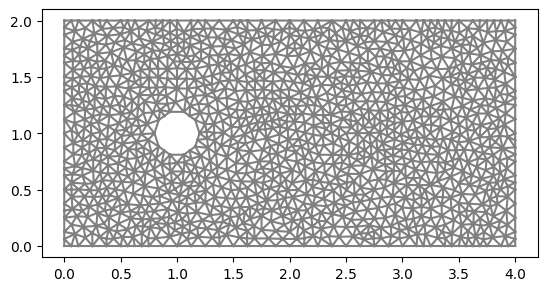

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_3b0665c011ee55ee8c3e02a6c203931fa58cd418

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      2
  Arguments:                 '(v_0, v_1)'
  Number of coefficients:    2
  Coefficients:              '[f_101460, f_101463]'
  Unique elements:           'Vector<2 x CG1(?,?)>'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 10
INFO:FFC:  quadrature_degree: 10
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.129708 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:--------------------

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_fe48e040d650a2e452a8647860a91e6e9f3d8fb1

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      1
  Arguments:                 '(v_0)'
  Number of coefficients:    3
  Coefficients:              '[f_101460, f_101463, f_101469]'
  Unique elements:           'Vector<2 x CG1(?,?)>, CG1(?,?)'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 10
INFO:FFC:  quadrature_degree: 10
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0642433 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:----

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_82a2b4420c016d59f046956865ac1ece5e2f27ae

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      0
  Arguments:                 '()'
  Number of coefficients:    4
  Coefficients:              '[f_101460, f_101463, f_101469, f_101473]'
  Unique elements:           'Vector<2 x CG1(?,?)>, CG1(?,?)'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 2
INFO:FFC:  quadrature_degree: 2
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0565481 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC

Time t = 0.03285506167650246


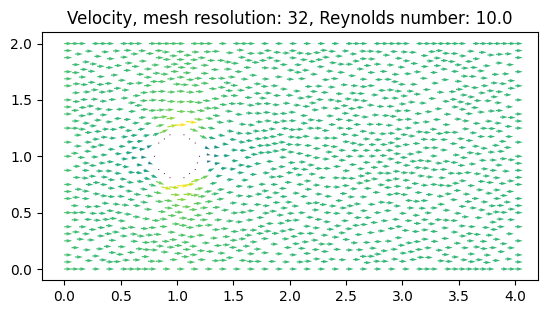

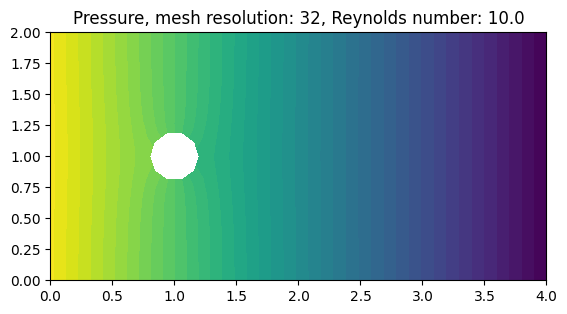

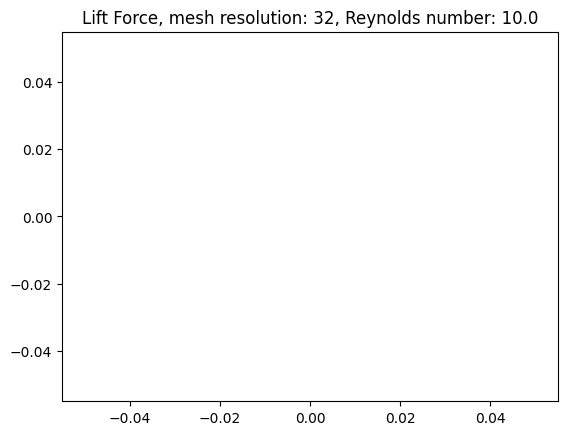

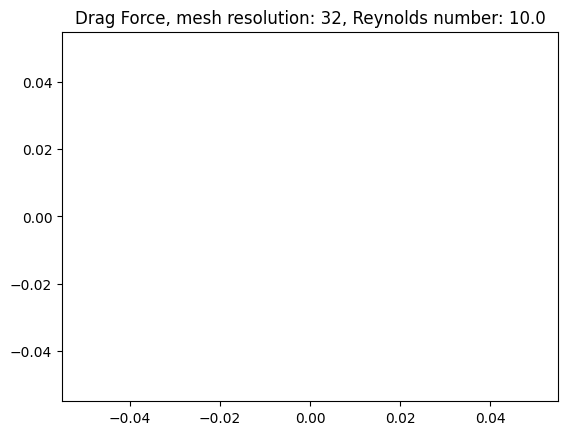

Time t = 3.022665674238231


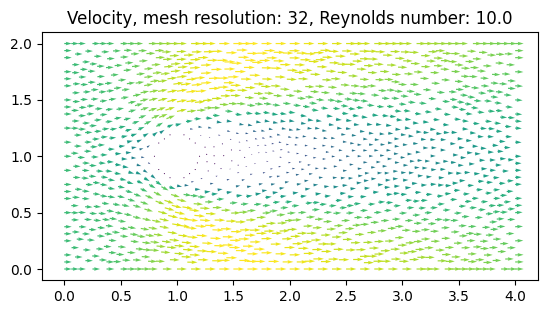

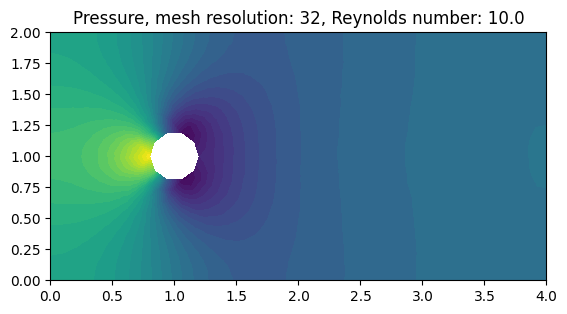

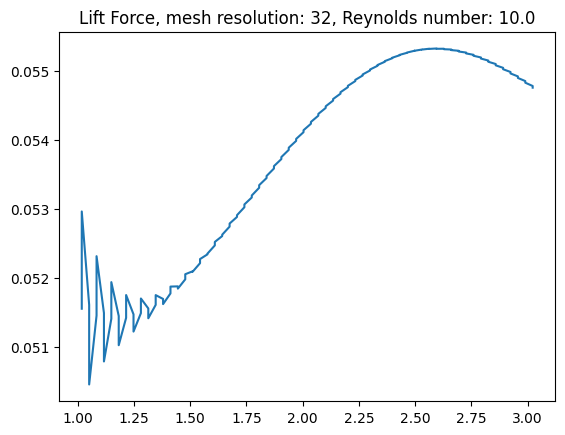

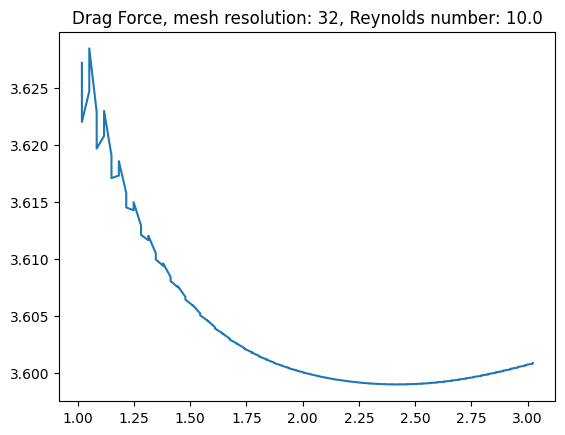

Time t = 6.012476286799972


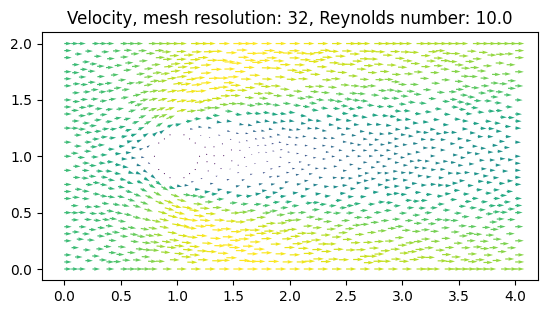

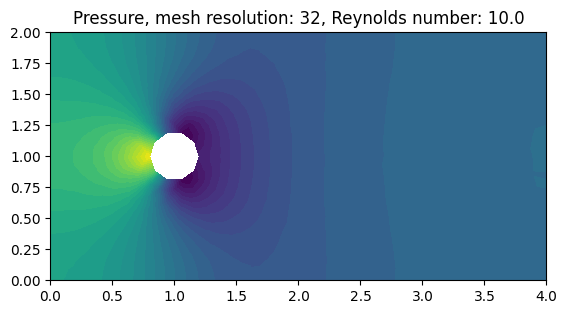

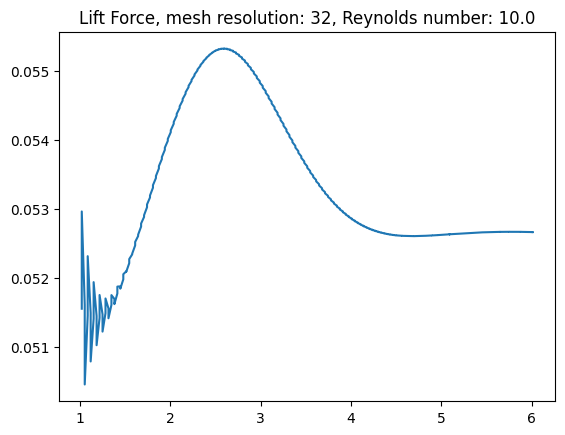

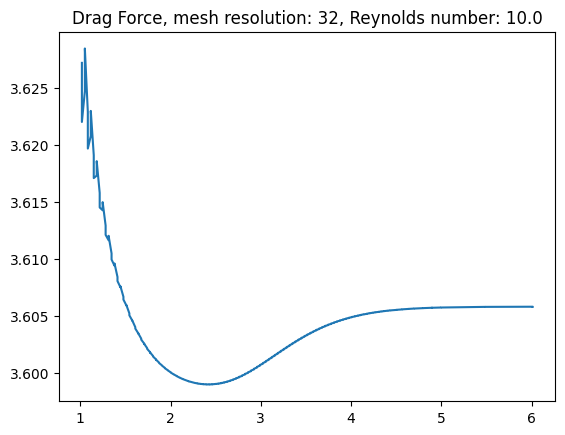

Time t = 9.002286899361685


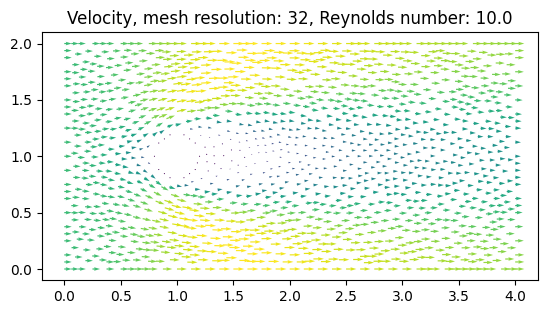

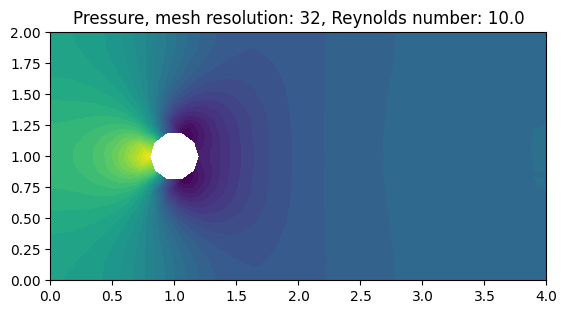

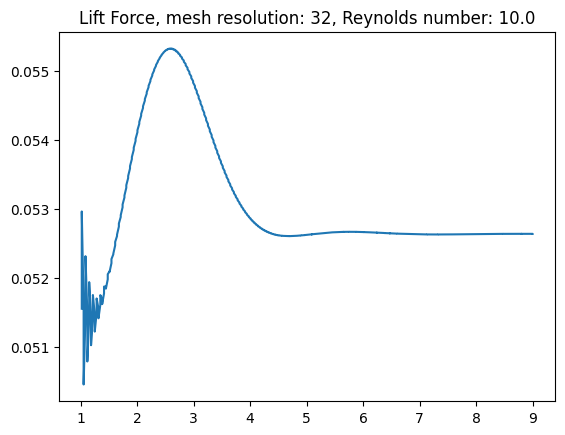

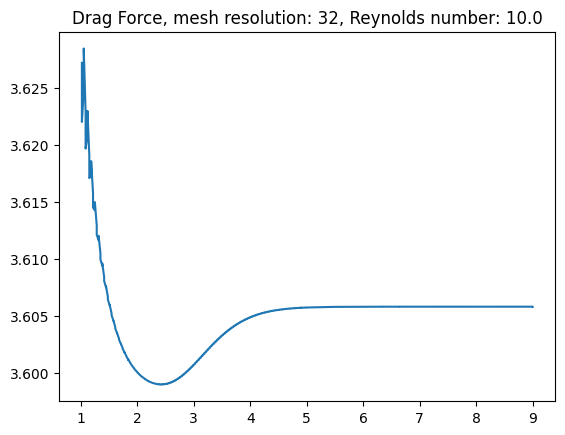

Time t = 12.024952573599847


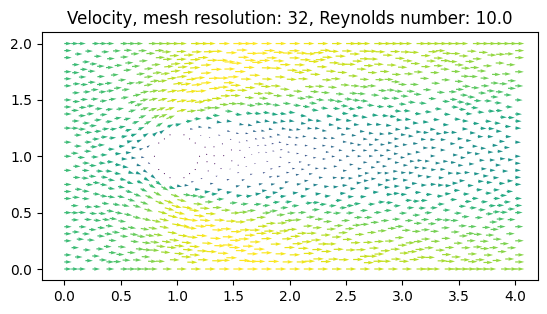

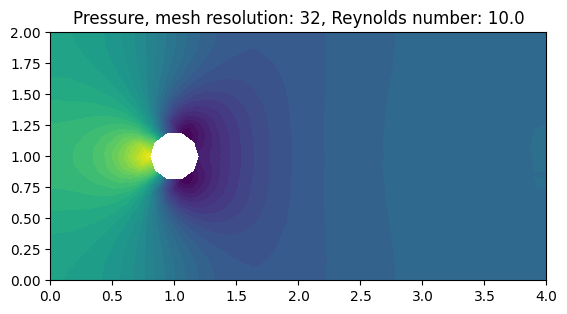

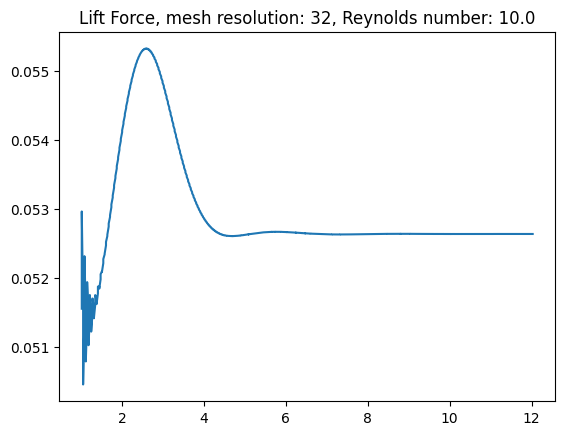

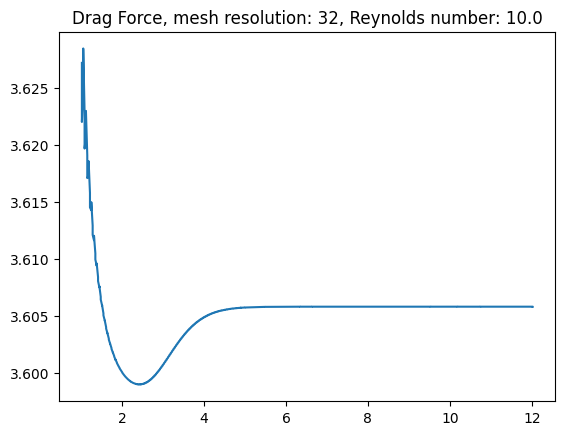

Time t = 15.014763186161508


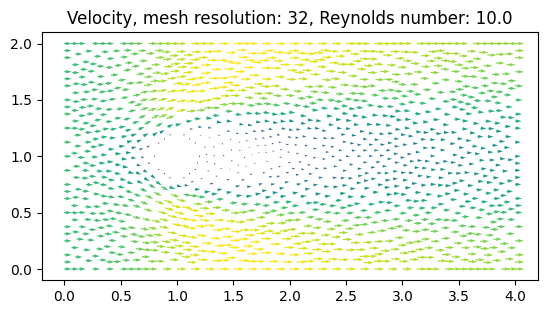

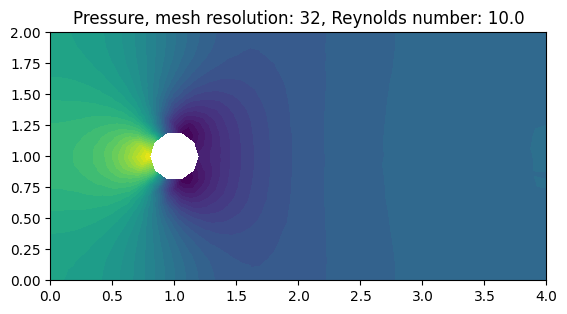

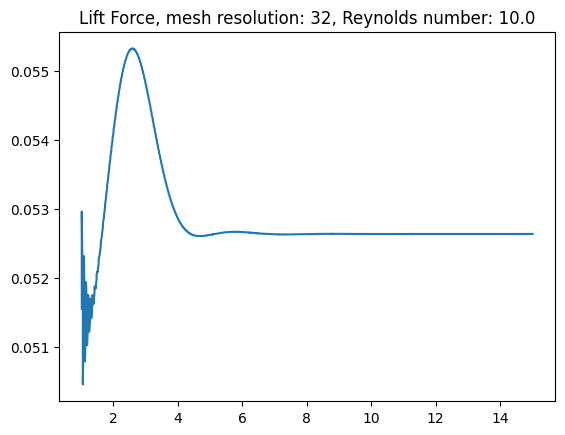

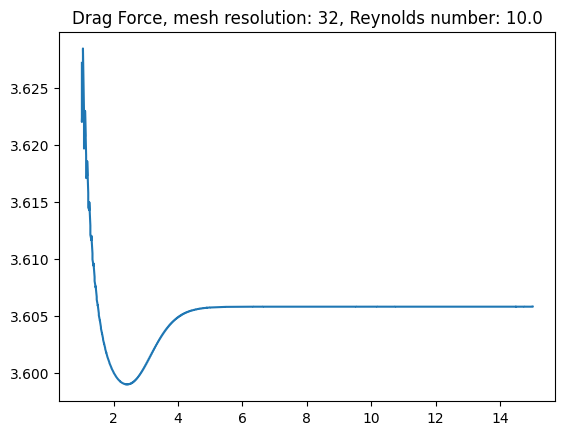

Time t = 18.00457379872328


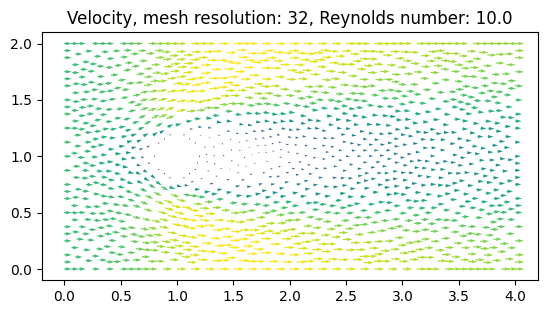

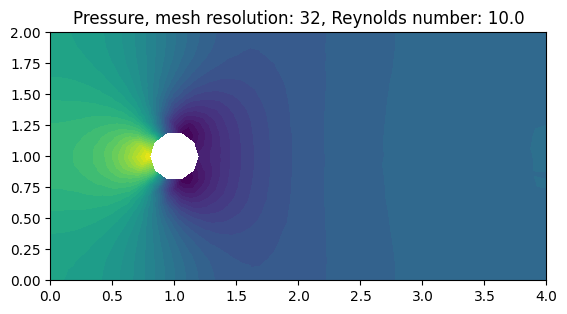

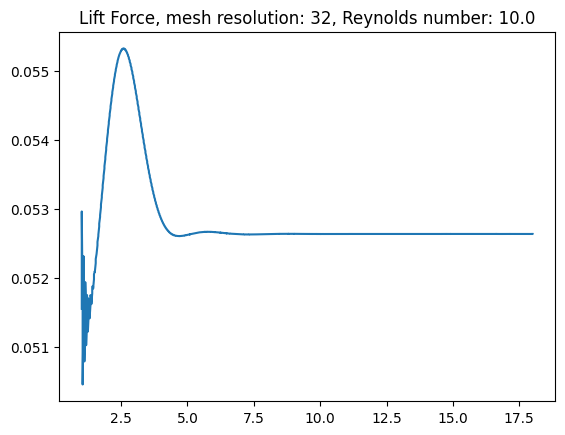

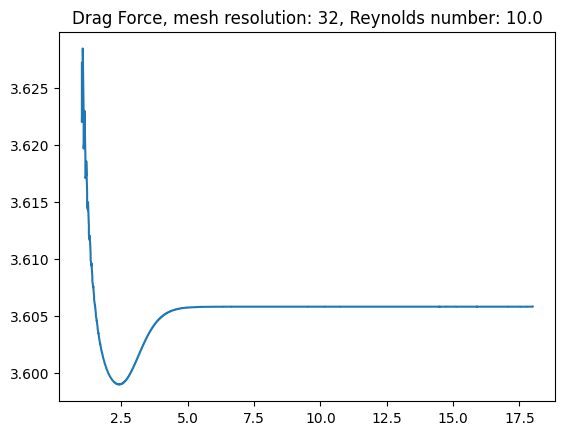

Time t = 21.027239472961604


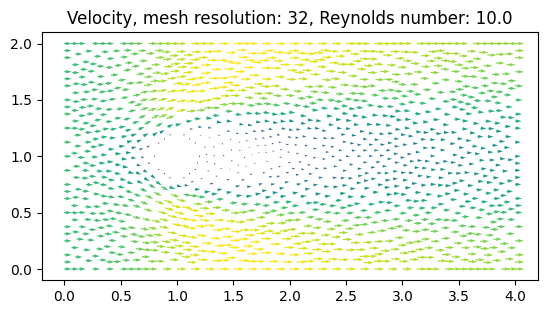

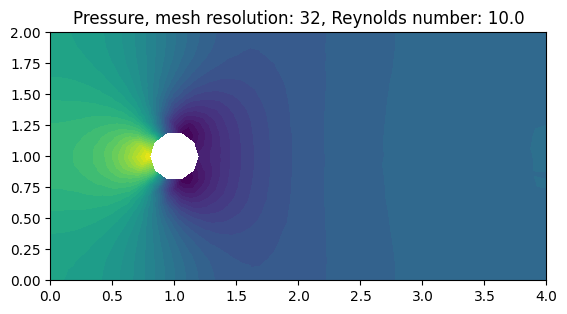

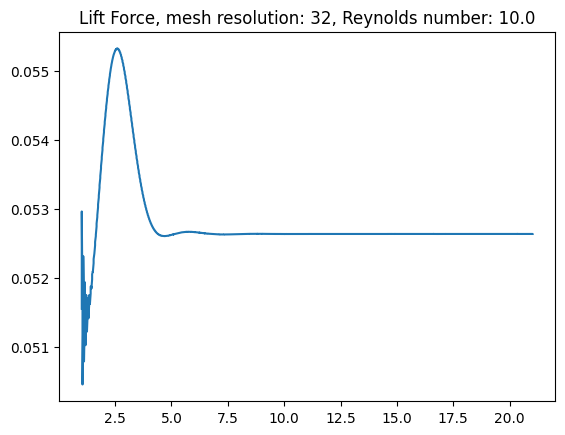

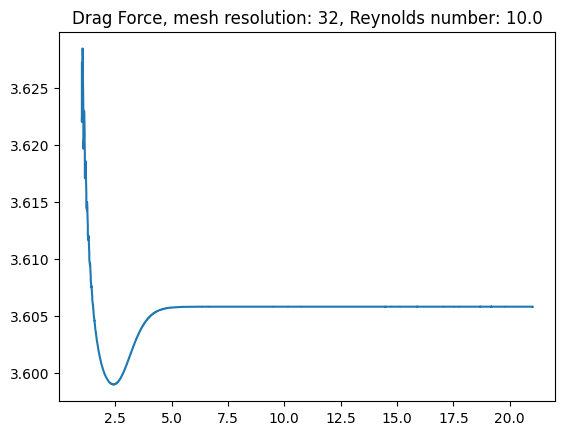

Time t = 24.017050085523426


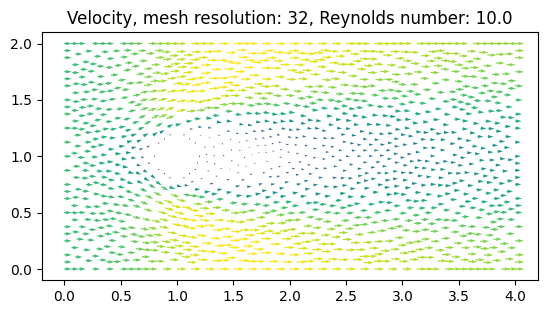

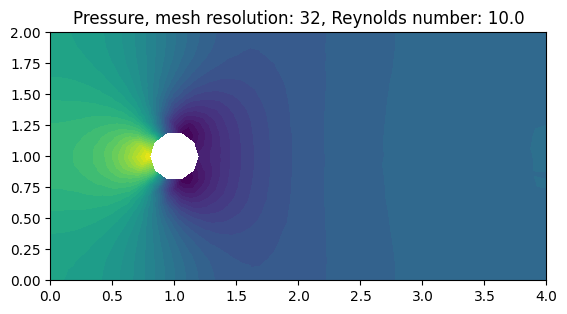

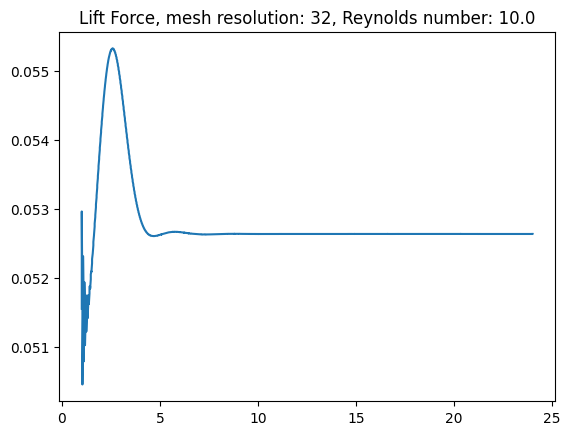

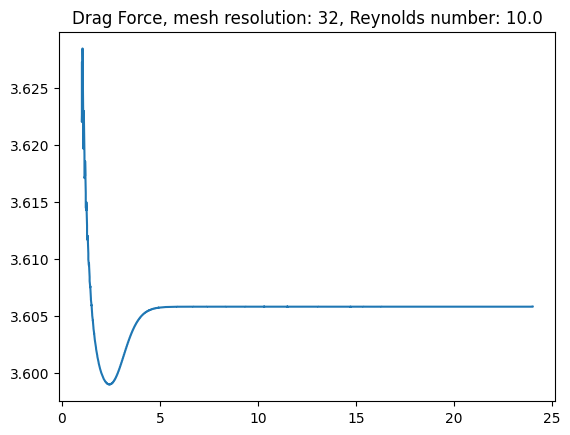

Time t = 27.006860698085248


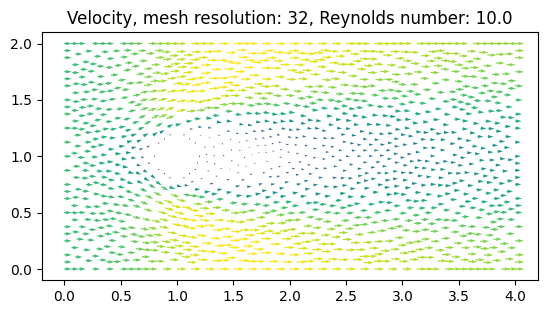

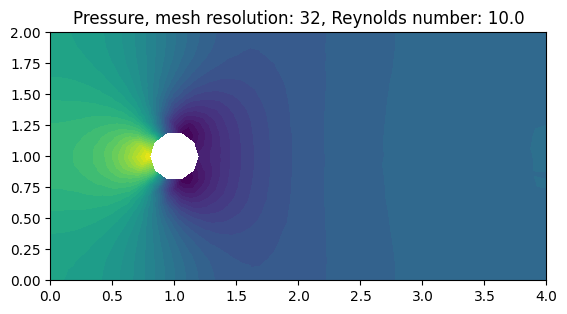

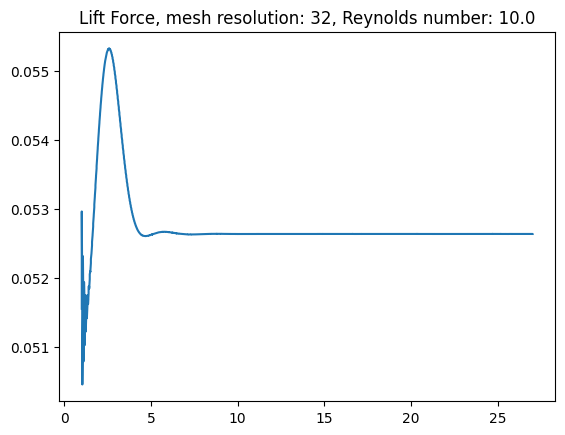

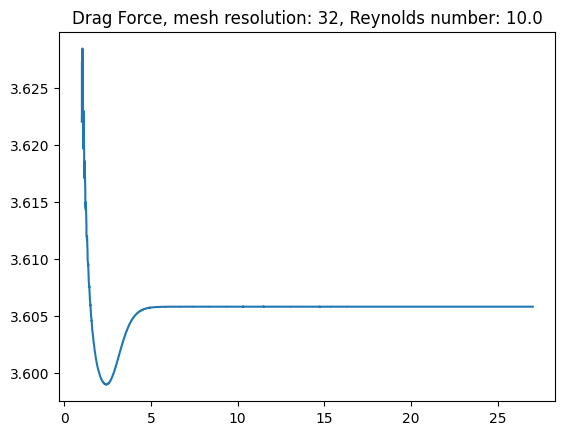

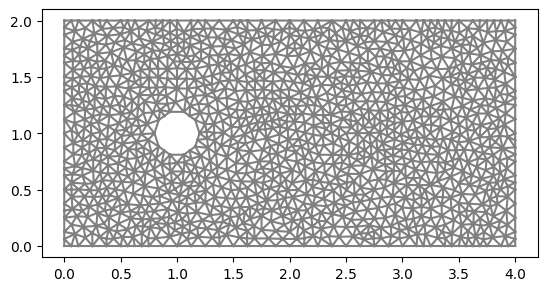

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_c43873c69edd1a2f47bddf11a1956f9bfe318e74

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      2
  Arguments:                 '(v_0, v_1)'
  Number of coefficients:    2
  Coefficients:              '[f_202875, f_202878]'
  Unique elements:           'Vector<2 x CG1(?,?)>'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 10
INFO:FFC:  quadrature_degree: 10
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0638444 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:-------------------

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_506795da2891bbea8e2e58c5b6695e04d733b570

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      1
  Arguments:                 '(v_0)'
  Number of coefficients:    3
  Coefficients:              '[f_202875, f_202878, f_202884]'
  Unique elements:           'Vector<2 x CG1(?,?)>, CG1(?,?)'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 10
INFO:FFC:  quadrature_degree: 10
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0742874 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:----

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_cfb1c9a135e4ce06a8ccb2748cc96b1a1f903508

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      0
  Arguments:                 '()'
  Number of coefficients:    4
  Coefficients:              '[f_202875, f_202878, f_202884, f_202888]'
  Unique elements:           'Vector<2 x CG1(?,?)>, CG1(?,?)'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 2
INFO:FFC:  quadrature_degree: 2
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.106016 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:

Time t = 0.03285506167650246


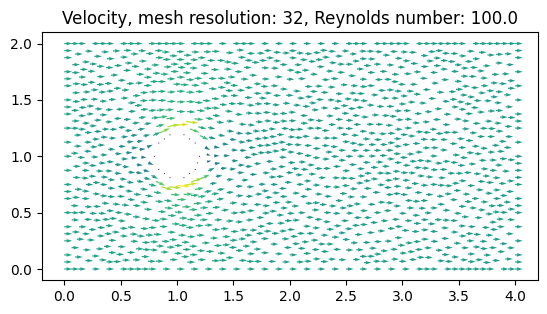

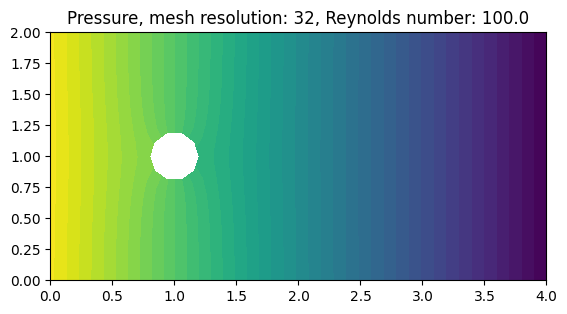

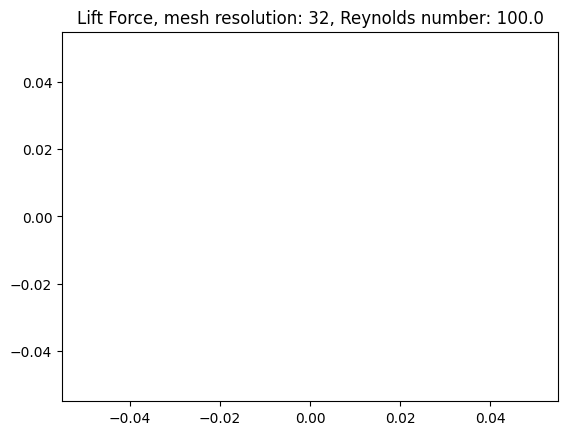

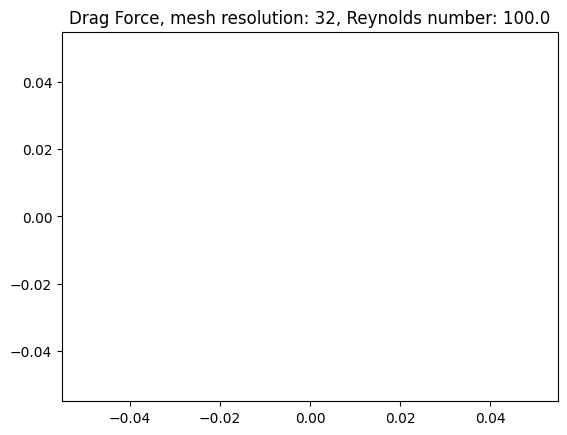

Time t = 3.022665674238231


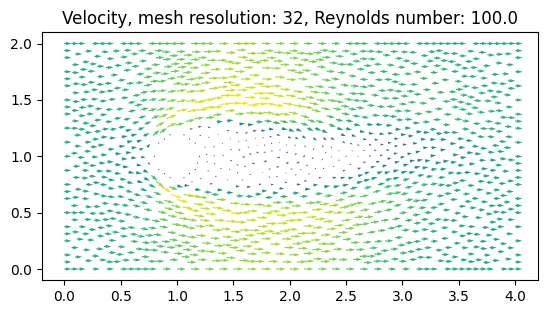

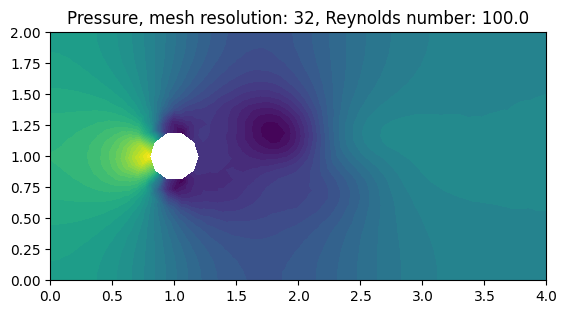

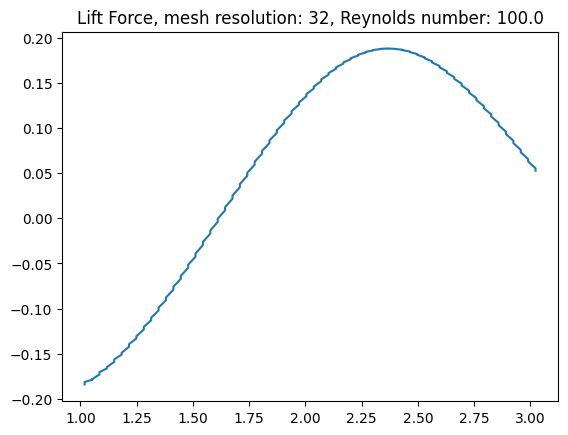

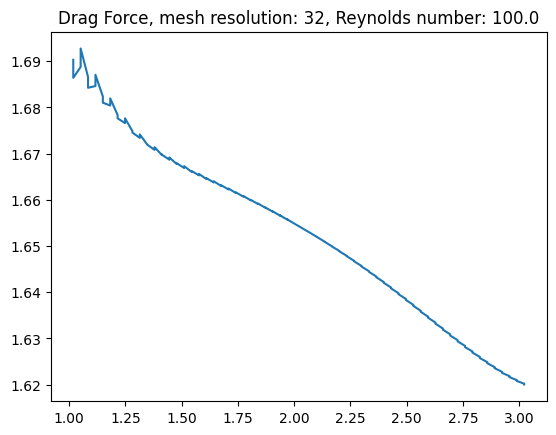

Time t = 6.012476286799972


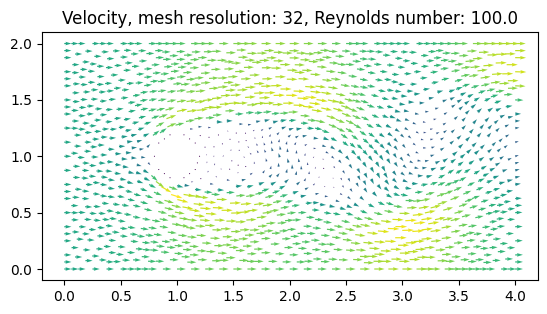

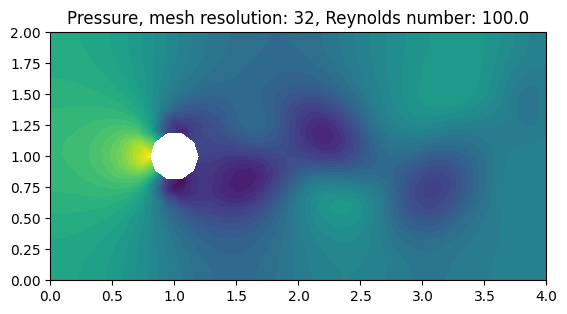

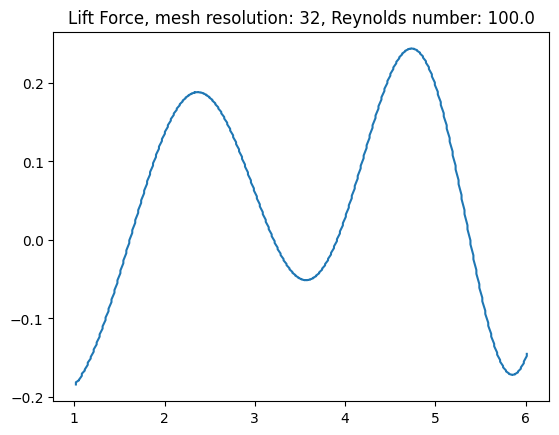

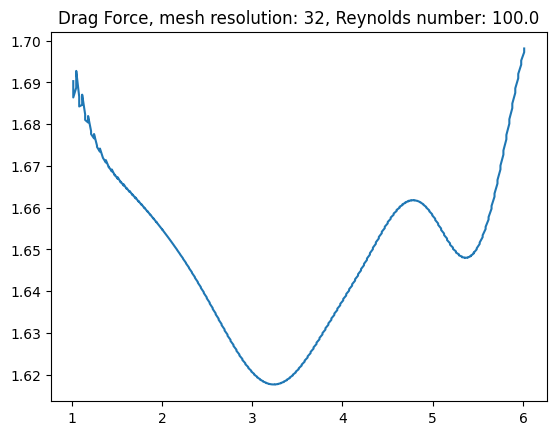

Time t = 9.002286899361685


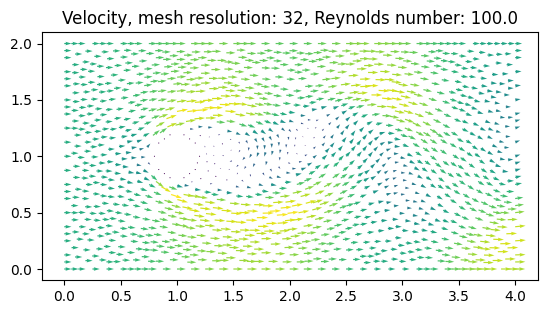

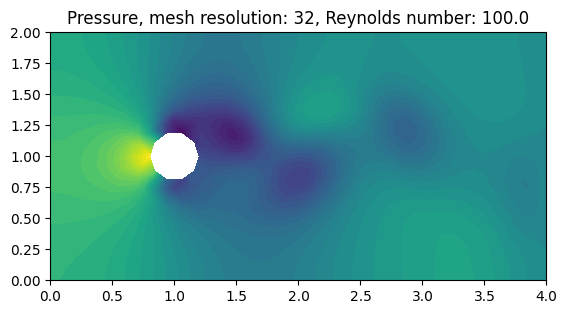

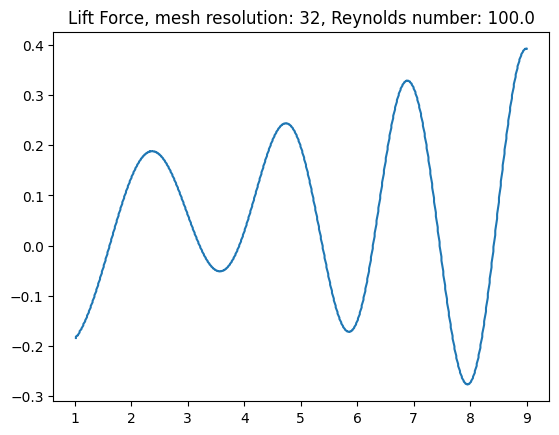

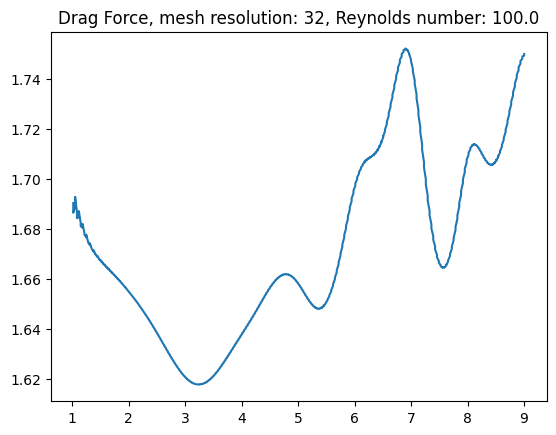

Time t = 12.024952573599847


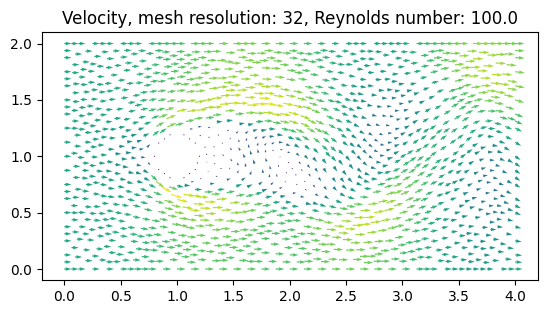

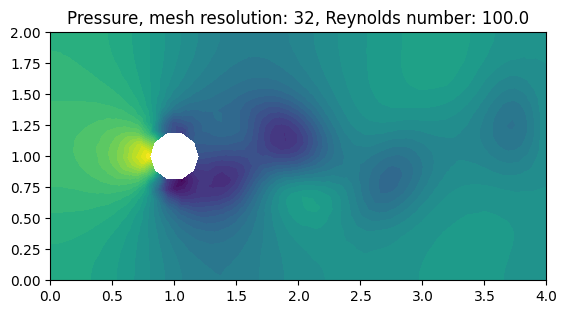

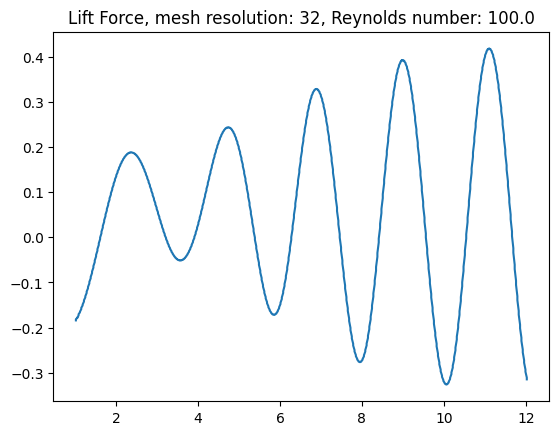

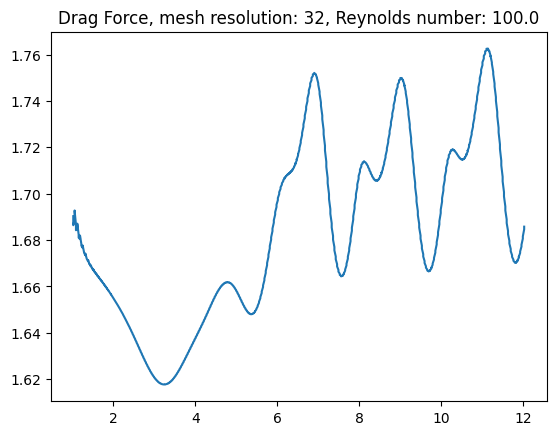

Time t = 15.014763186161508


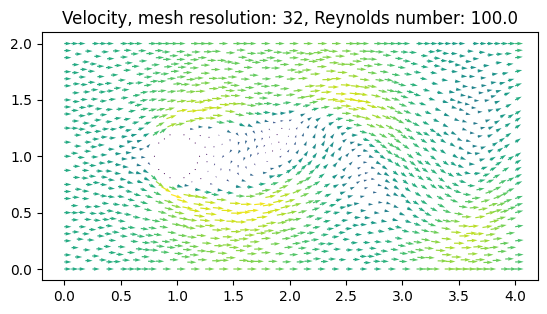

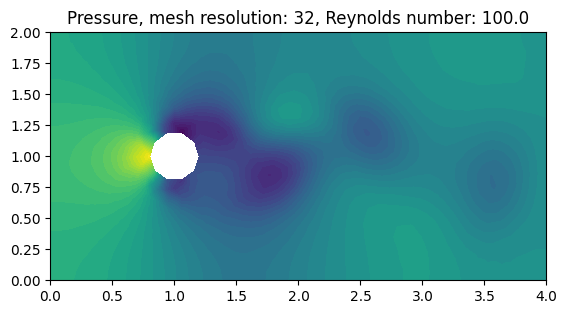

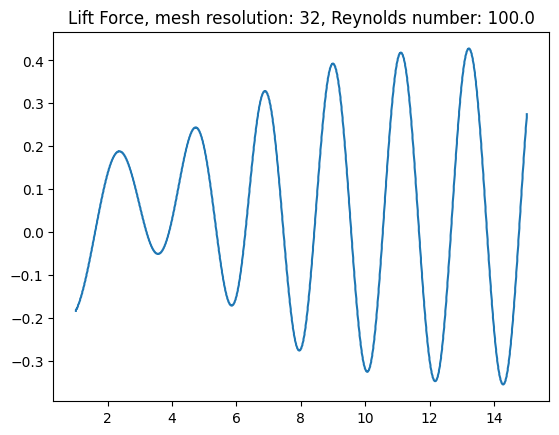

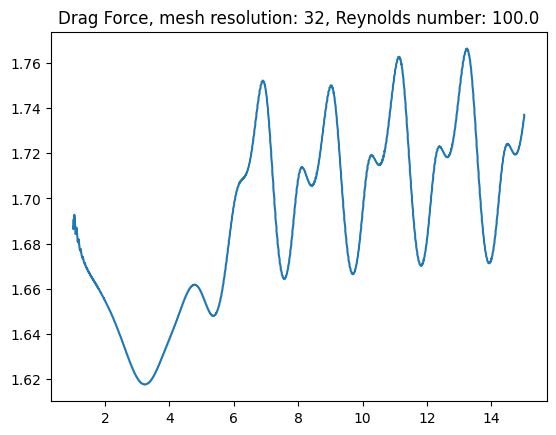

Time t = 18.00457379872328


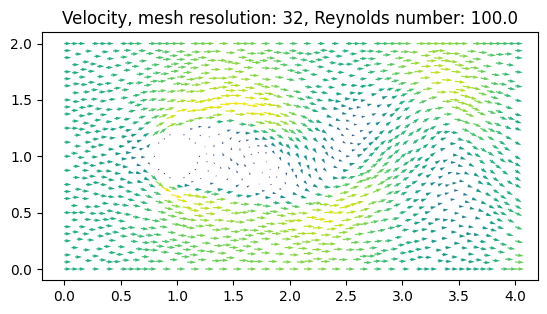

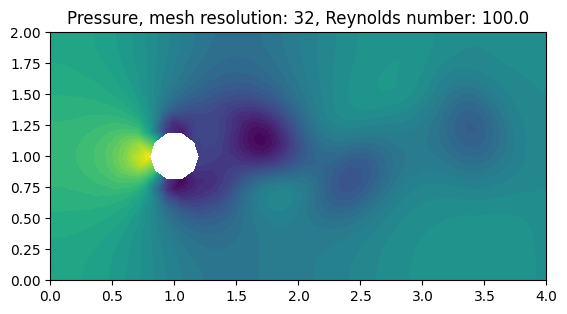

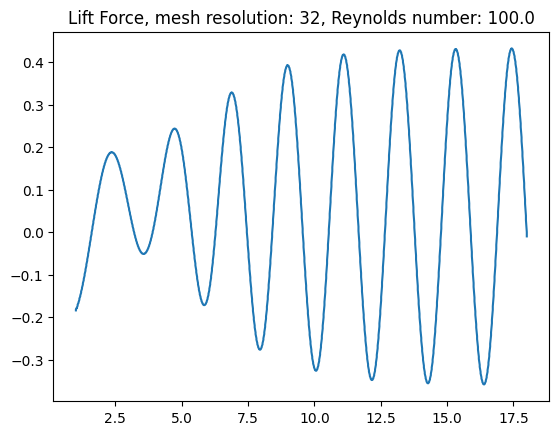

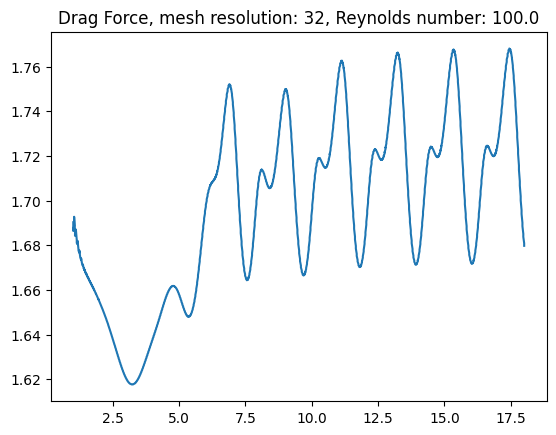

Time t = 21.027239472961604


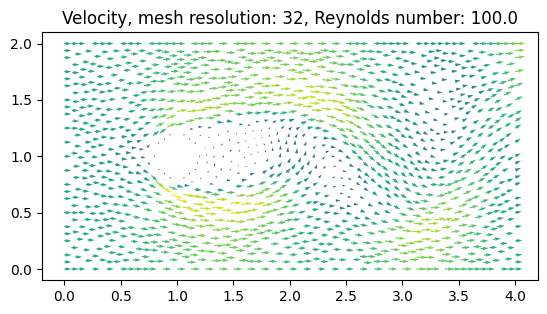

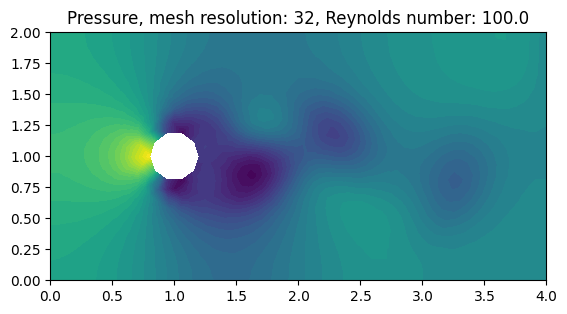

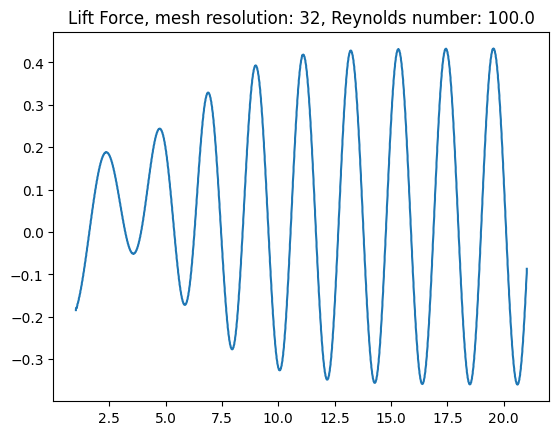

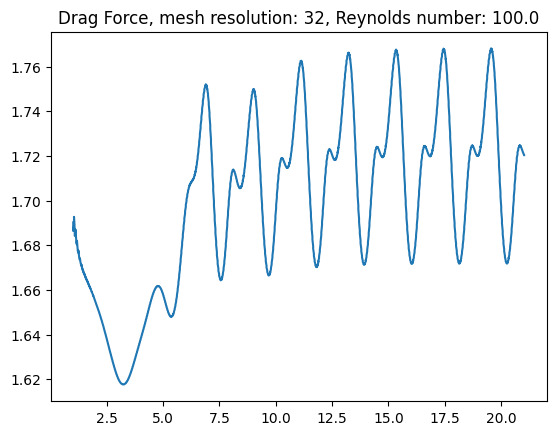

Time t = 24.017050085523426


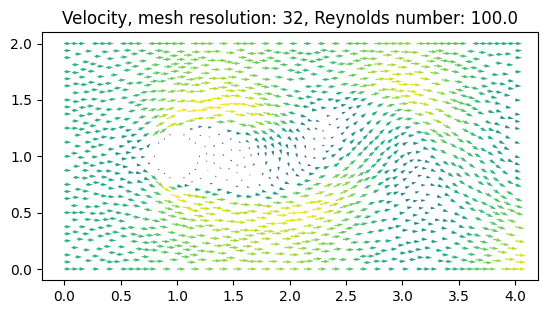

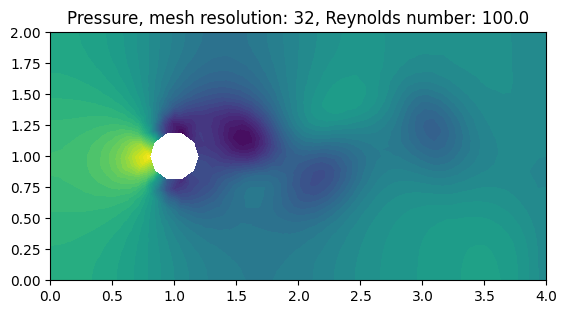

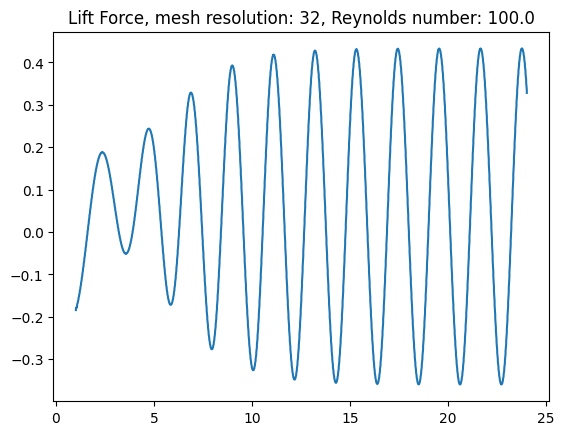

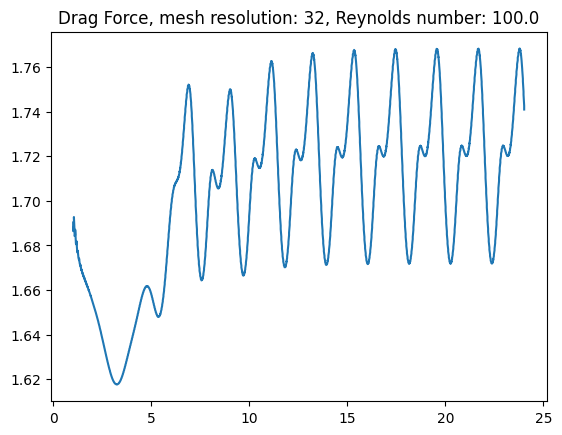

Time t = 27.006860698085248


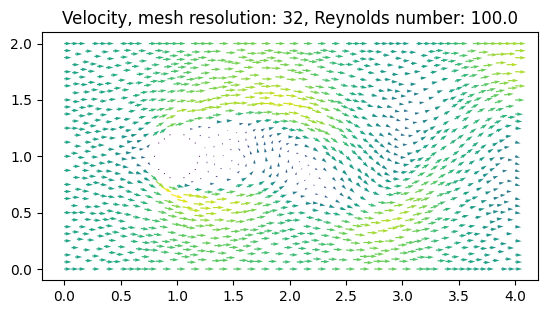

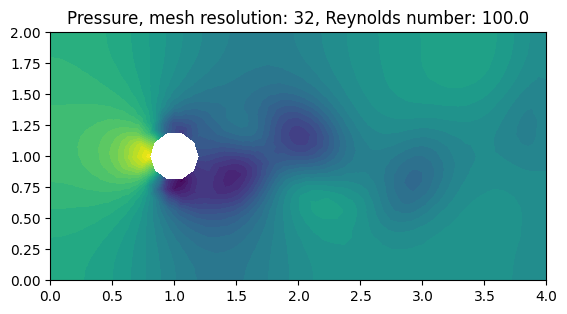

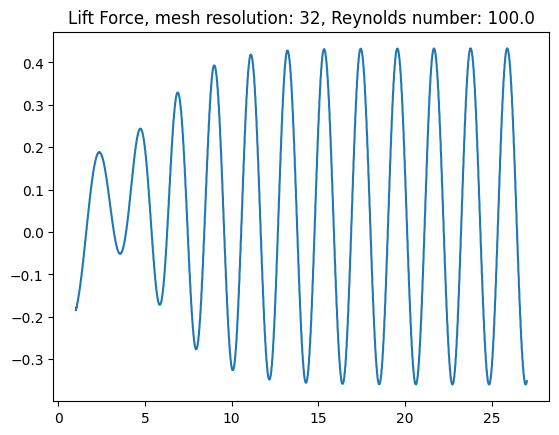

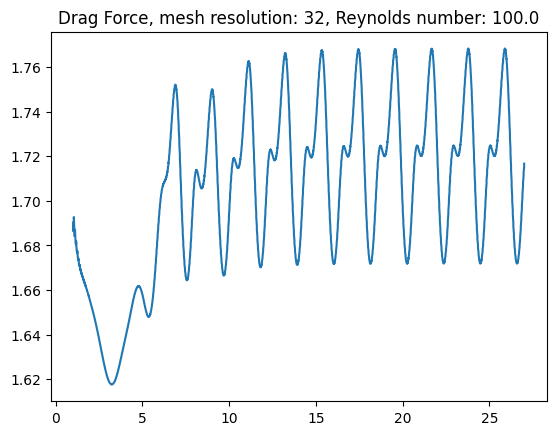

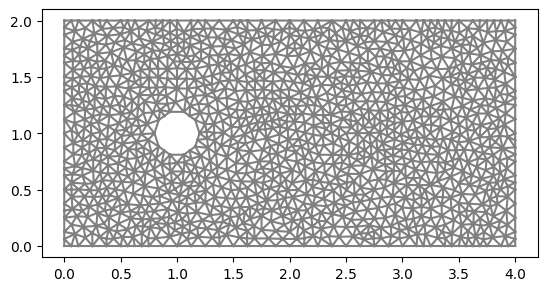

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_734688cac55054badb4d7a676aca27ca8d97e798

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      2
  Arguments:                 '(v_0, v_1)'
  Number of coefficients:    2
  Coefficients:              '[f_304290, f_304293]'
  Unique elements:           'Vector<2 x CG1(?,?)>'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 10
INFO:FFC:  quadrature_degree: 10
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.063864 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:--------------------

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_12422b75e1c0915987a41c4bed3ebed0eaf72bc4

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      1
  Arguments:                 '(v_0)'
  Number of coefficients:    3
  Coefficients:              '[f_304290, f_304293, f_304299]'
  Unique elements:           'Vector<2 x CG1(?,?)>, CG1(?,?)'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 10
INFO:FFC:  quadrature_degree: 10
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0575376 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:----

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_993f2de0b552f2a736b0143a7f0dc656456a5058

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      0
  Arguments:                 '()'
  Number of coefficients:    4
  Coefficients:              '[f_304290, f_304293, f_304299, f_304303]'
  Unique elements:           'Vector<2 x CG1(?,?)>, CG1(?,?)'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 2
INFO:FFC:  quadrature_degree: 2
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0482118 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC

Time t = 0.03285506167650246


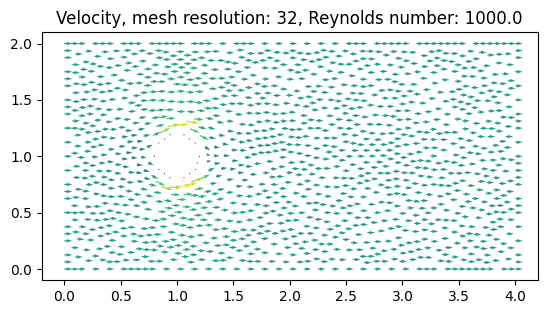

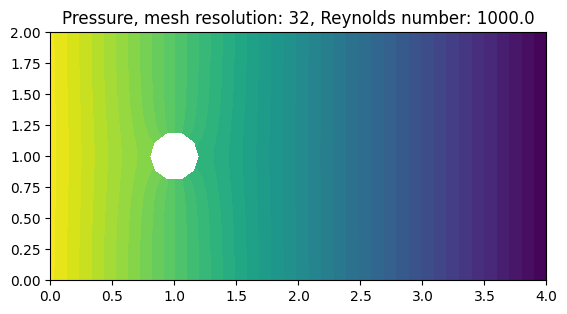

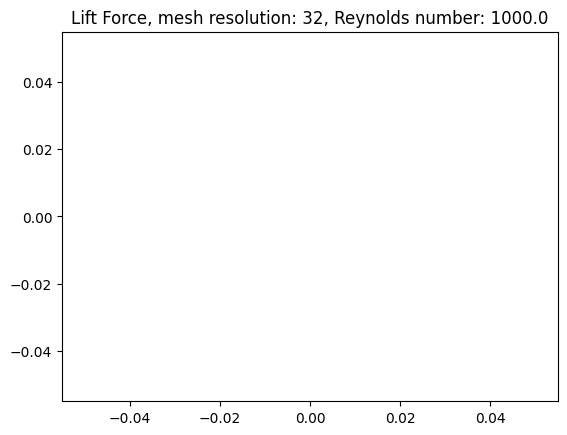

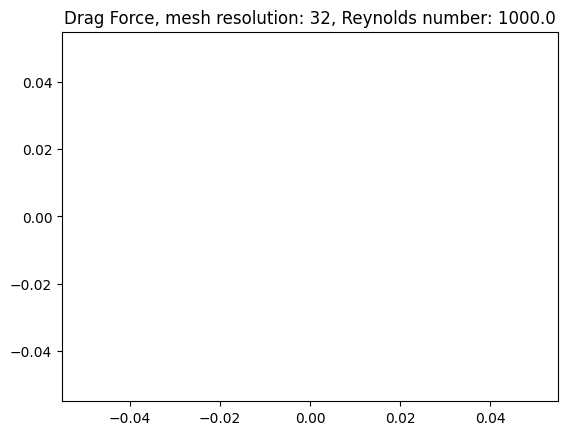

Time t = 3.022665674238231


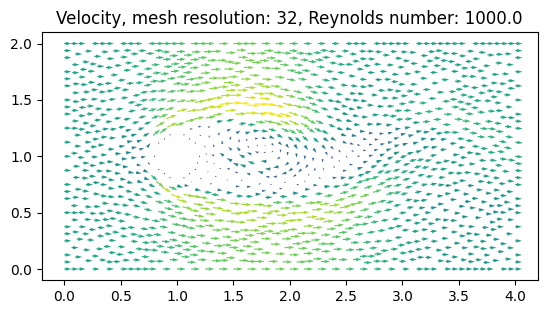

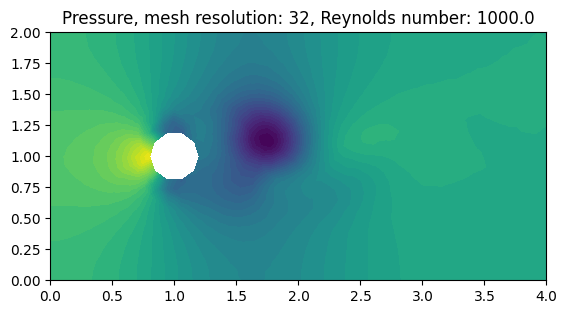

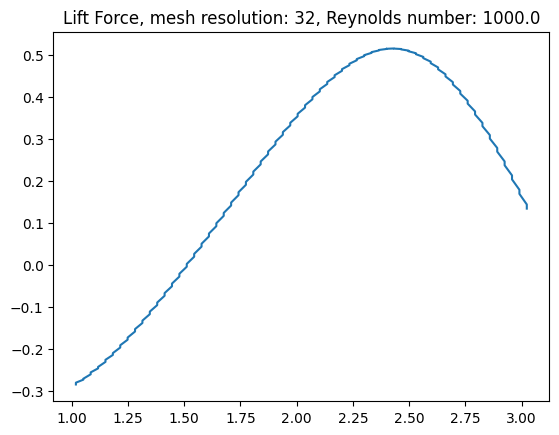

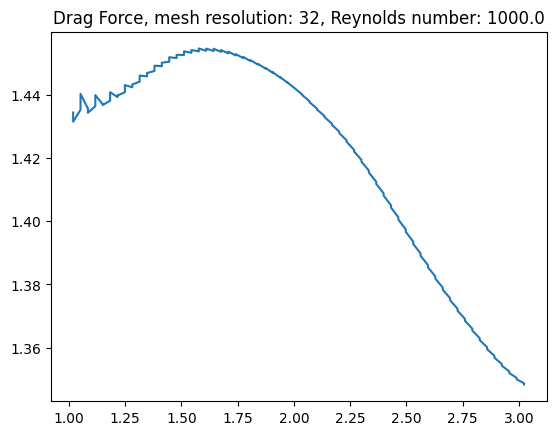

Time t = 6.012476286799972


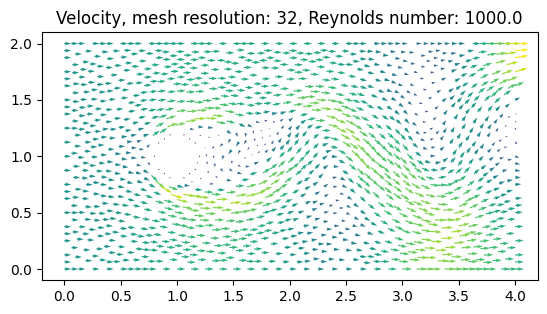

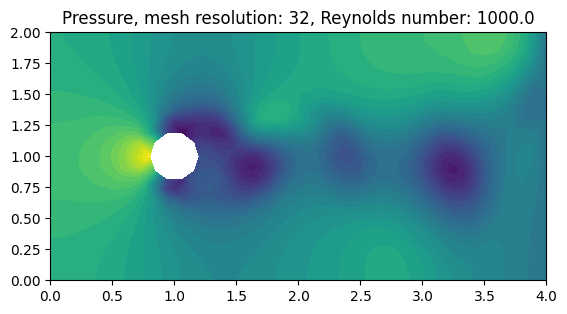

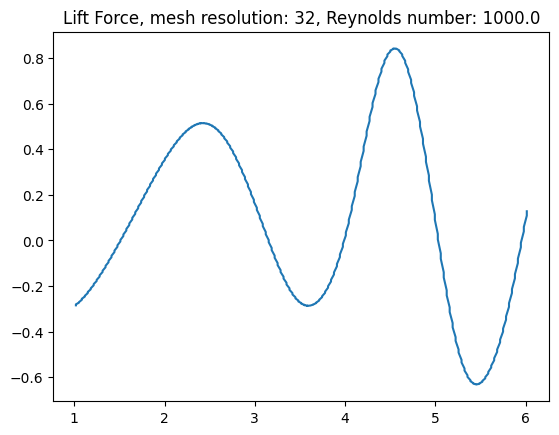

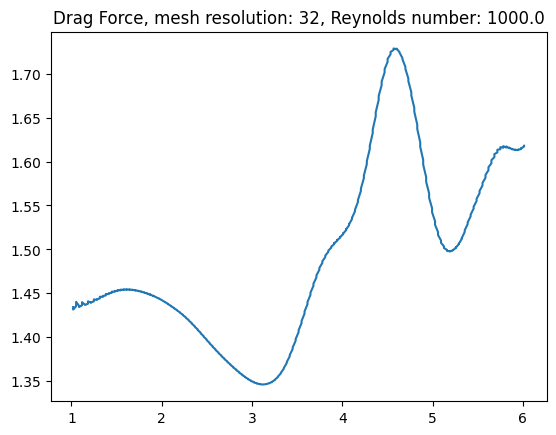

Time t = 9.002286899361685


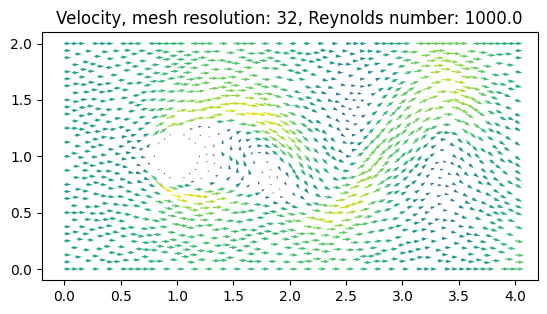

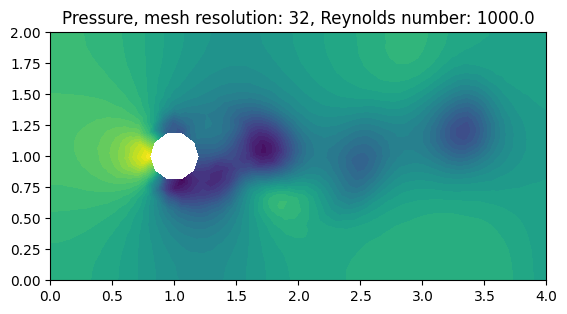

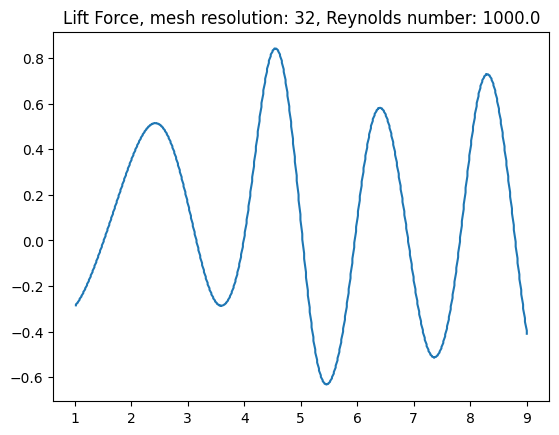

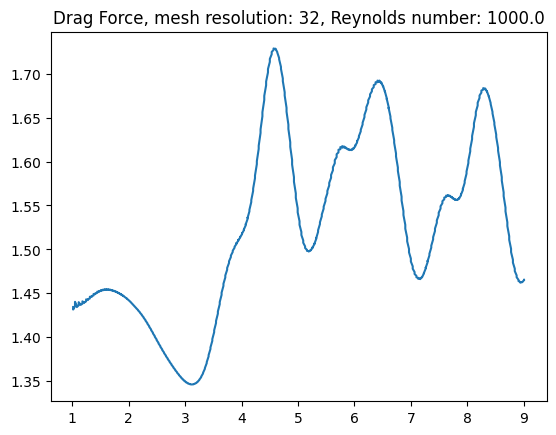

Time t = 12.024952573599847


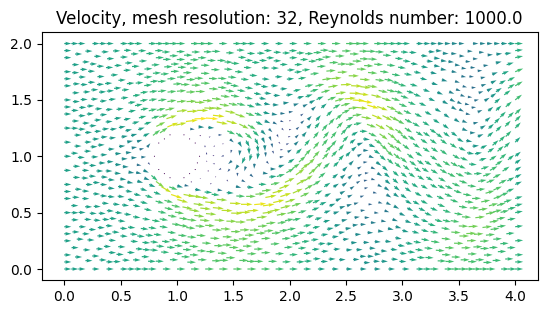

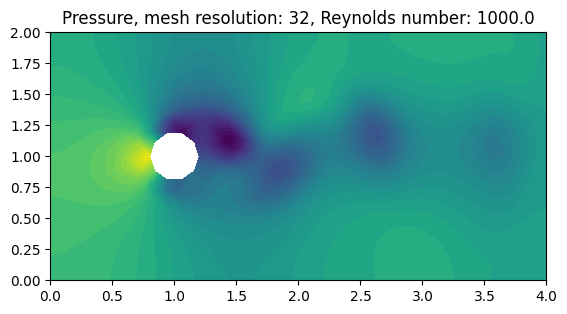

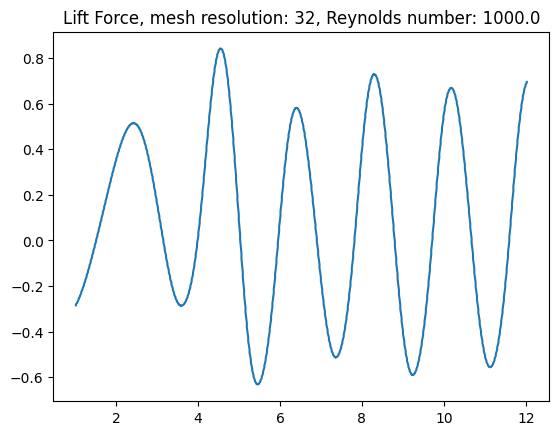

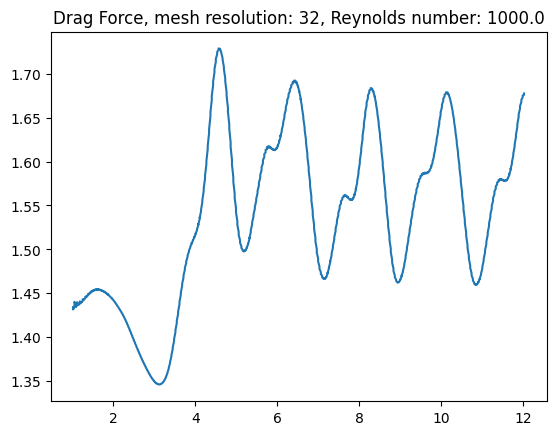

Time t = 15.014763186161508


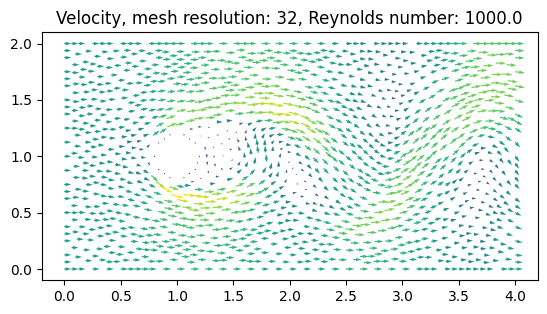

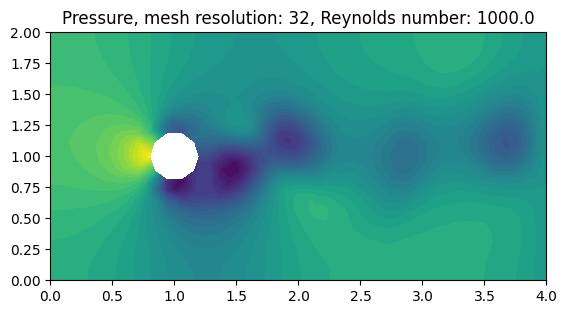

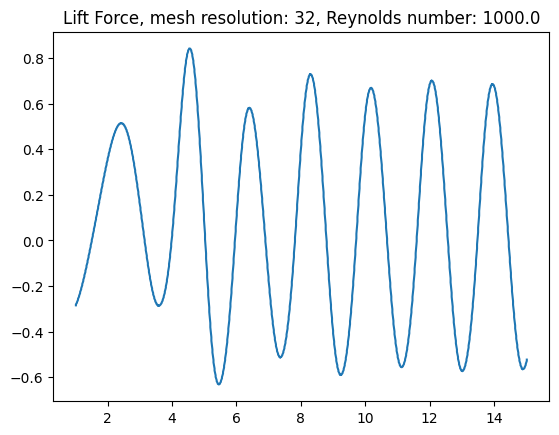

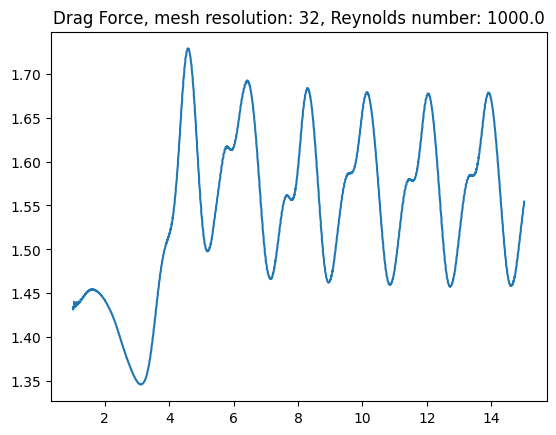

Time t = 18.00457379872328


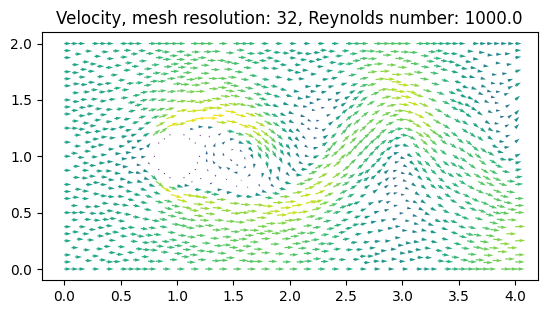

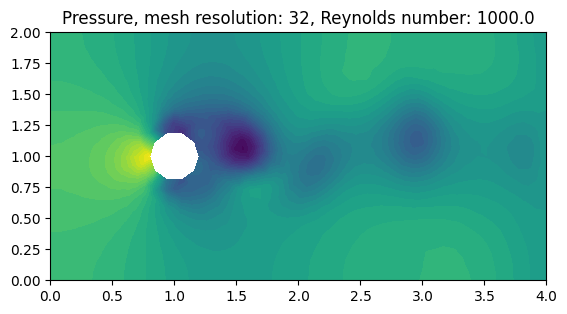

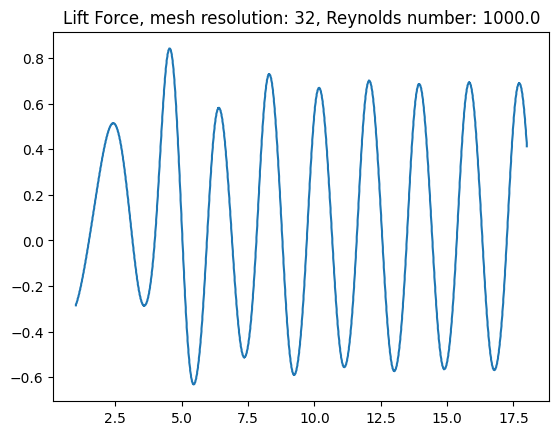

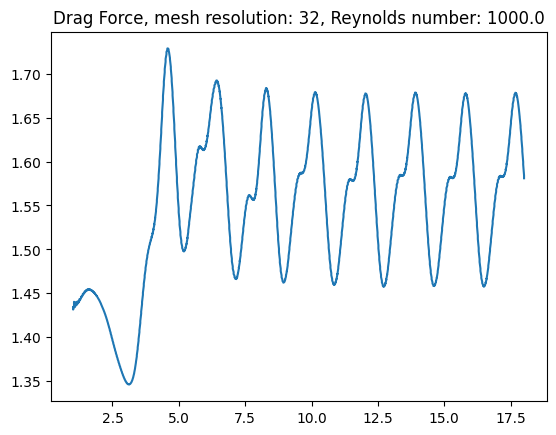

Time t = 21.027239472961604


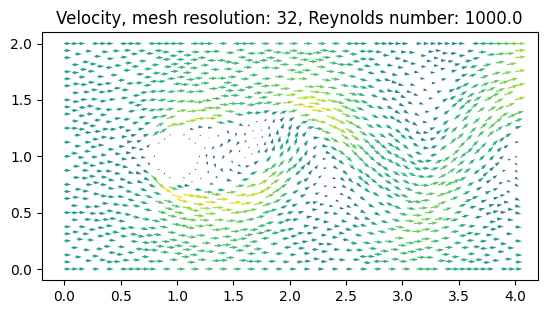

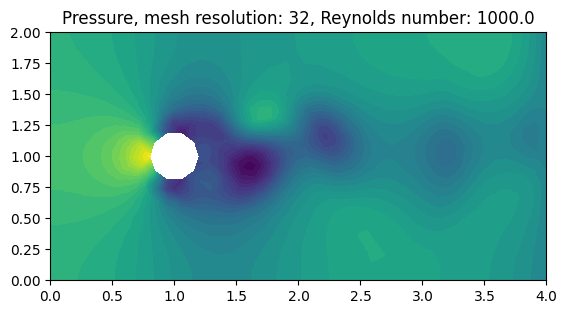

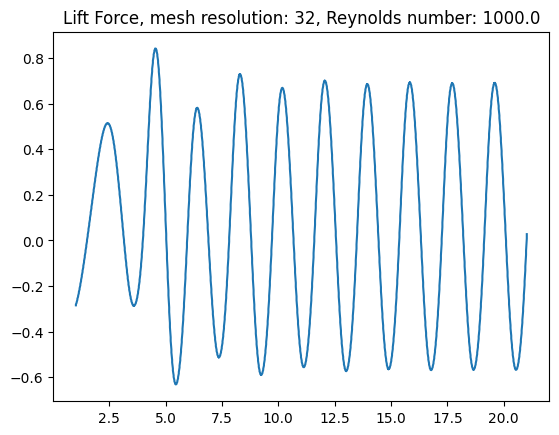

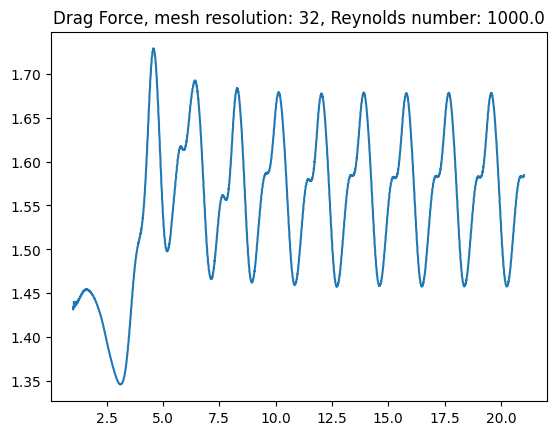

Time t = 24.017050085523426


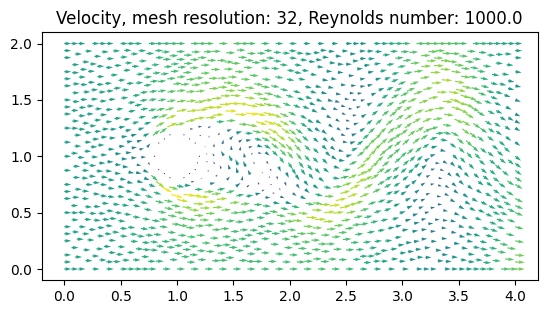

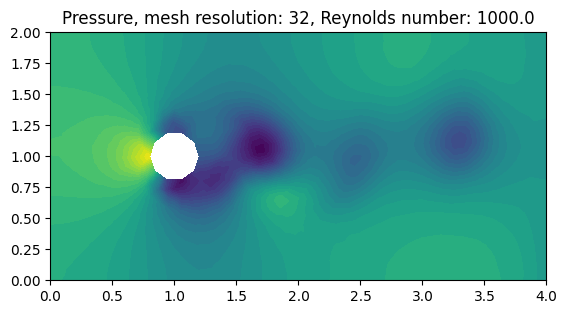

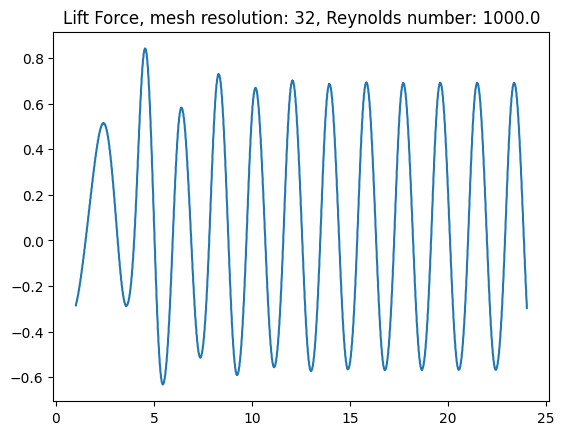

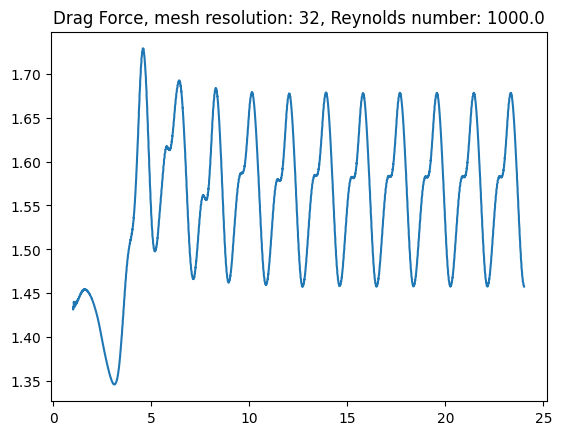

Time t = 27.006860698085248


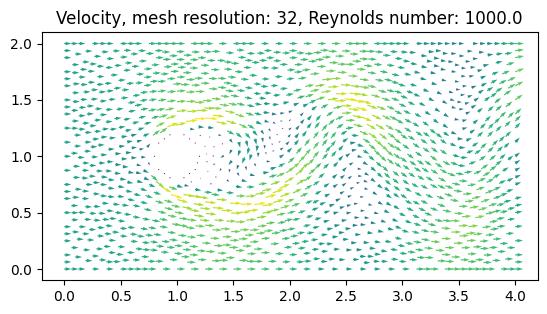

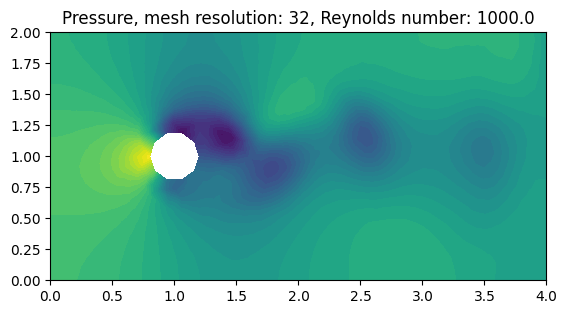

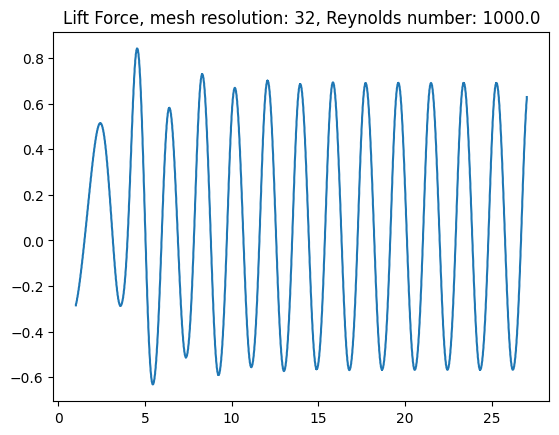

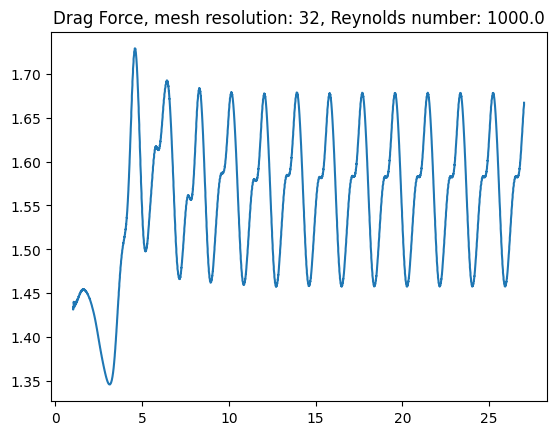

In [ ]:
for nu in nus:
  computeNS(nu, 32)


In [ ]:
def print_res(nus_, D = 0.4, res = 0, U = 1, start = 20):
  Re = [D*U/nu for nu in nus_]
  strouhal = f'Strouhal number    '
  if res:
    nus_ = res
  Str = [get_strouhal(lift[nu], timepoints[nu], D, U) for nu in nus_]
  if res:
    re = Re[0]
    for (i,_) in enumerate(nus_):
      if re > 50:
        strouhal += f'| {Str[i]:8.5f} '
      else:
        strouhal += '|'+ ' '*10
  else:
    for (i,re) in enumerate(Re):
      if re > 50:
        strouhal += f'| {Str[i]:8.5f} '
      else:
        strouhal += '|'+ ' '*10
  Fl = [find_ave(lift[nu], timepoints[nu], start) for (i, nu) in enumerate(nus_)]
  Cl = [2*Fl_/D for Fl_ in Fl]
  Fd = [find_ave(drag[nu], timepoints[nu], start) for (i, nu) in enumerate(nus_)]
  Cd = [2*Fd_/D for Fd_ in Fd]
  if res:
    print('Mesh resolution    |' + '|'.join([f' {re:8d} ' for re in nus_]))
  else:
    print('Reynolds number    |' + '|'.join([f' {re:8.1f} ' for re in Re]))
  print(f'-'*len(strouhal))
  print(f'Average lift force |' + '|'.join([f' {l:8.5f} ' for l in Fl]))
  print(f'Lift coefficient   |' + '|'.join([f' {cl:8.5f} ' for cl in Cl]))
  print(f'-'*len(strouhal))
  print(f'Average drag force |' + '|'.join([f' {d:8.5f} ' for d in Fd]))
  print(f'Drag coefficient   |' + '|'.join([f' {cd:8.5f} ' for cd in Cd]))
  print(f'-'*len(strouhal))
  print(strouhal)
   


In [ ]:
print_res(nus)

Reynolds number    |      1.0 |     10.0 |    100.0 |   1000.0 
---------------------------------------------------------------
Average lift force |  0.03784 |  0.05264 |  0.01893 |  0.02506 
Lift coefficient   |  0.18922 |  0.26320 |  0.09465 |  0.12530 
---------------------------------------------------------------
Average drag force | 17.71587 |  3.60582 |  1.71864 |  1.56375 
Drag coefficient   | 88.57936 | 18.02909 |  8.59318 |  7.81876 
---------------------------------------------------------------
Strouhal number    |          |          |  0.19023 |  0.21359 


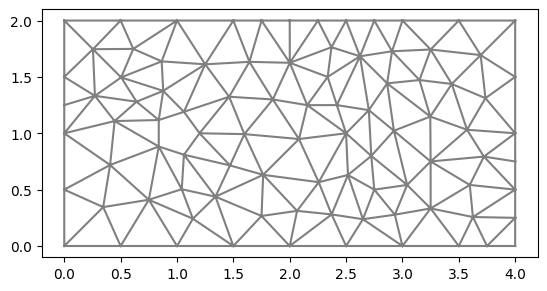

Time t = 0.13091486480653436


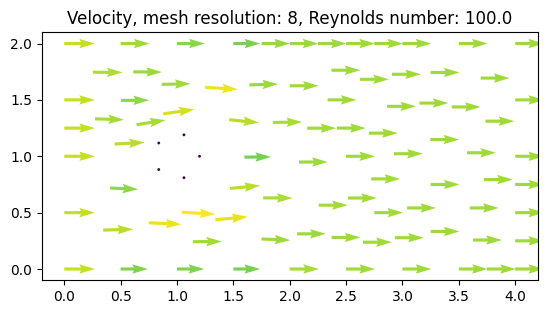

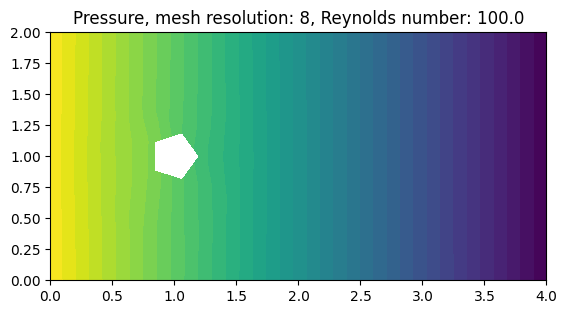

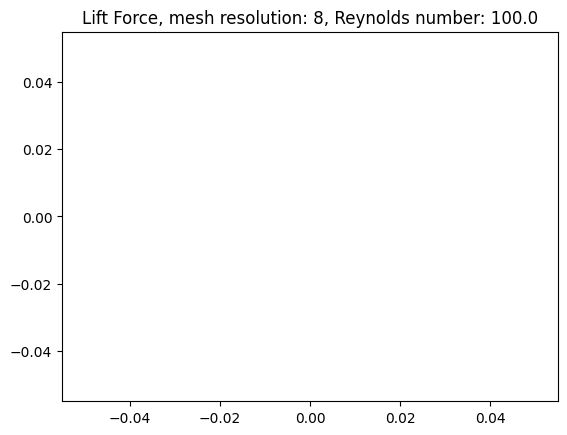

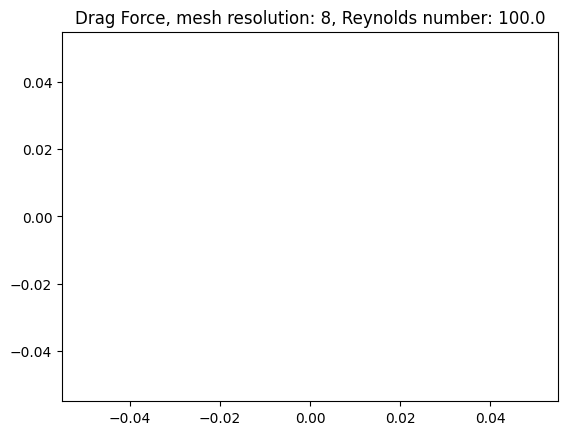

Time t = 3.011041890550292


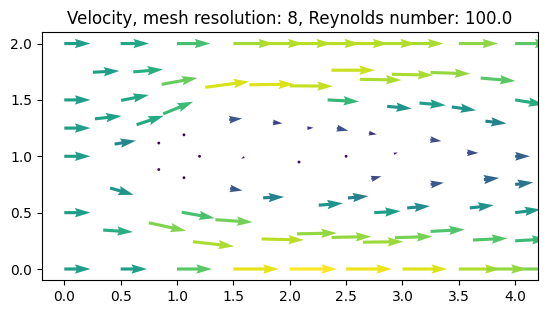

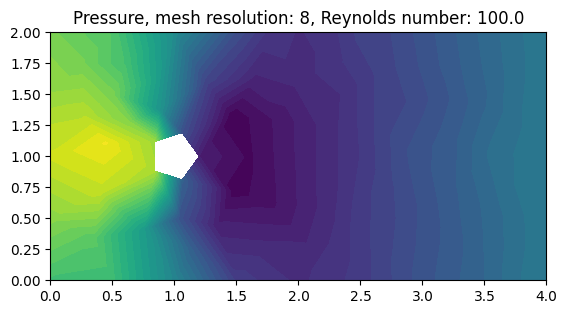

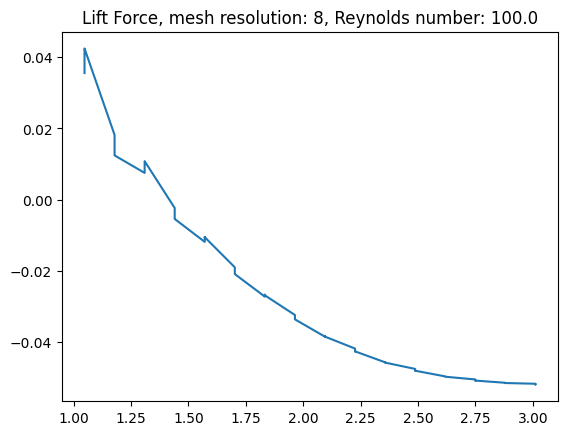

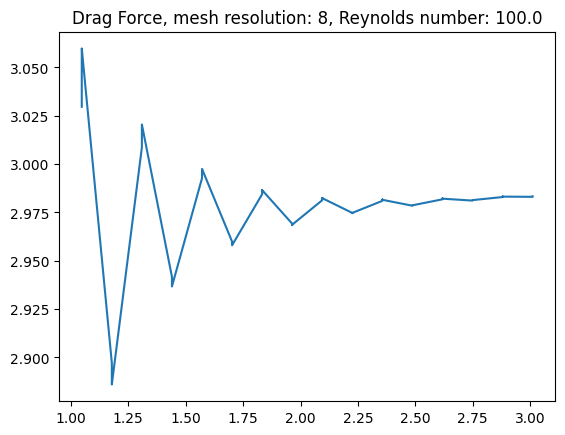

Time t = 6.022083781100587


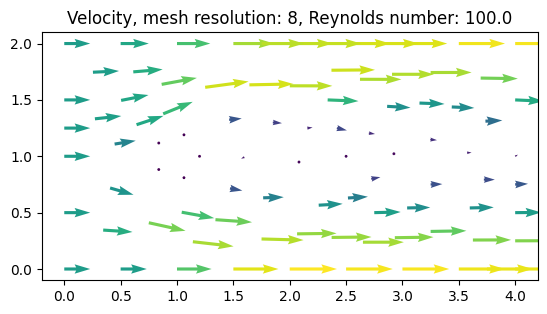

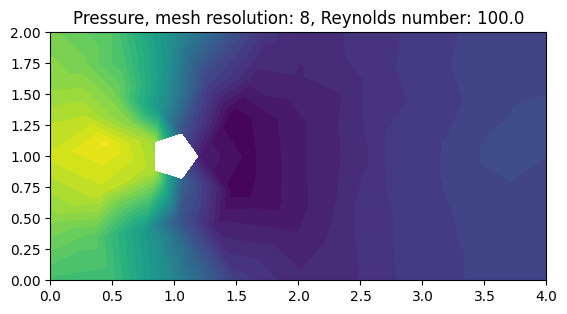

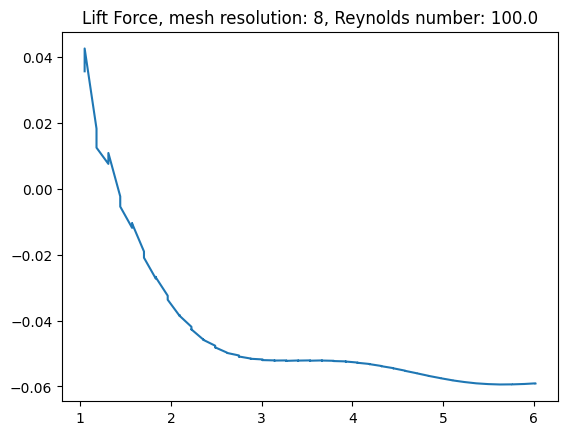

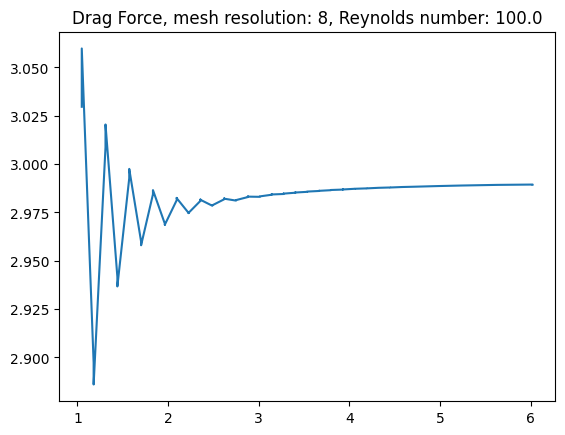

Time t = 9.033125671650883


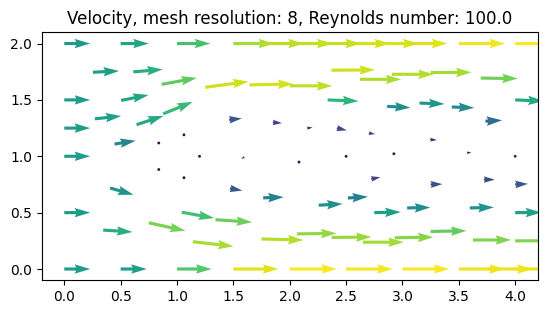

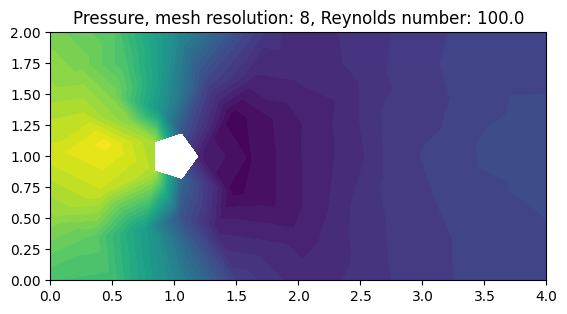

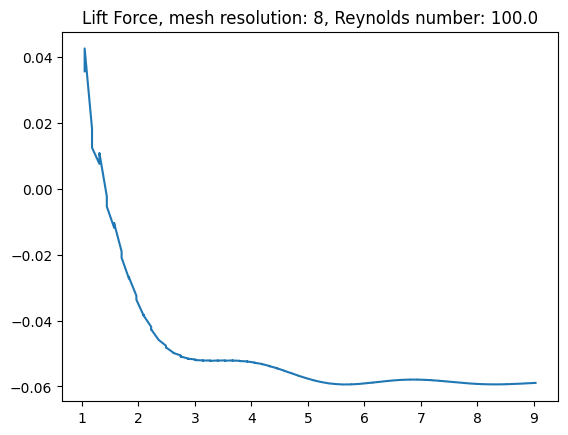

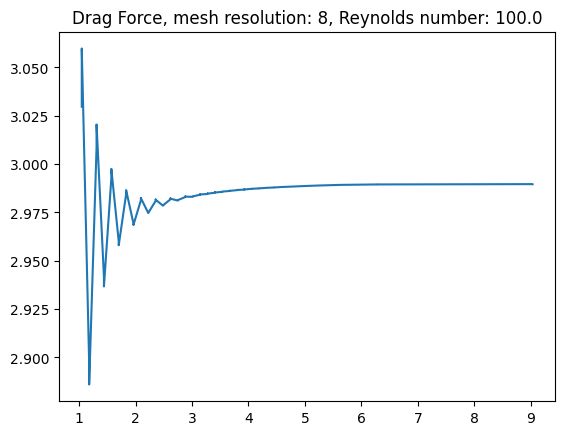

Time t = 12.044167562201178


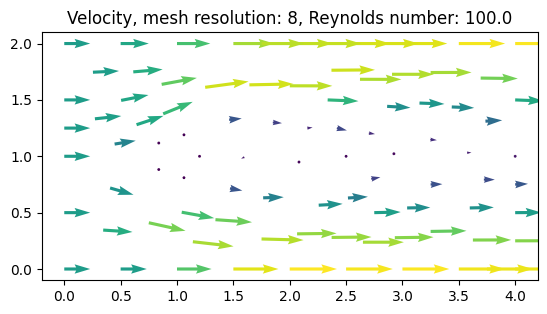

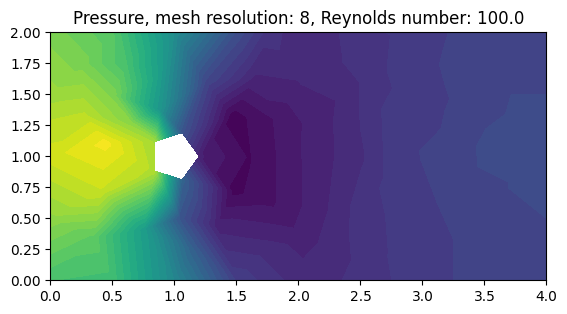

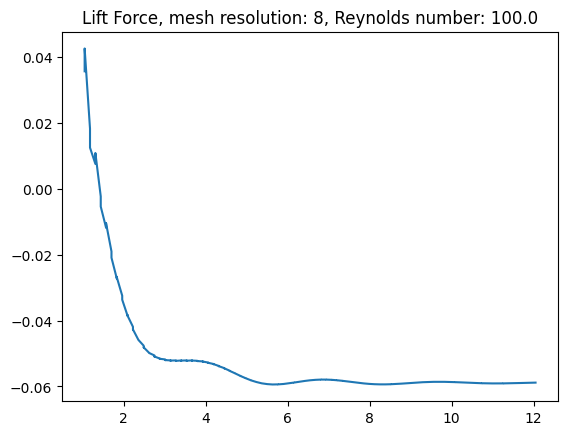

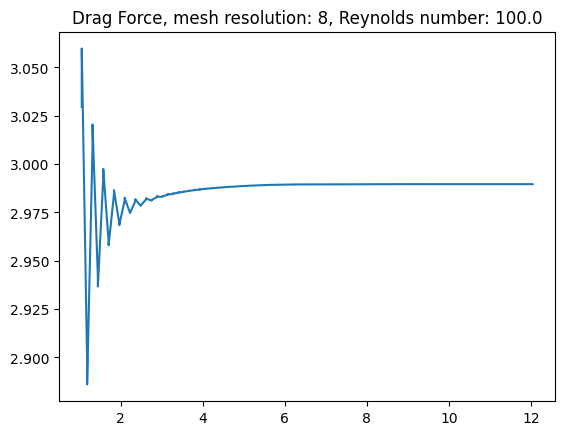

Time t = 15.055209452751473


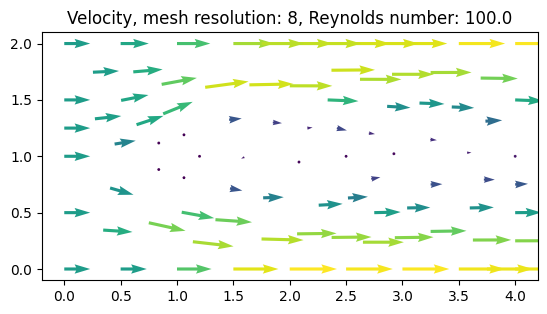

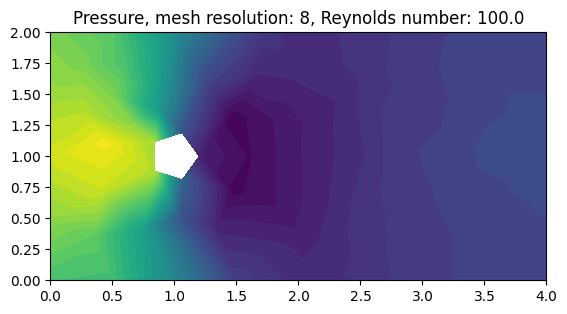

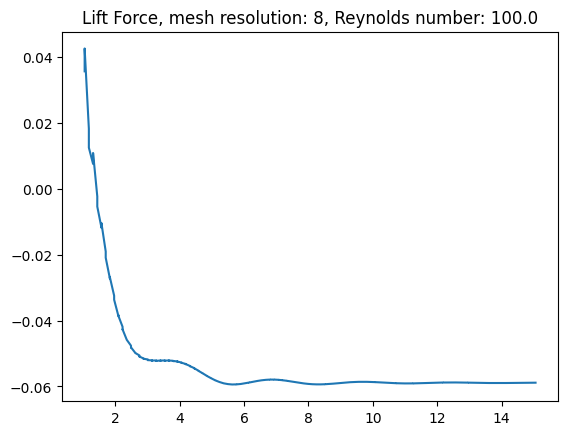

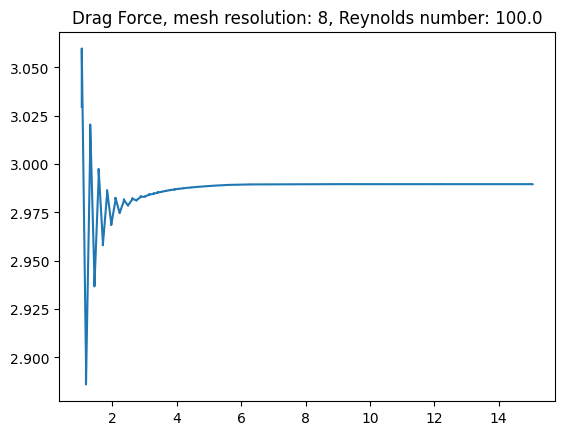

Time t = 18.06625134330177


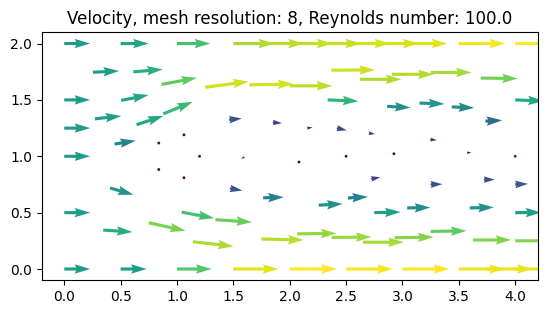

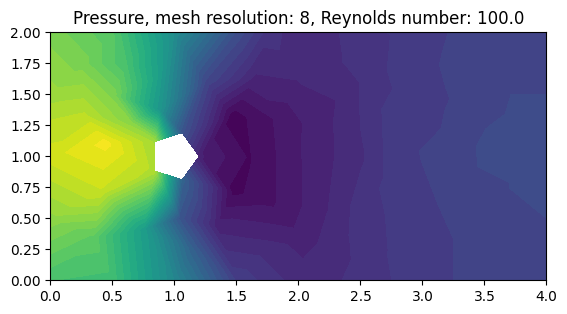

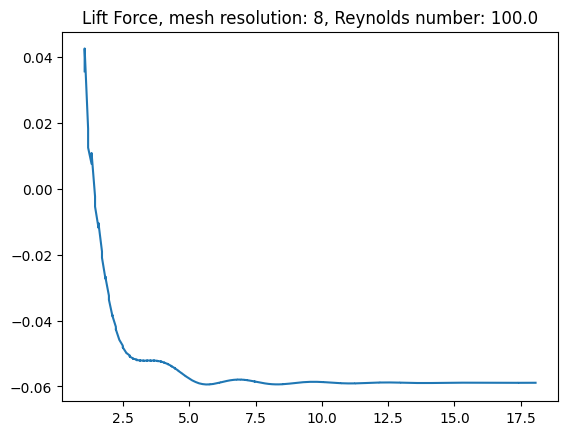

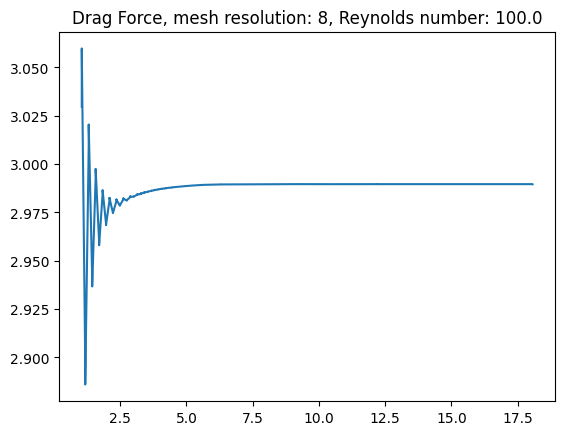

Time t = 21.077293233852064


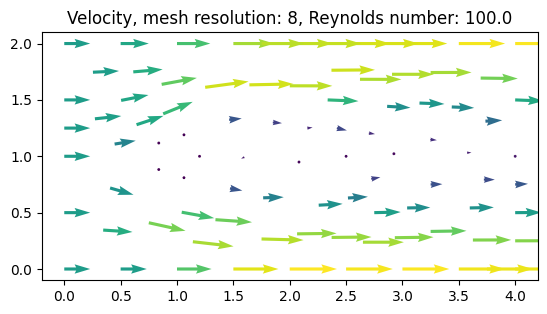

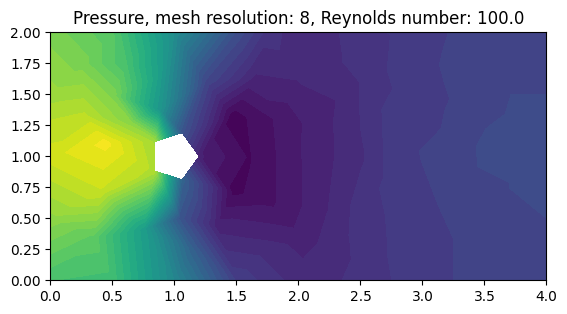

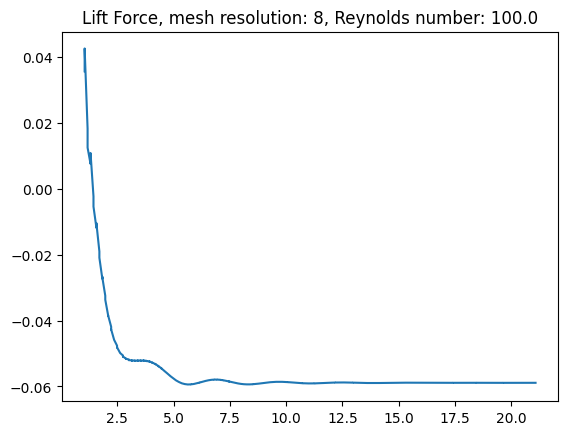

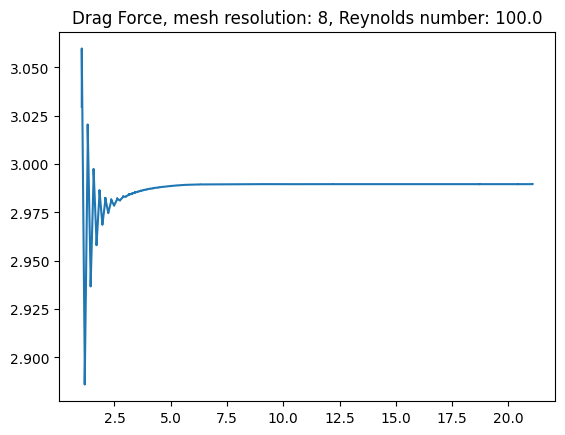

Time t = 24.08833512440236


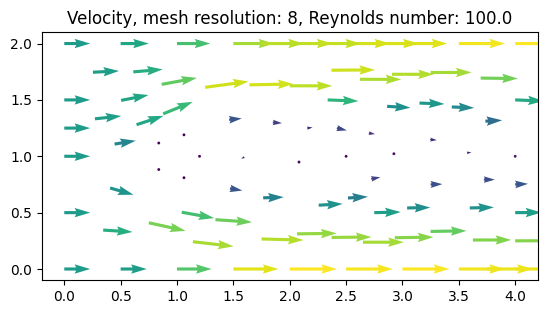

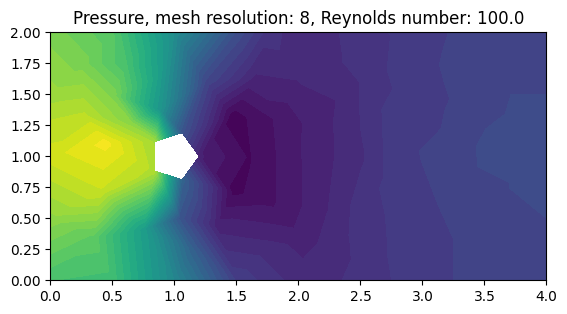

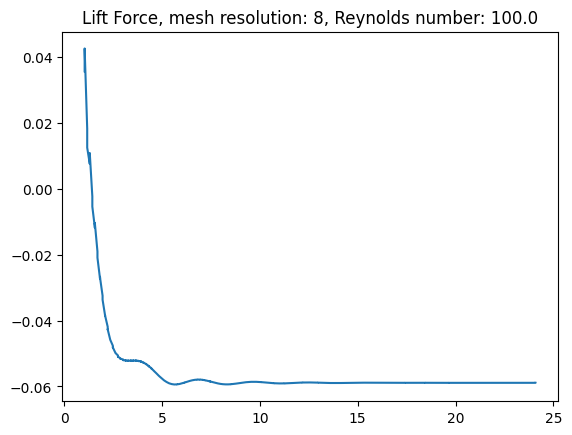

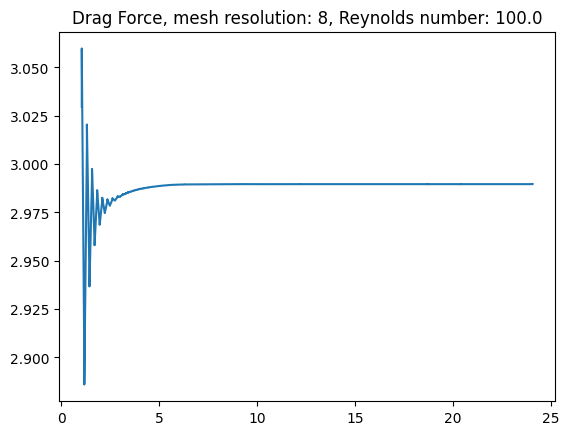

Time t = 27.099377014952655


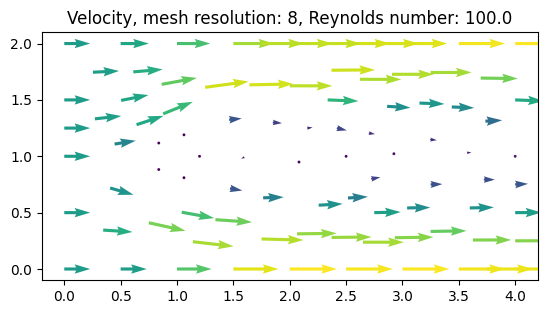

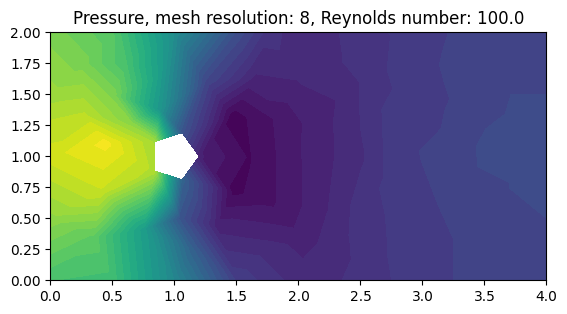

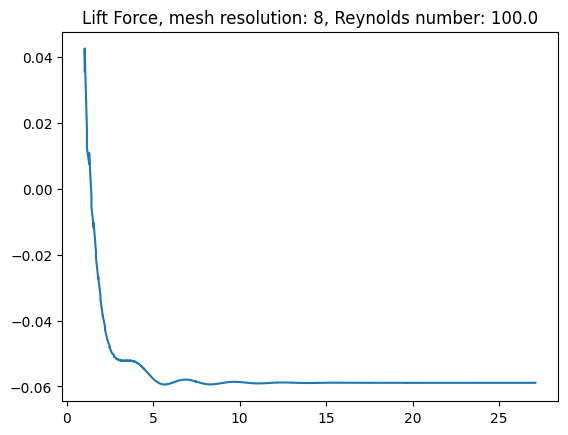

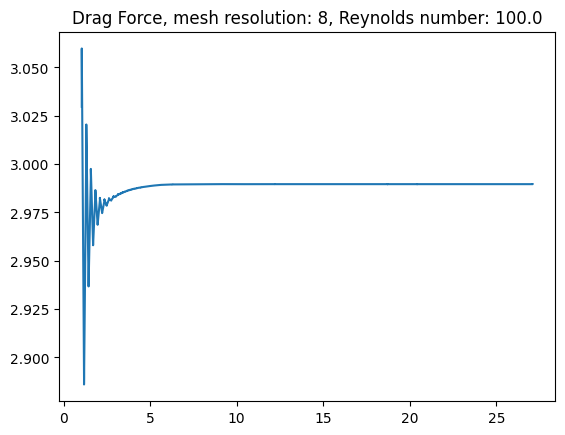

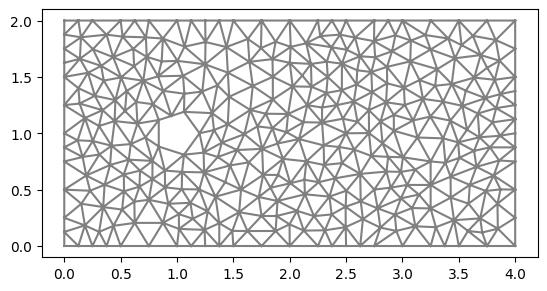

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_48c22b9345fd9366ed8f69f9699d27974f252c32

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      2
  Arguments:                 '(v_0, v_1)'
  Number of coefficients:    2
  Coefficients:              '[f_432599, f_432602]'
  Unique elements:           'Vector<2 x CG1(?,?)>'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 10
INFO:FFC:  quadrature_degree: 10
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0703509 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:-------------------

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_f12c793c6488d7742ee1d9cc0773495e371384fd

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      1
  Arguments:                 '(v_0)'
  Number of coefficients:    3
  Coefficients:              '[f_432599, f_432602, f_432608]'
  Unique elements:           'Vector<2 x CG1(?,?)>, CG1(?,?)'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 10
INFO:FFC:  quadrature_degree: 10
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0625858 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:----

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_e009c3d5ae56ebc25527809070262f8ecf66d4cc

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      2
  Arguments:                 '(v_0, v_1)'
  Number of coefficients:    1
  Coefficients:              '[f_432602]'
  Unique elements:           'CG1(?,?), Vector<2 x CG1(?,?)>'
  Unique sub elements:       'CG1(?,?), Vector<2 x CG1(?,?)>'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 8
INFO:FFC:  quadrature_degree: 8
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.160809 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:----------------------

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_0e9c2ef16296e0bbfc6b3f24e843700e36cee1ef

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      1
  Arguments:                 '(v_0)'
  Number of coefficients:    2
  Coefficients:              '[f_432599, f_432602]'
  Unique elements:           'CG1(?,?), Vector<2 x CG1(?,?)>'
  Unique sub elements:       'CG1(?,?), Vector<2 x CG1(?,?)>'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 9
INFO:FFC:  quadrature_degree: 9
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0593817 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:----------------

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_949587c270fce844e3808e63dcd7441cb51c8104

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      0
  Arguments:                 '()'
  Number of coefficients:    4
  Coefficients:              '[f_432599, f_432602, f_432608, f_432612]'
  Unique elements:           'Vector<2 x CG1(?,?)>, CG1(?,?)'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 2
INFO:FFC:  quadrature_degree: 2
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0564005 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC

Time t = 0.06628038350651762


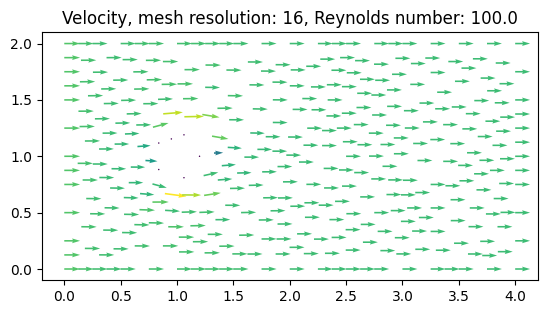

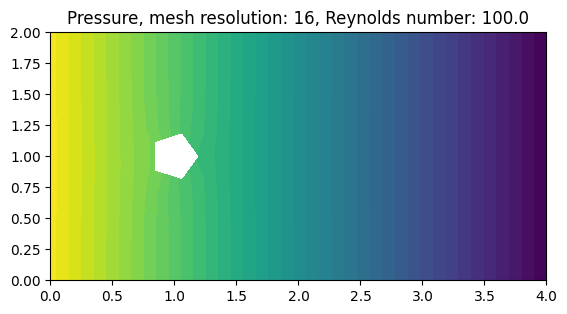

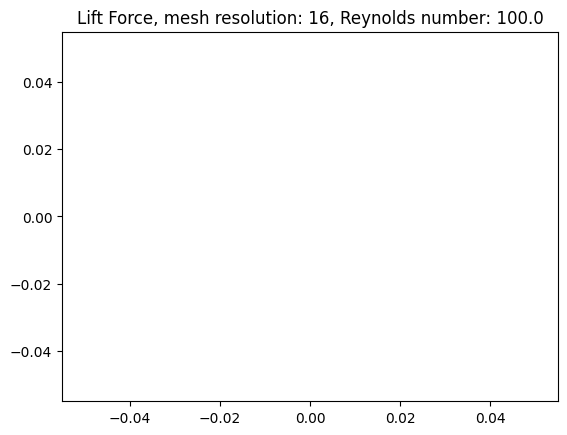

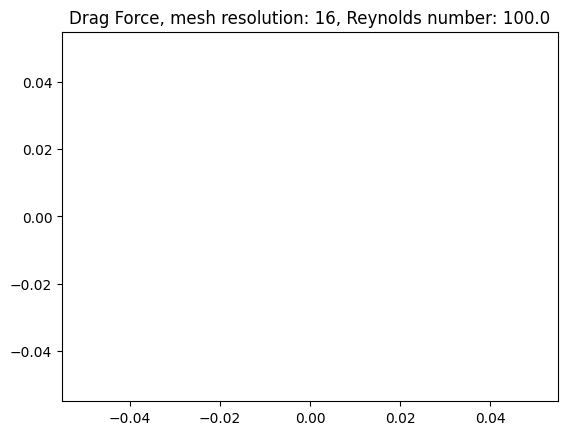

Time t = 3.0488976412998086


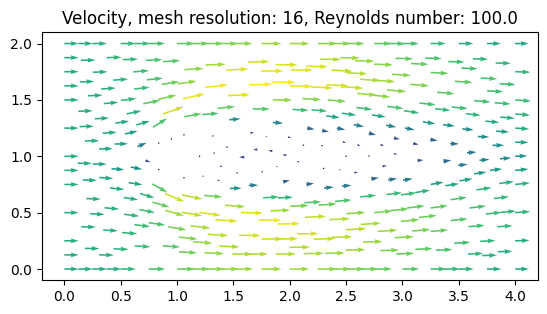

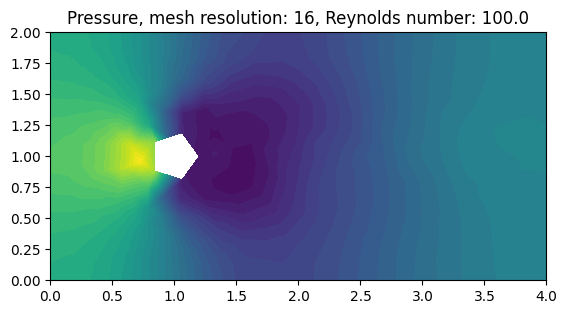

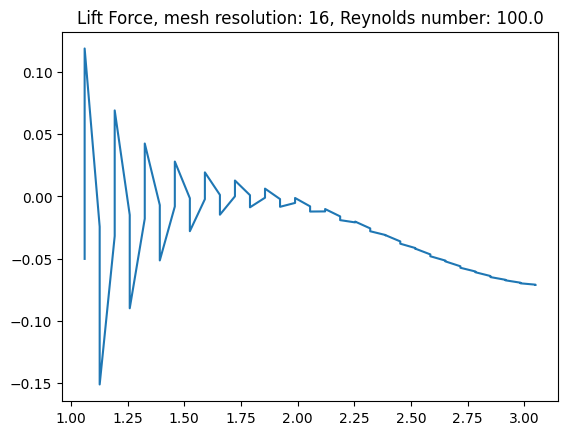

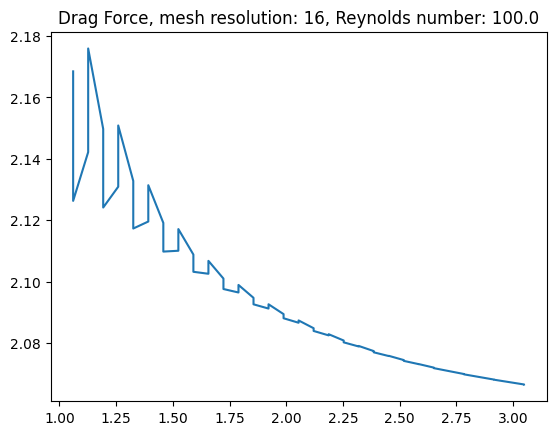

Time t = 6.031514899093112


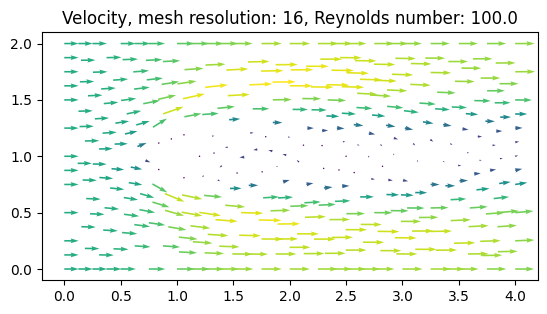

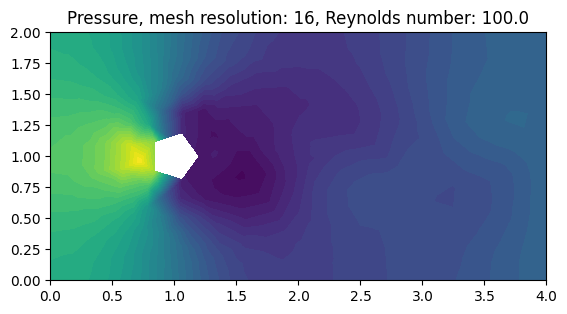

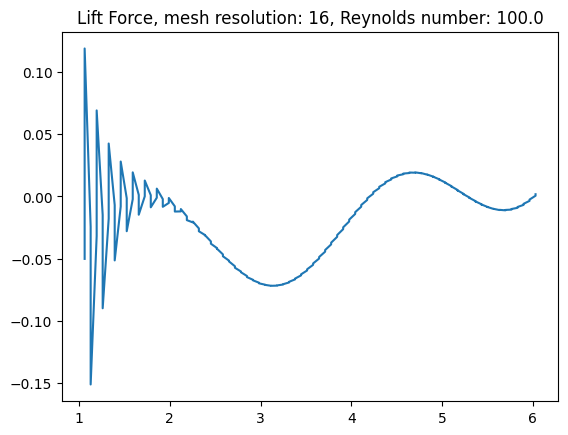

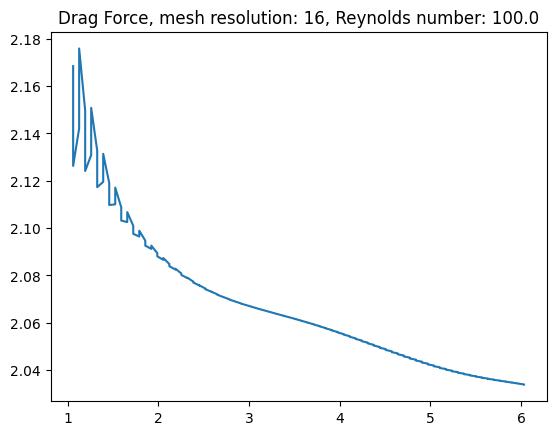

Time t = 9.01413215688642


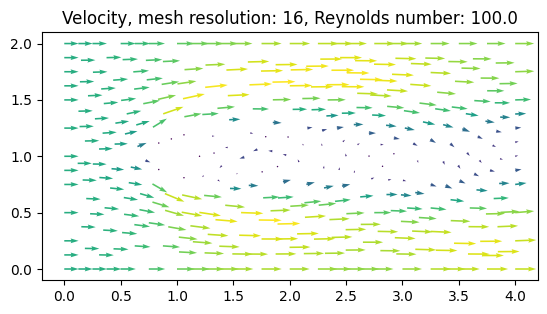

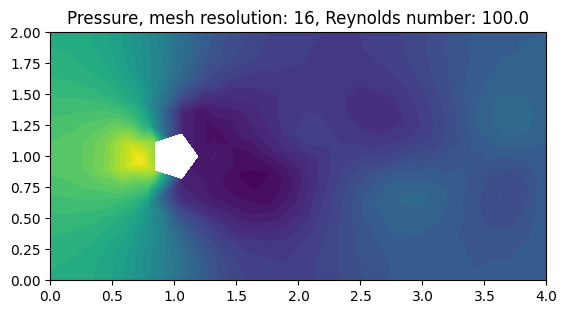

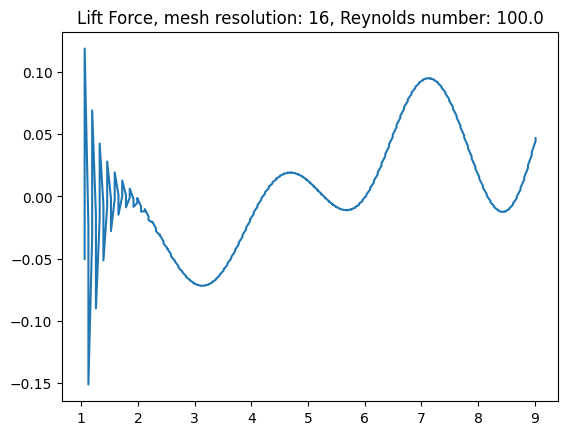

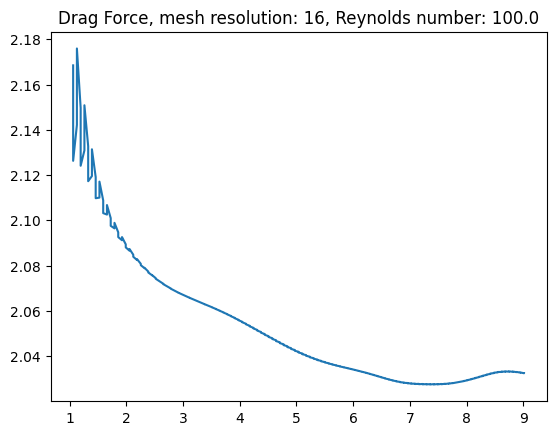

Time t = 12.063029798186248


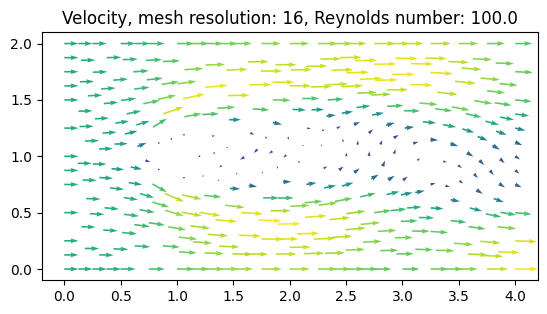

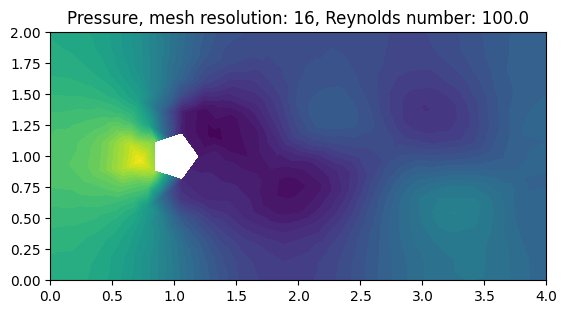

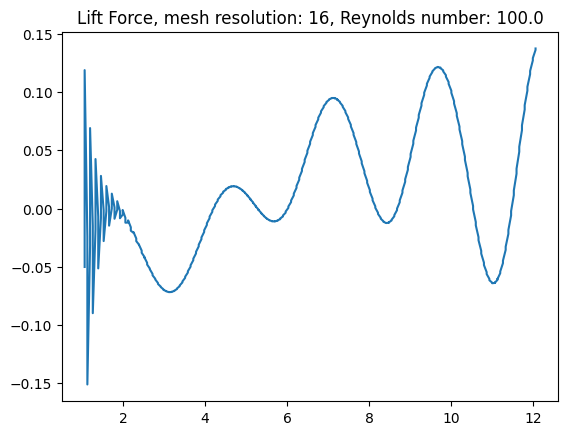

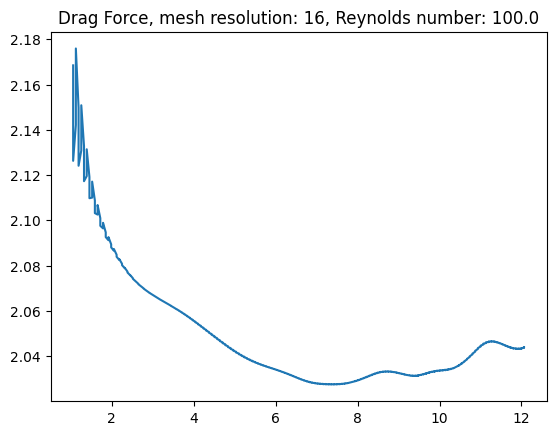

Time t = 15.045647055979558


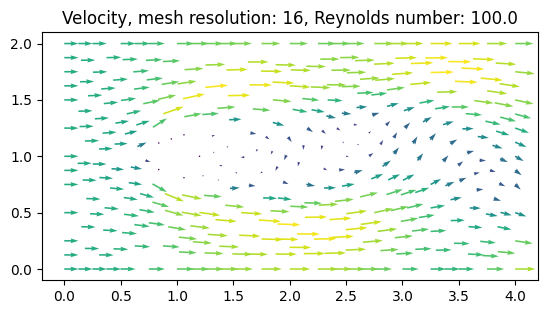

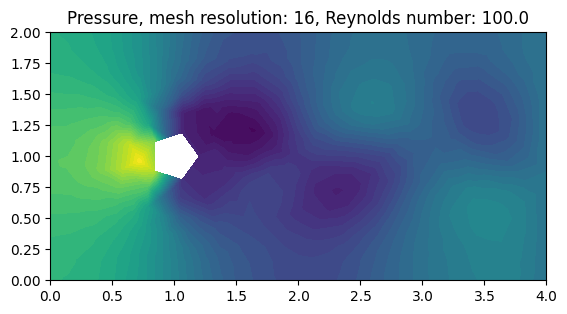

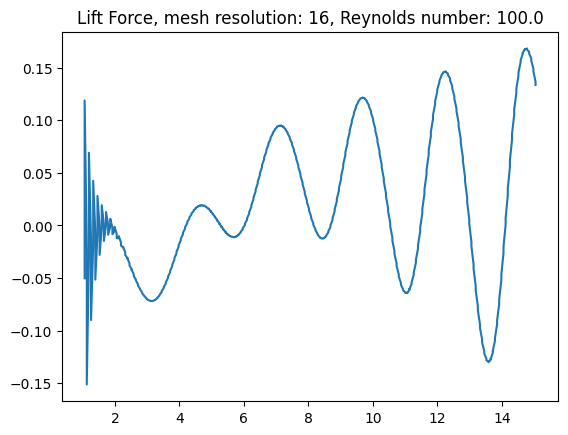

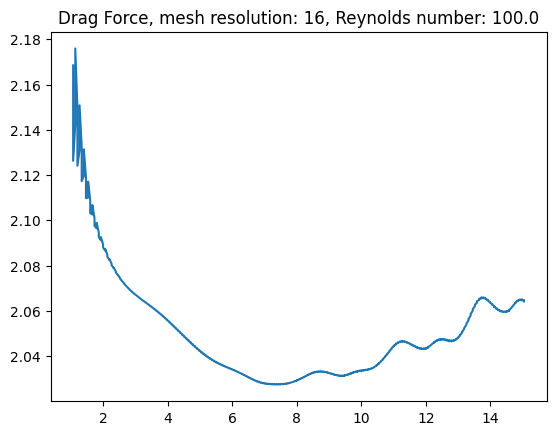

Time t = 18.028264313772812


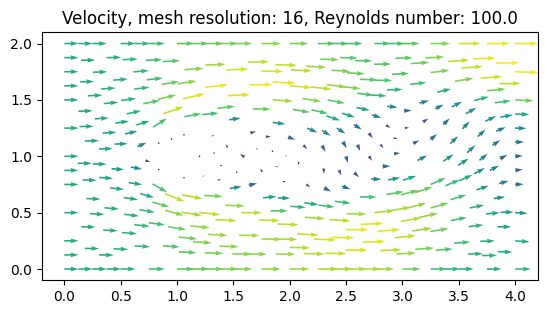

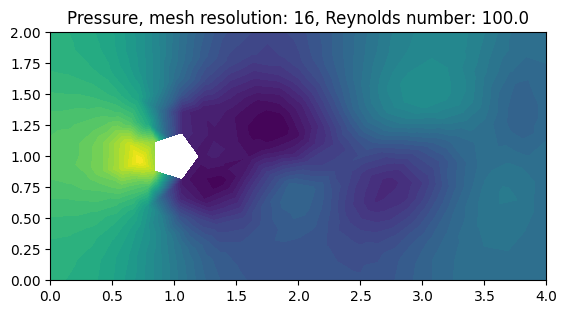

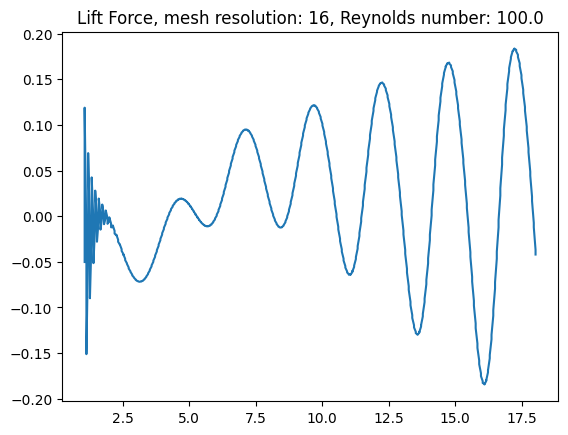

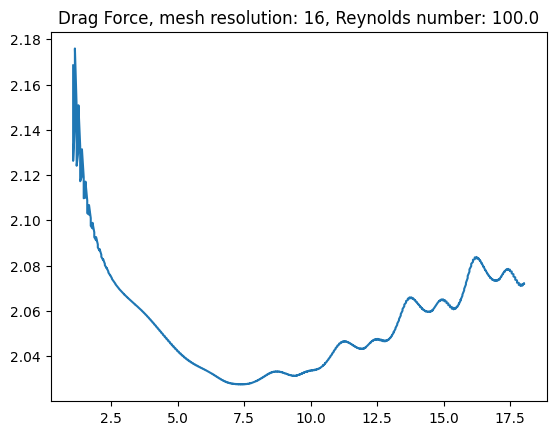

Time t = 21.010881571566042


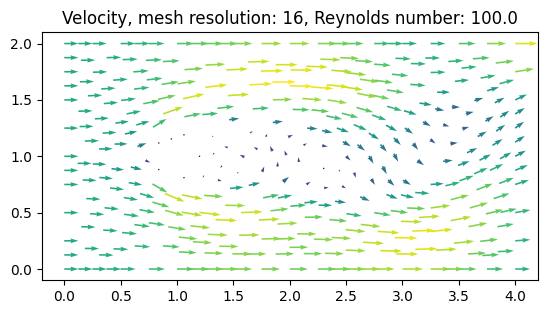

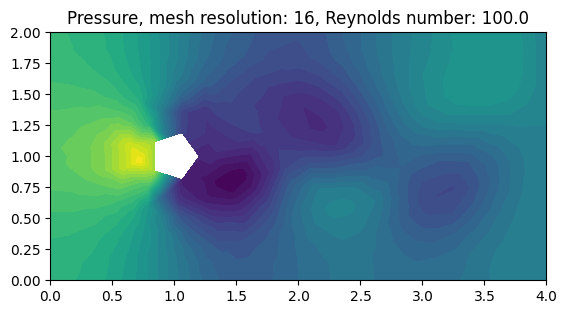

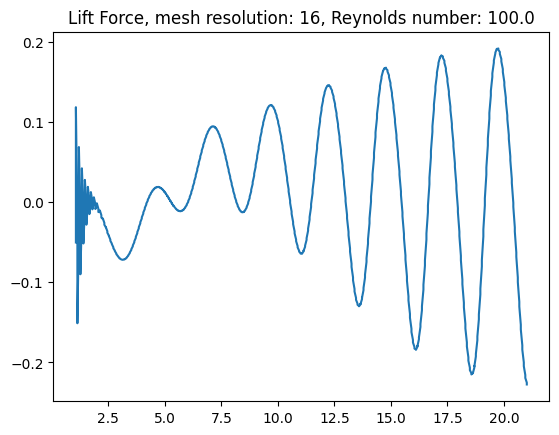

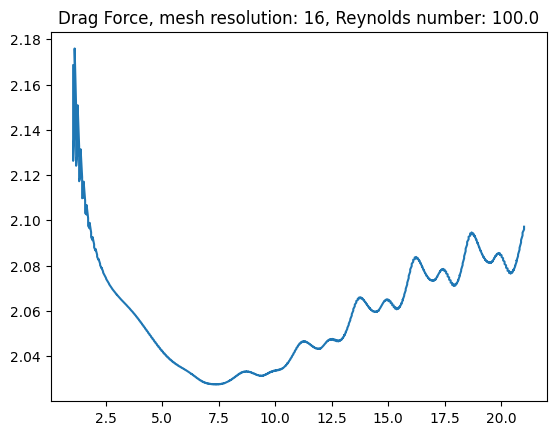

Time t = 24.059779212865788


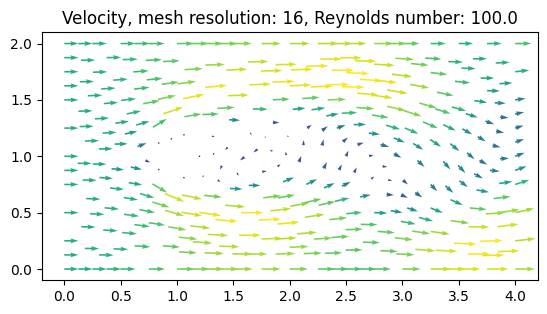

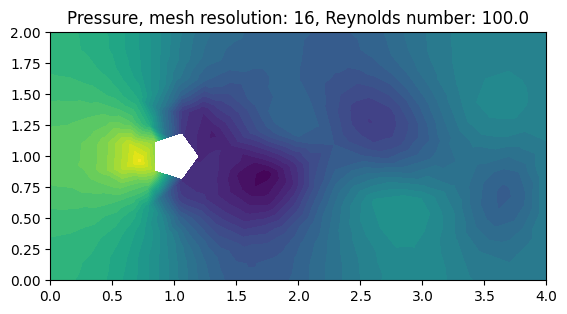

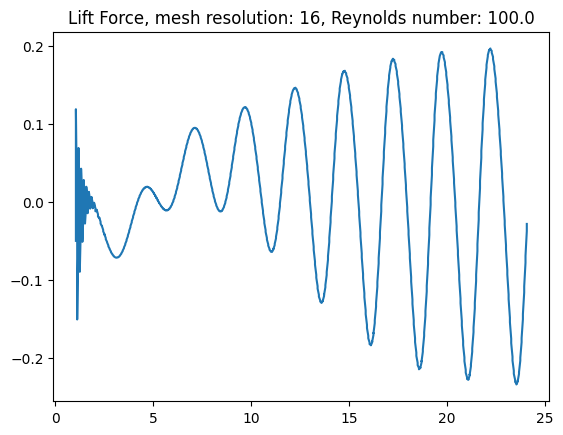

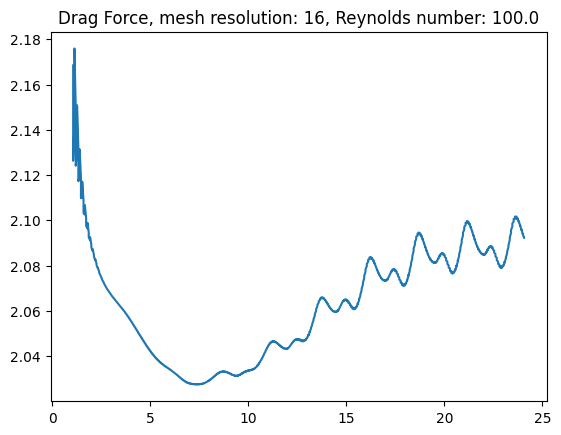

Time t = 27.042396470659018


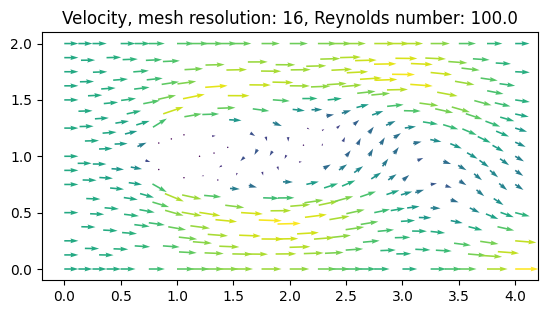

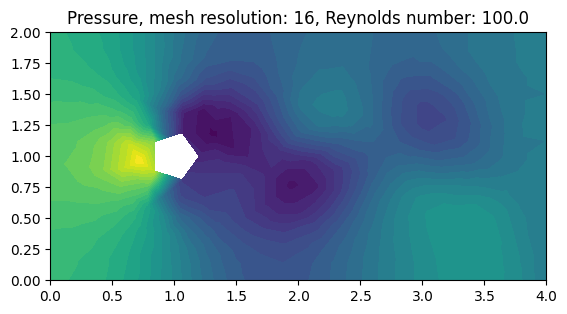

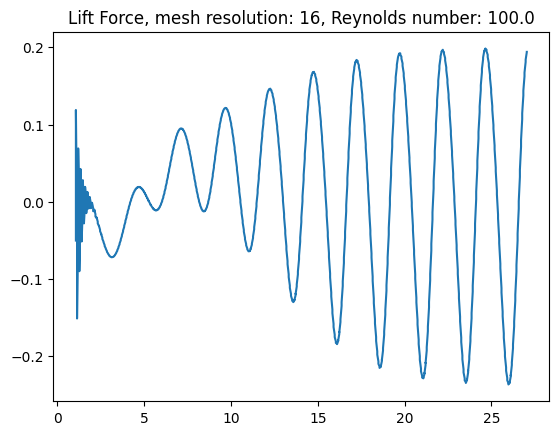

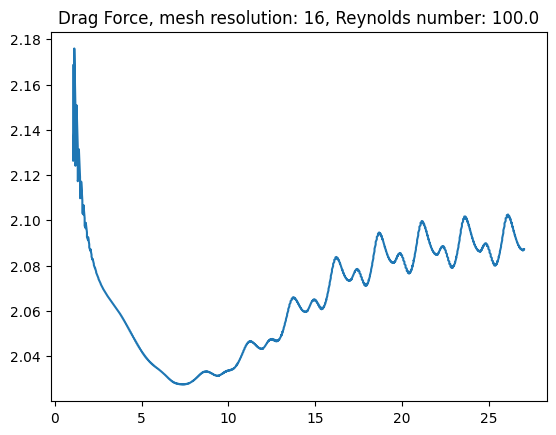

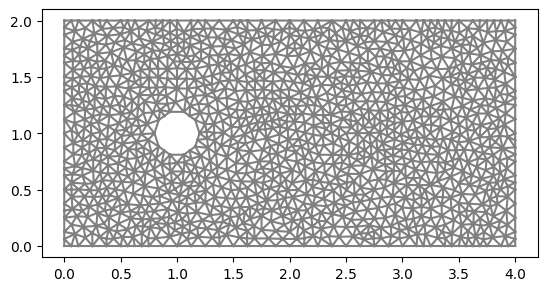

Time t = 0.03285506167650246


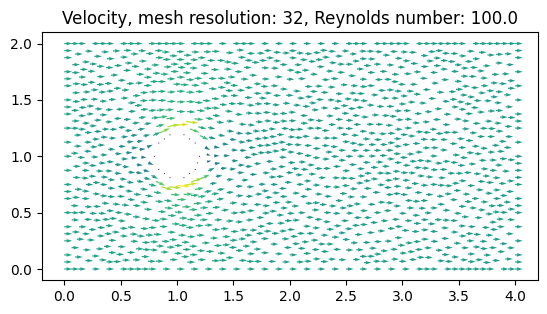

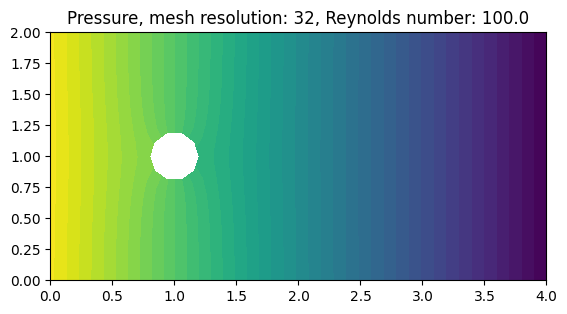

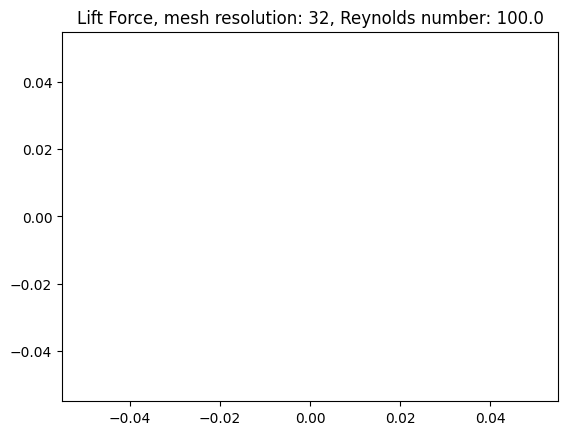

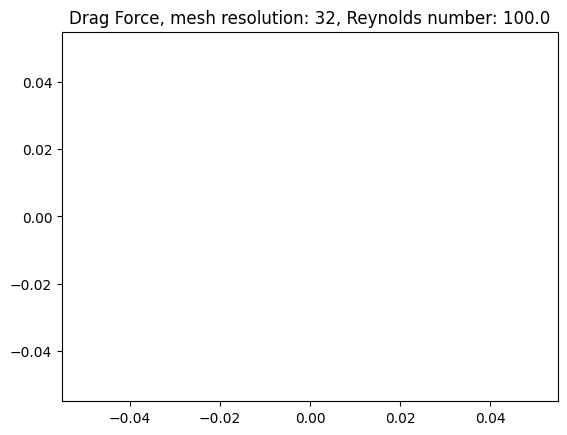

Time t = 3.022665674238231


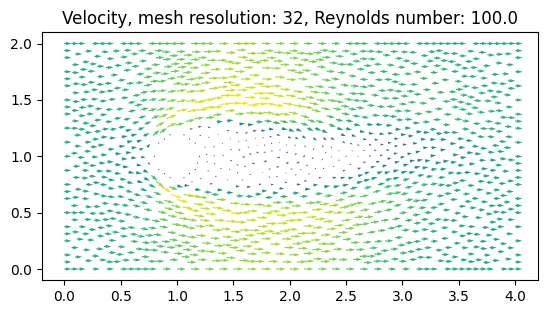

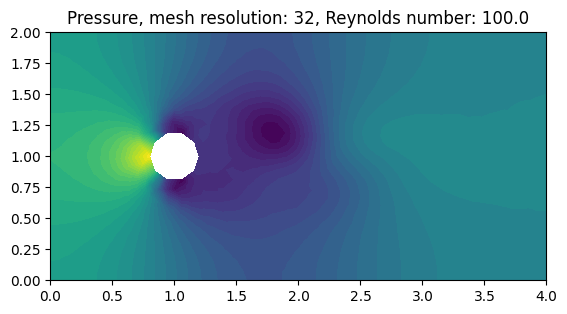

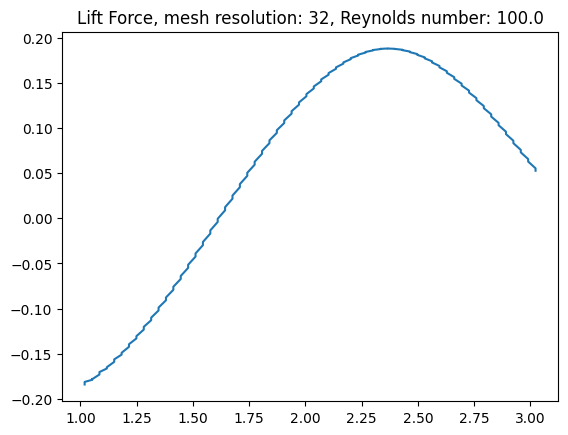

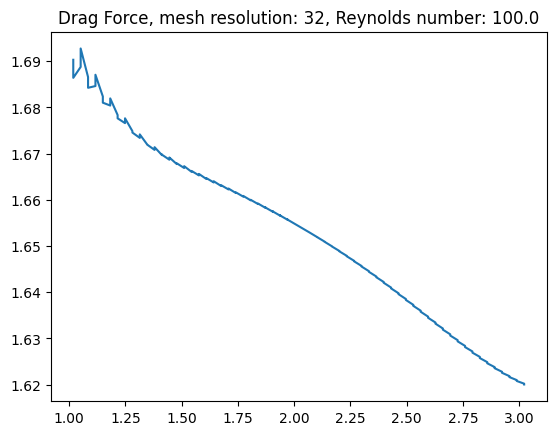

Time t = 6.012476286799972


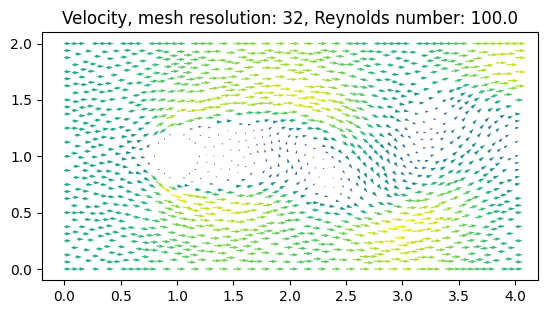

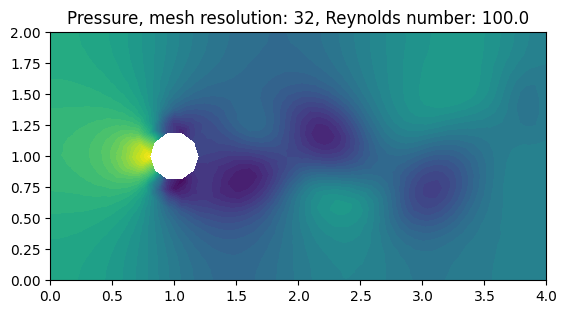

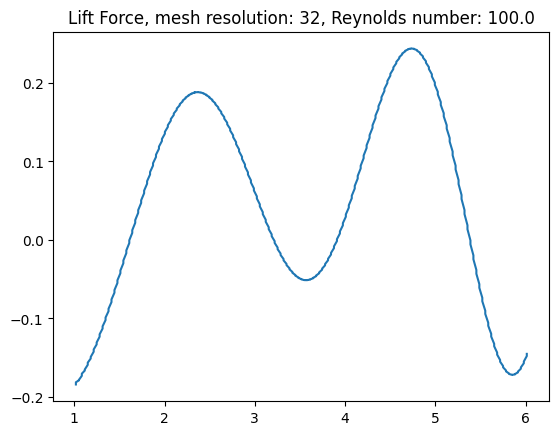

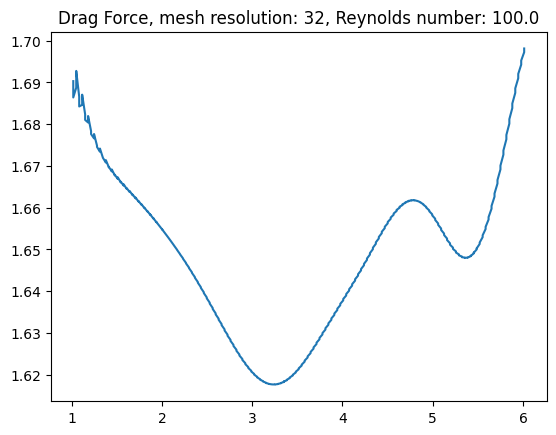

Time t = 9.002286899361685


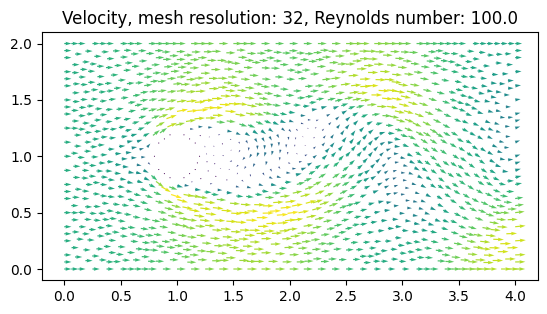

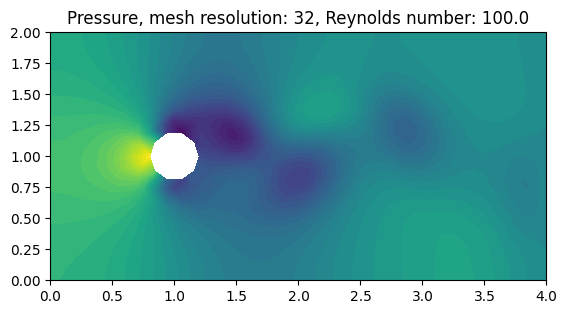

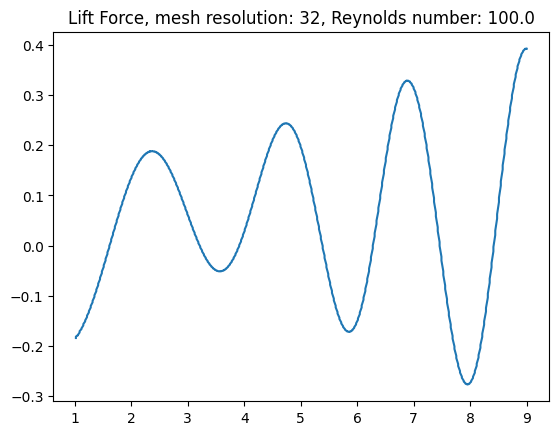

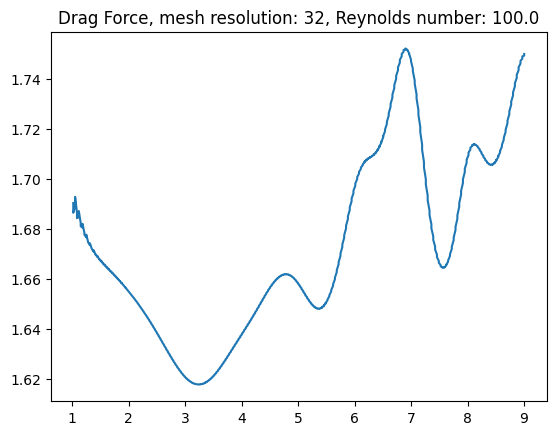

Time t = 12.024952573599847


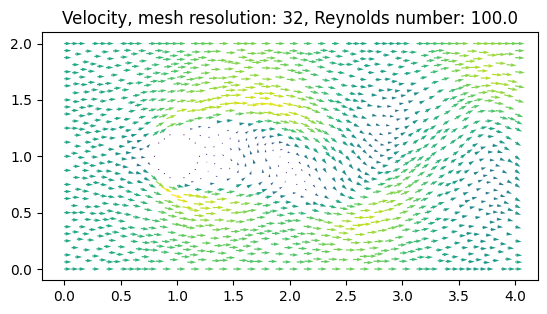

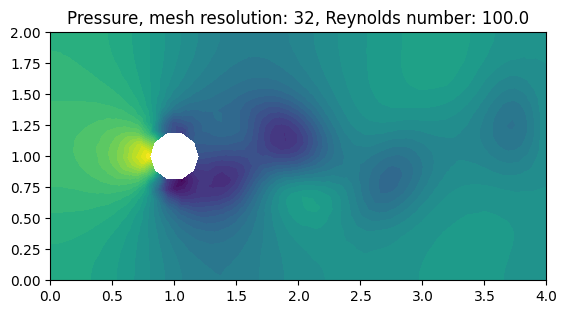

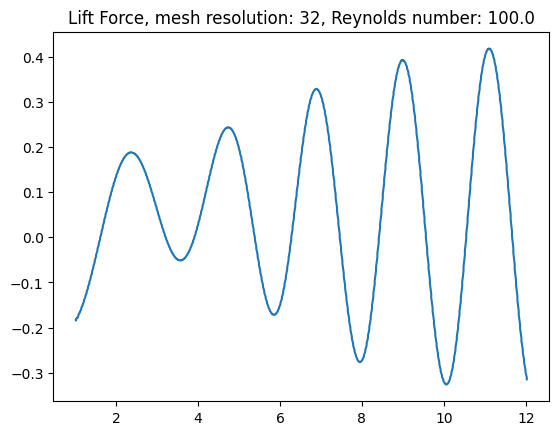

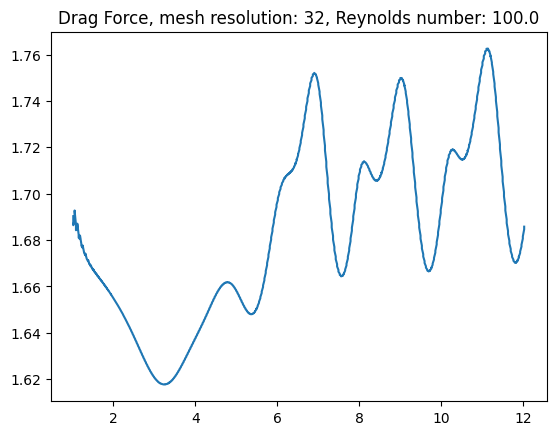

Time t = 15.014763186161508


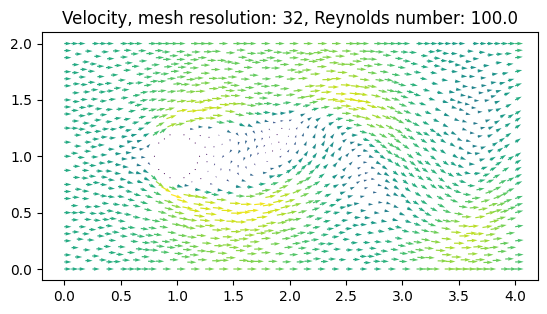

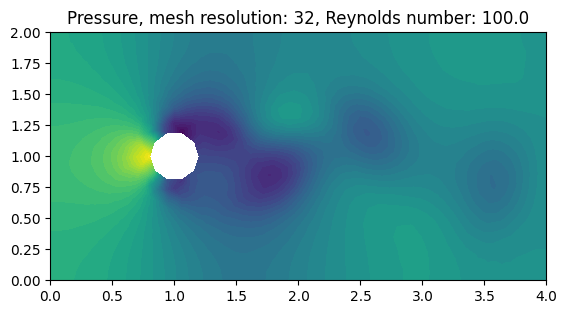

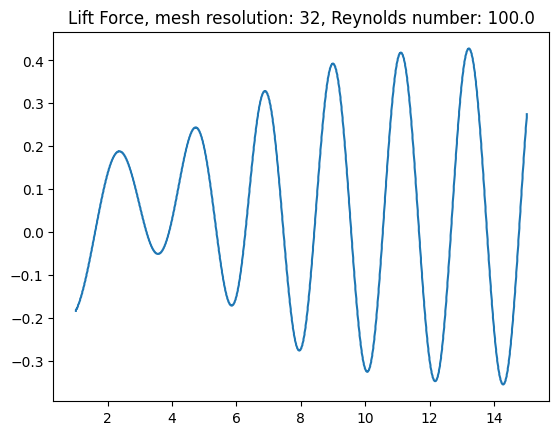

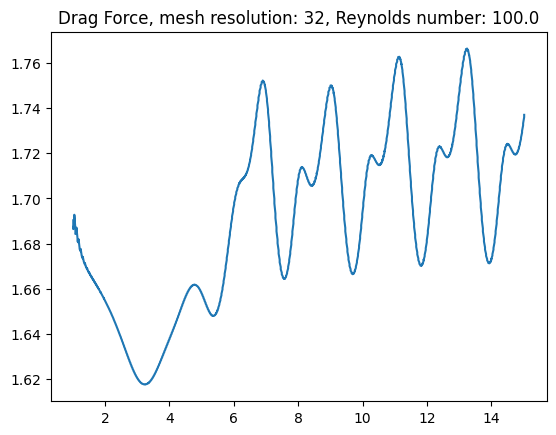

Time t = 18.00457379872328


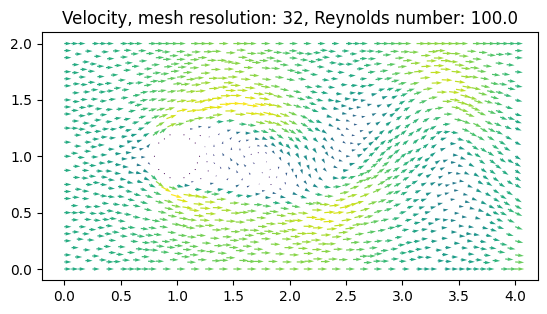

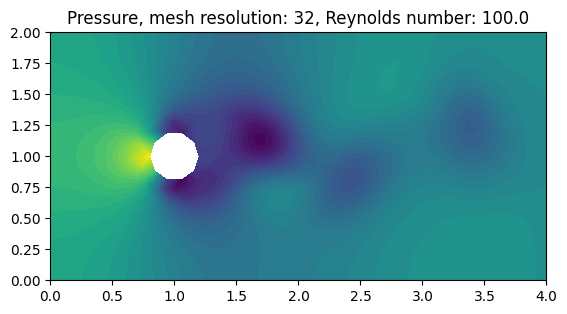

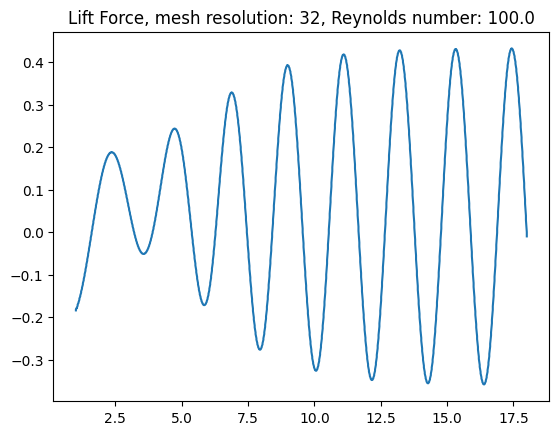

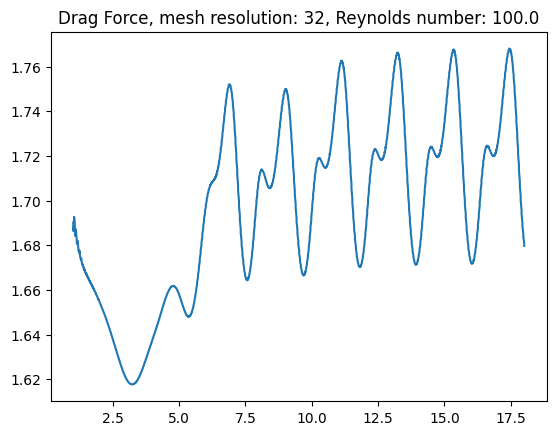

Time t = 21.027239472961604


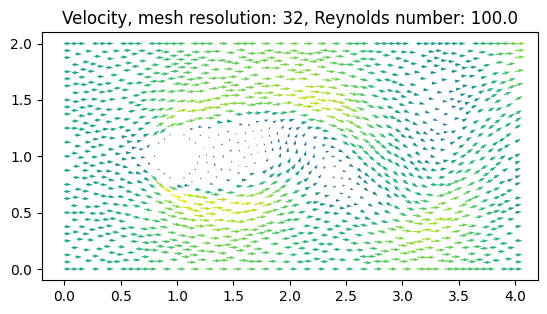

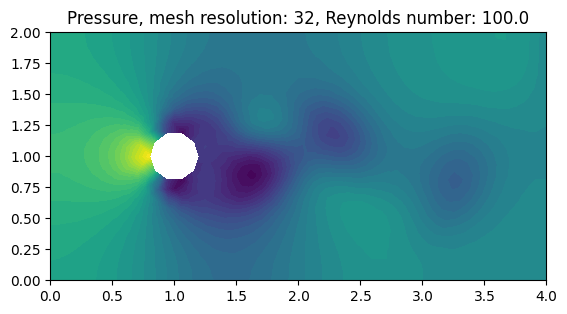

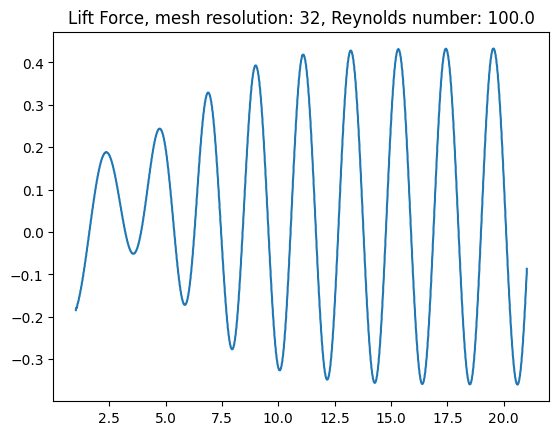

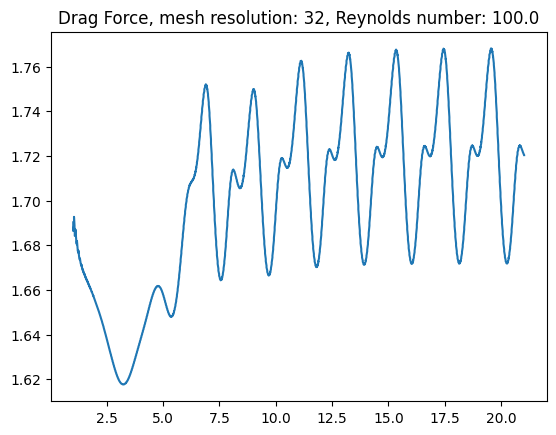

Time t = 24.017050085523426


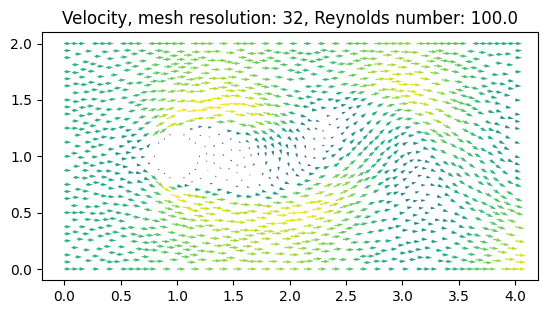

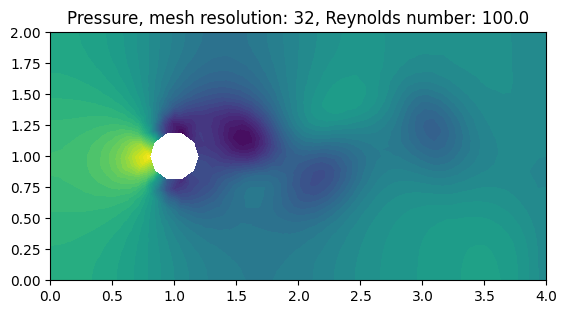

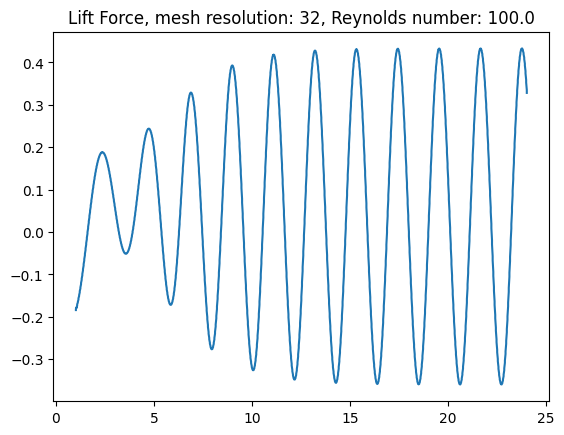

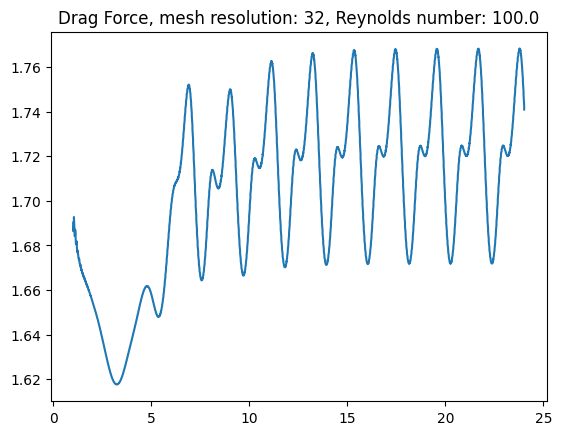

Time t = 27.006860698085248


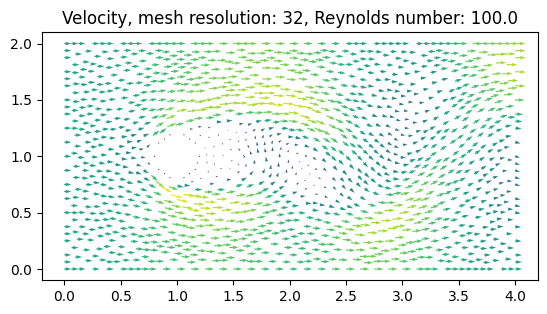

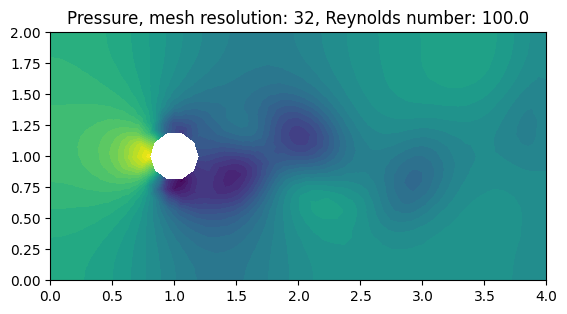

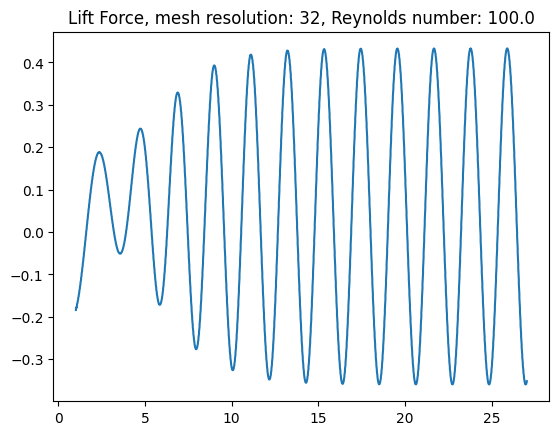

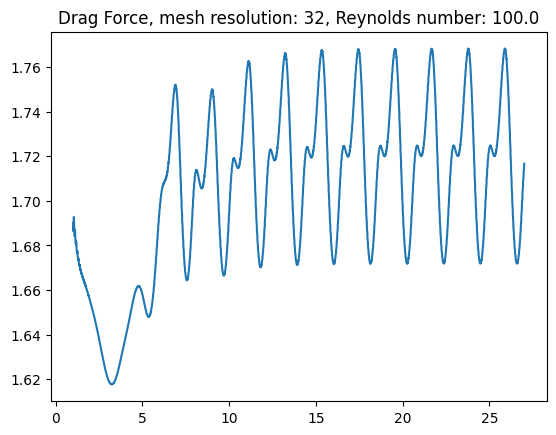

In [ ]:
resolutions = [8, 16, 32]
nu = nus[2]
for res in resolutions:
  computeNS(nu, res, iter_mesh = True, frames = 10)

In [ ]:
print_res([nus[2]], res = resolutions)

Mesh resolution    |        8 |       16 |       32 
----------------------------------------------------
Average lift force | -0.05889 | -0.00829 |  0.01893 
Lift coefficient   | -0.29445 | -0.04144 |  0.09465 
----------------------------------------------------
Average drag force |  2.98961 |  2.08934 |  1.71864 
Drag coefficient   | 14.94804 | 10.44669 |  8.59318 
----------------------------------------------------
Strouhal number    |  0.76386 |  0.15881 |  0.19023 


In [ ]:
# Benchmark test 2D-2

L = 2.2
D = 0.1
rc = D/2
xc = 0.15 + rc
yc = 0.15 + rc
H = 0.15 + D + 0.16
nu_ = 1e-3
Re = D/nu_
u_m = 1.5
U_bar = 2/3*u_m

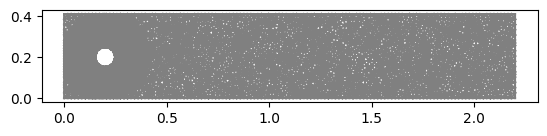

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_5fb9f3fe18c0a6874d054dd59d0e572864a0b64e

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      2
  Arguments:                 '(v_0, v_1)'
  Number of coefficients:    2
  Coefficients:              '[f_584274, f_584277]'
  Unique elements:           'Vector<2 x CG1(?,?)>'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 10
INFO:FFC:  quadrature_degree: 10
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0547915 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:-------------------

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_13058038a7e2bdac096326fa4e890a81843d99f2

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      1
  Arguments:                 '(v_0)'
  Number of coefficients:    3
  Coefficients:              '[f_584274, f_584277, f_584283]'
  Unique elements:           'Vector<2 x CG1(?,?)>, CG1(?,?)'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 10
INFO:FFC:  quadrature_degree: 10
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0558171 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:----

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_3a7e4e4461b25436e9346d93cb3e1f300b1b369f

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      2
  Arguments:                 '(v_0, v_1)'
  Number of coefficients:    1
  Coefficients:              '[f_584277]'
  Unique elements:           'CG1(?,?), Vector<2 x CG1(?,?)>'
  Unique sub elements:       'CG1(?,?), Vector<2 x CG1(?,?)>'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 8
INFO:FFC:  quadrature_degree: 8
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0405016 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:---------------------

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_f66c72570e9891bde2ac7c67d45bb938a552e106

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      1
  Arguments:                 '(v_0)'
  Number of coefficients:    2
  Coefficients:              '[f_584274, f_584277]'
  Unique elements:           'CG1(?,?), Vector<2 x CG1(?,?)>'
  Unique sub elements:       'CG1(?,?), Vector<2 x CG1(?,?)>'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 9
INFO:FFC:  quadrature_degree: 9
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0463192 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC:----------------

Calling FFC just-in-time (JIT) compiler, this may take some time.


Level 25:FFC:Calling FFC just-in-time (JIT) compiler, this may take some time.
INFO:FFC:Compiling form ffc_form_808e8ca065aaeb9375c8465380201b12b04af265

INFO:FFC:Compiler stage 1: Analyzing form(s)
INFO:FFC:-----------------------------------
DEBUG:FFC:  Preprocessing form using 'uflacs' representation family.
INFO:FFC:  
INFO:FFC:  Geometric dimension:       2
  Number of cell subdomains: 0
  Rank:                      0
  Arguments:                 '()'
  Number of coefficients:    4
  Coefficients:              '[f_584274, f_584277, f_584283, f_584287]'
  Unique elements:           'Vector<2 x CG1(?,?)>, CG1(?,?)'
  Unique sub elements:       'Vector<2 x CG1(?,?)>, CG1(?,?)'
  
INFO:FFC:  representation:    auto --> uflacs
INFO:FFC:  quadrature_rule:   auto --> default
INFO:FFC:  quadrature_degree: auto --> 2
INFO:FFC:  quadrature_degree: 2
INFO:FFC:  
INFO:FFC:Compiler stage 1 finished in 0.0496936 seconds.

INFO:FFC:Compiler stage 2: Computing intermediate representation
INFO:FFC

Time t = 0.002079422923739866


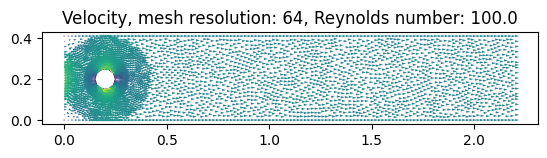

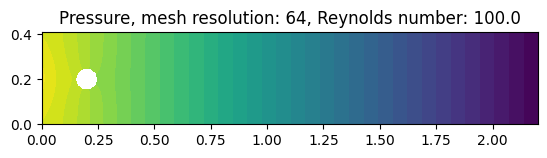

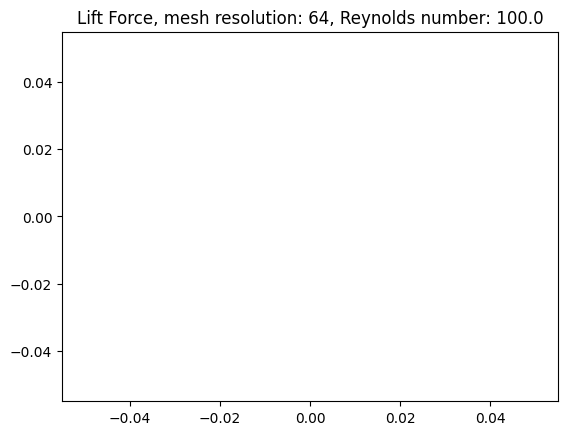

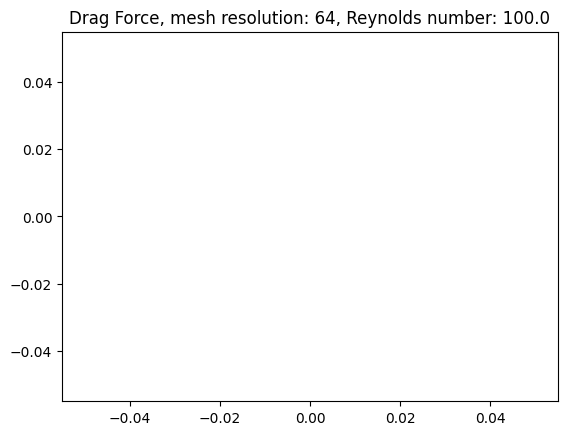

Time t = 0.5011409246213064


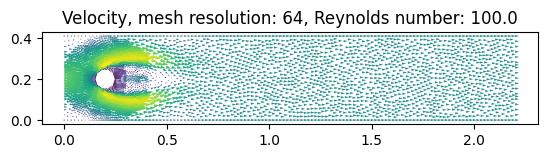

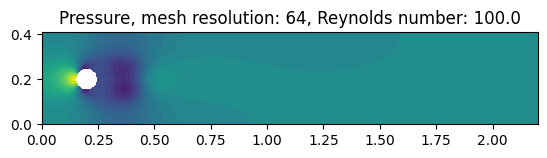

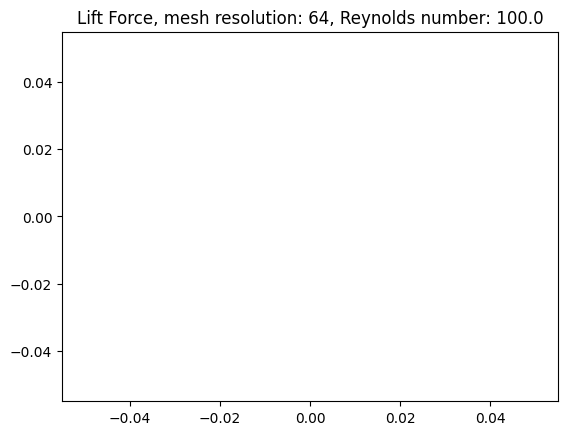

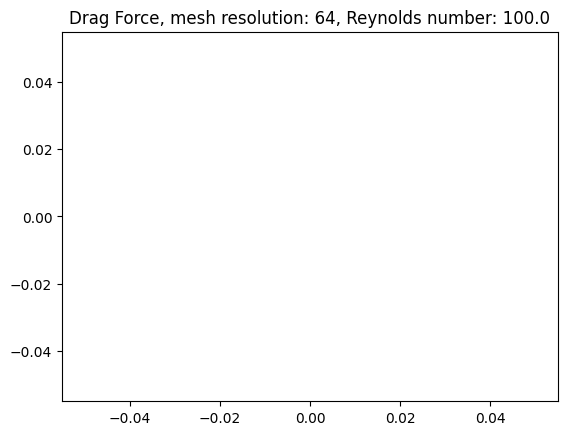

Time t = 1.000202426318873


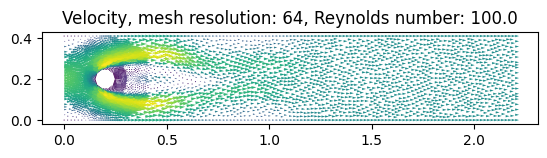

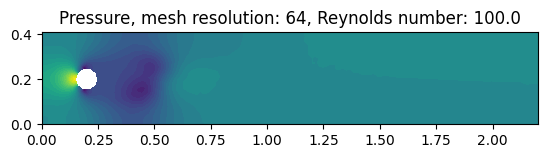

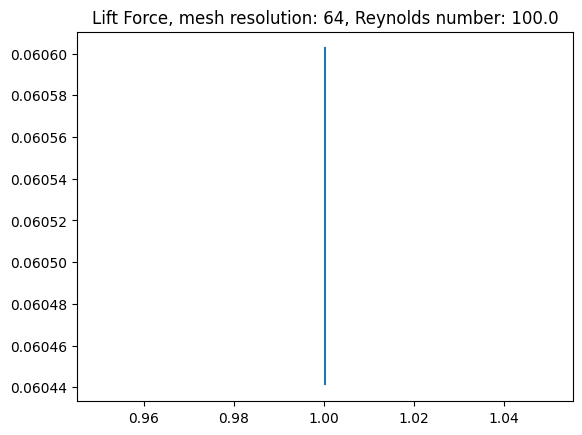

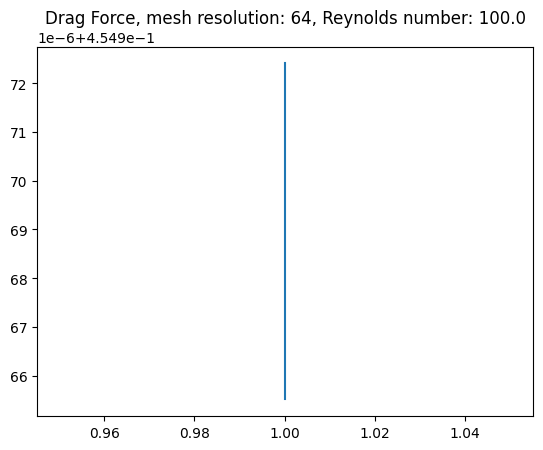

Time t = 1.5013433509402059


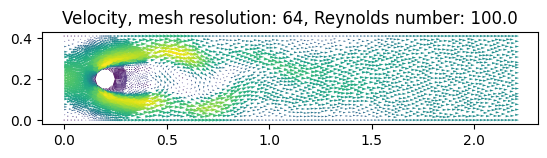

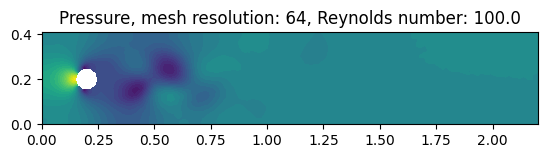

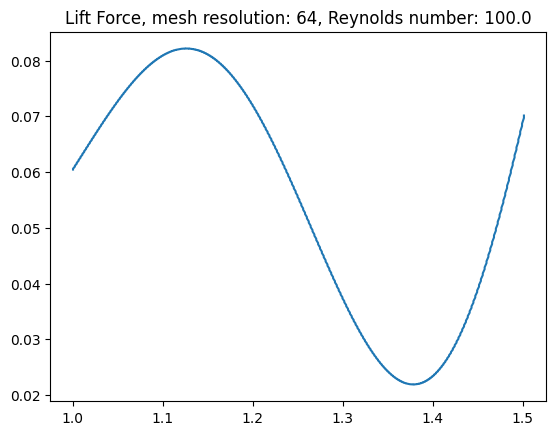

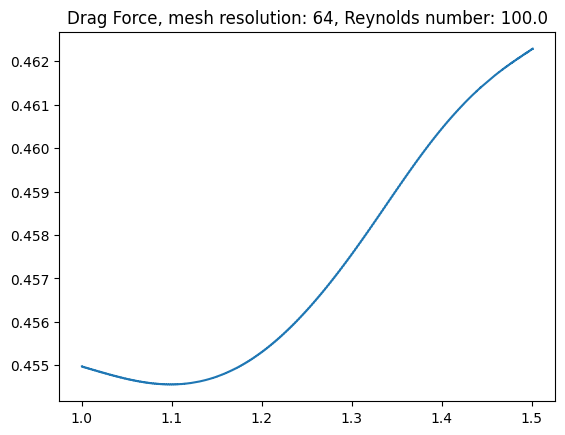

Time t = 2.0004048526377987


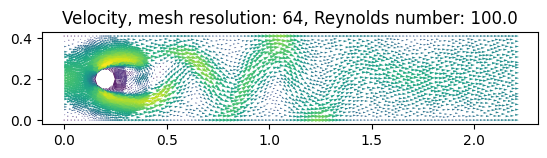

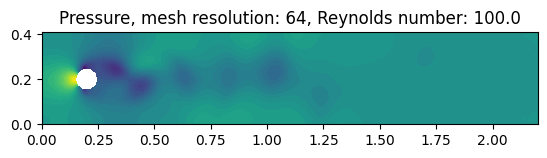

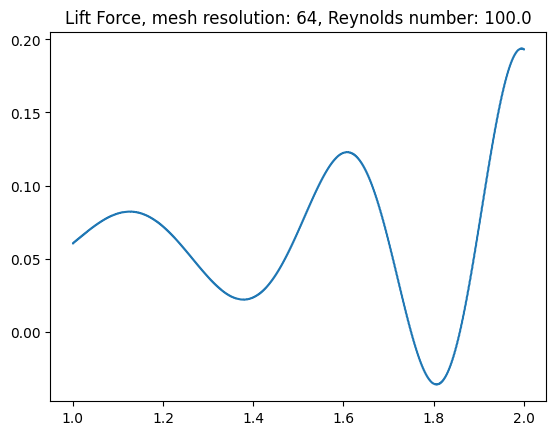

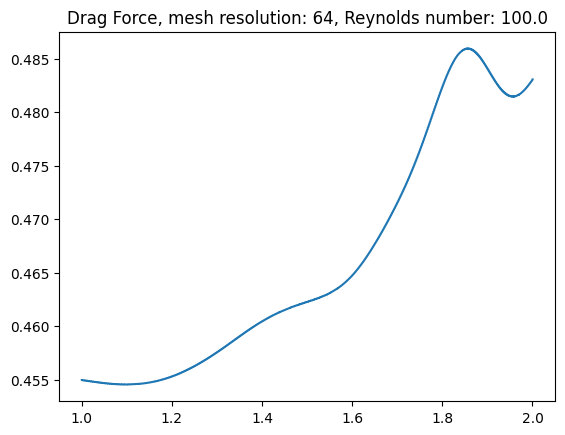

Time t = 2.501545777259078


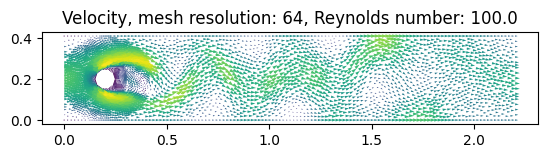

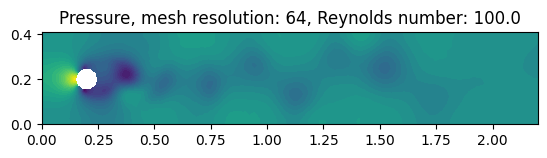

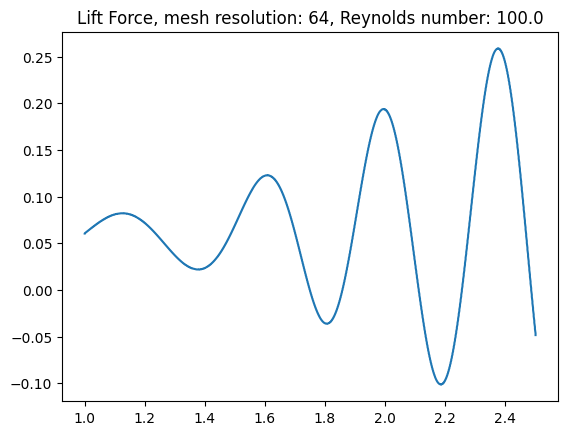

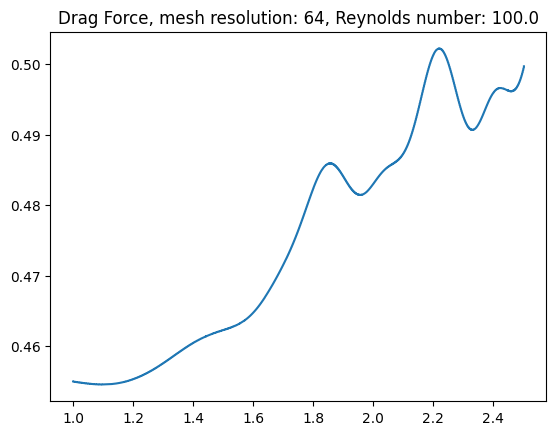

Time t = 3.000607278956618


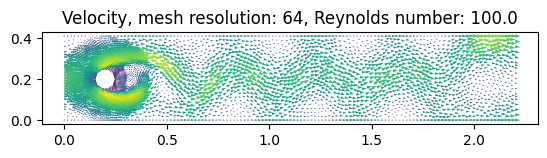

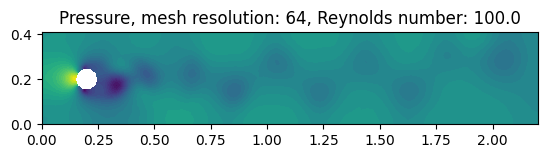

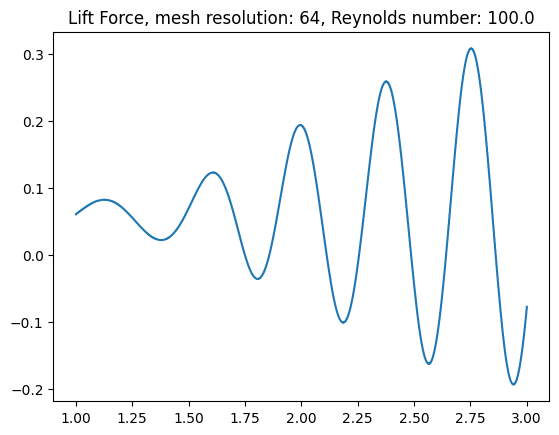

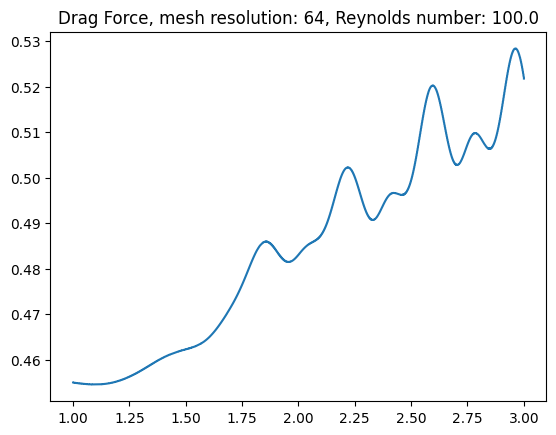

Time t = 3.5017482035778973


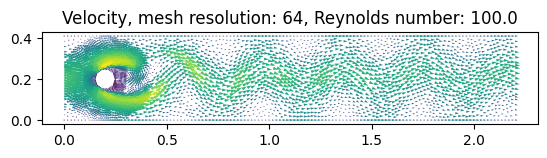

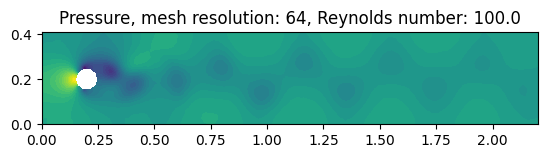

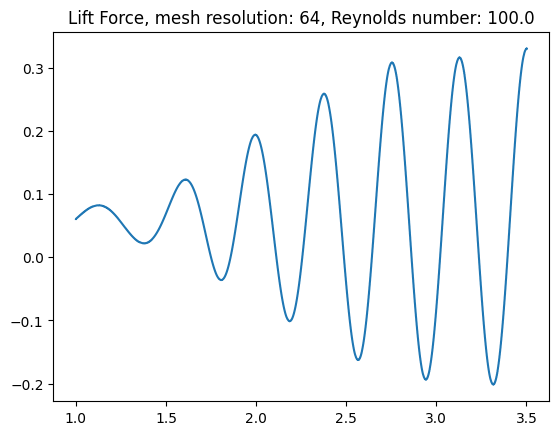

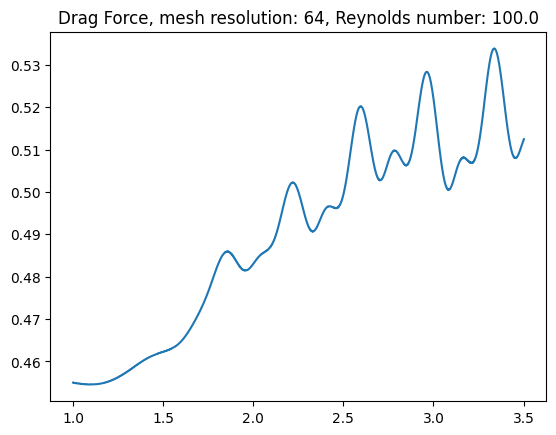

Time t = 4.0008097052754374


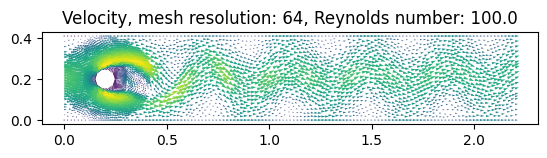

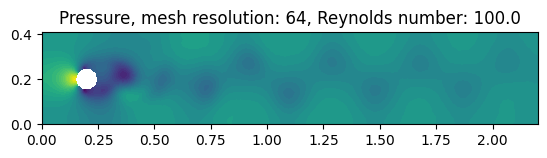

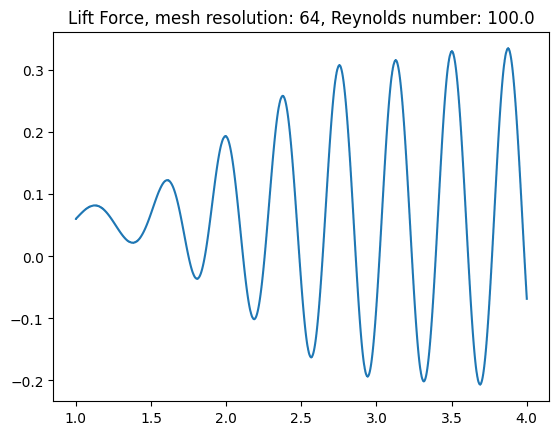

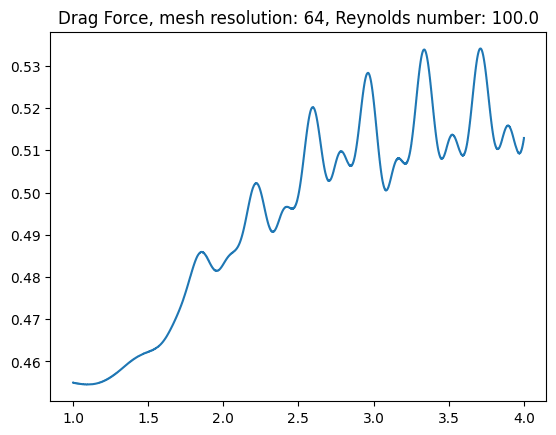

Time t = 4.501950629896717


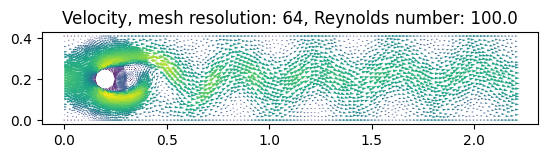

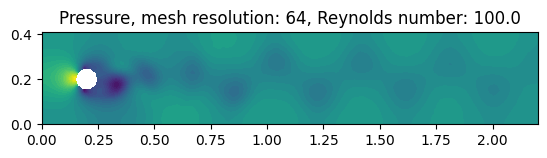

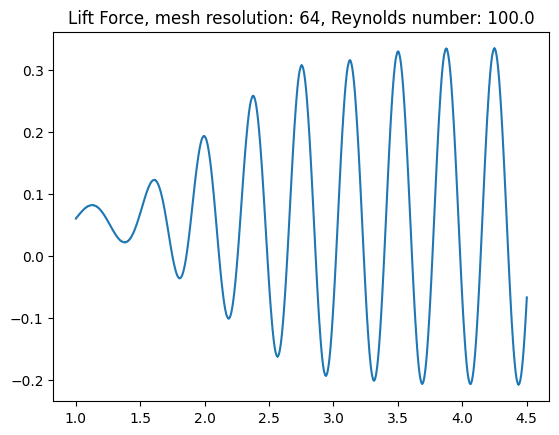

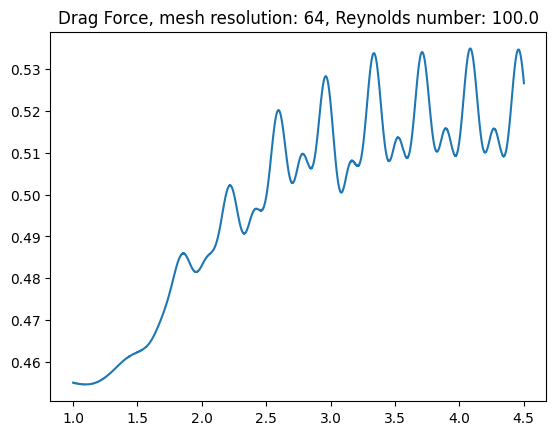

In [ ]:
computeNS(nu_, 64, L, H, xc, yc, rc, u_m, T=5, no_levels=2)

In [ ]:
print('The benchmark test:')
print_res([nu_], D, U=U_bar, start=4)

The benchmark test:
Reynolds number    |    100.0 
------------------------------
Average lift force |  0.04920 
Lift coefficient   |  0.98403 
------------------------------
Average drag force |  0.51904 
Drag coefficient   | 10.38085 
------------------------------
Strouhal number    |  0.26717 


# **Discussion**

A stabilized finite element method was implemented in FEniCS to solve the Navier-Stokes equations in 2D. The method was tested for the model problem of flow past a circular obstacle, and for a high enough Reynolds number and sufficient mesh resolution [a von Karman vortex street developed as expected.](https://en.wikipedia.org/wiki/Kármán_vortex_street)

1. Computing flow for different Reynolds numbers

We compute the flow in the channel for 4 different viscosities, each corresponding to Reynolds number: 1, 10, 100, 1000.
We see that for Reynolds numbers, 1 and 10 the flow is stable, however for 100 and 1000 the flow is unstable. And for the initial file the Reynolds number is $Re = 2r_cU/\nu = 0.2 \cdot 2/0.004=100$.

2. Computing drag and lift coefficients along with Strouhal

We compute the average lift and drag forces. We do that for an interval where the oscillations have become consistent. (Not sure that is the correct way especially considering [Benchmark report](http://www.mathematik.tu-dortmund.de/lsiii/cms/papers/SchaeferTurek1996.pdf)). We get the following lift and drag coefficients, and Strouhal numbers:

```
Reynolds number    |      1.0 |     10.0 |    100.0 |   1000.0 
---------------------------------------------------------------
Average lift force |  0.03784 |  0.05264 |  0.01893 |  0.02506 
Lift coefficient   |  0.18922 |  0.26320 |  0.09465 |  0.12530 
---------------------------------------------------------------
Average drag force | 17.71587 |  3.60582 |  1.71864 |  1.56375 
Drag coefficient   | 88.57936 | 18.02909 |  8.59318 |  7.81876 
---------------------------------------------------------------
Strouhal number    |          |          |  0.19023 |  0.21359 


```

We see that the drag force decreases when the Reynolds number increases. And the lift force increases, decreases and then increases again. 

We also see that the Strouhal number for the channel is, 0.19 for the simulation of $Re = 100$ and 0.21 for $Re = 1000$. Which is approximately 0.2 like we were supposed to verify.

3. Mesh resolution 

We see that for resolution 8, the solutions is stable which we know it is not because of our more precise solution before. Thus the Strouhal number that we compute has no meaning.

We also see that the lift and drag coefficients seem to converge with a factor of about 2 when the resolution is doubled.

For resolution 16 it is approximately $0.16$ while it was $0.19$ for the finest resoultion.

```
Mesh resolution    |        8 |       16 |       32 
----------------------------------------------------
Average lift force | -0.05889 | -0.00829 |  0.01893 
Lift coefficient   | -0.29445 | -0.04144 |  0.09465 
----------------------------------------------------
Average drag force |  2.98961 |  2.08934 |  1.71864 
Drag coefficient   | 14.94804 | 10.44669 |  8.59318 
----------------------------------------------------
Strouhal number    |  0.76386 |  0.15881 |  0.19023 

```

2. (extra) Benchmark

We tried to simulate the flow like in 2D-2 (unstable) in the report [Benchmark report](http://www.mathematik.tu-dortmund.de/lsiii/cms/papers/SchaeferTurek1996.pdf). 

We computed the flow around the benchmark problem with resolution 64, smaller resolution was very coarse due to height to length ratio. And we also made the mesh finer around the circle. 
```
The benchmark test:
Reynolds number    |    100.0 
------------------------------
Average lift force |  0.04920 
Lift coefficient   |  0.98403 
------------------------------
Average drag force |  0.51904 
Drag coefficient   | 10.38085 
------------------------------
Strouhal number    |  0.26717 
```

We get the Strouhal number $0.267$ while the correct is about $\approx 0.29$. Our average lift coefficient was 0.98 but in the report the calculated _max_ lift coefficient was around 1.00. And our average drag coefficient was 3x higher than their _max_ drag coefficient. Our max coefficients would be much higher than the coefficients in the report.

Would have to use a better mesh, maybe with an adaptive mesh refinement.

3. (extra) Paraview

We put the .pvd file along with .vtu files of the fluid simulation of the original channel, with a resolution of 1/32 and Reynolds number 100, into Paraview. We used 100 frames for the 30 second duration of the flow. The results can be found [here](https://drive.google.com/file/d/1CUP9tDzc6IvhGAlCYf5meXzzwAzRrKxA/view?usp=share_link).